In [2]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import numpy as np
import scFunctions as sf
import pickle

sc.settings.verbosity = 3

###### FAIRE FILTER RANK GENE GROUP POUR MARKERS
###### CHANGER EGALEMENT ENTRE HEALTHY ET PRENEO PEUT ETRE QU ON TROUVERA DES TRUCS
###### CHANGER  EN LOG10 DANS LES PATHWAYS
%config Completer.use_jedi = False
pd.set_option('display.max_columns', 50)

In [3]:
with open("../data/adata_new_orig.pickle", "rb") as f:
    adata = pickle.load(f)

In [4]:
adata

AnnData object with n_obs × n_vars = 119630 × 2922
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Experiment_ID', 'Stage', 'New_Cell_ID', 'Population', 'Mouse_ID', 'Week_post Cre_activation', 'Sub_class_Stage', 'Mammary_glands', 'mouse_age_(Week)', 'new_orig'
    var: 'features', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'Stage_colors', 'neighbors', 'umap', 'new_orig_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

# On garde uniquement les DC
[//]: # (-.- .tabset .tabset-pills)

In [5]:
list_DC = ['cDC1', 'cDC2', 'pDC', 'Mature_DC']

adata_DC = adata[adata.obs['Population'].isin(list_DC), :].raw.to_adata().copy()
adata_DC

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(


AnnData object with n_obs × n_vars = 15478 × 25572
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Experiment_ID', 'Stage', 'New_Cell_ID', 'Population', 'Mouse_ID', 'Week_post Cre_activation', 'Sub_class_Stage', 'Mammary_glands', 'mouse_age_(Week)', 'new_orig'
    var: 'features', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'Stage_colors', 'neighbors', 'umap', 'new_orig_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


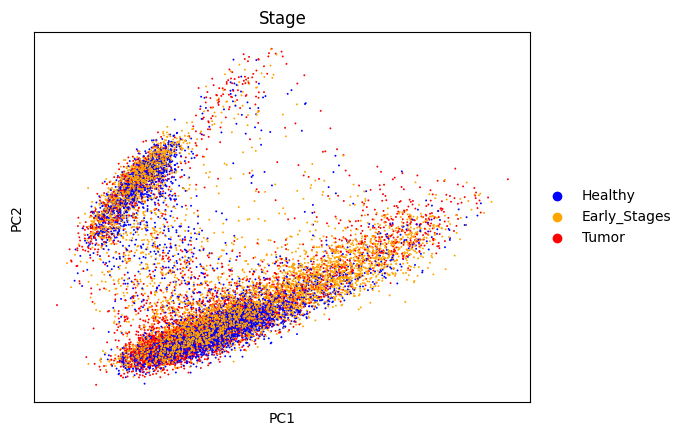

In [6]:
# Normalize, Log-transform, select HVG, scale data and perform PCA
adata_DC = sf.pp_PCA(adata_DC) # Function defined in scFunction.py

sc.pl.pca(adata_DC, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})

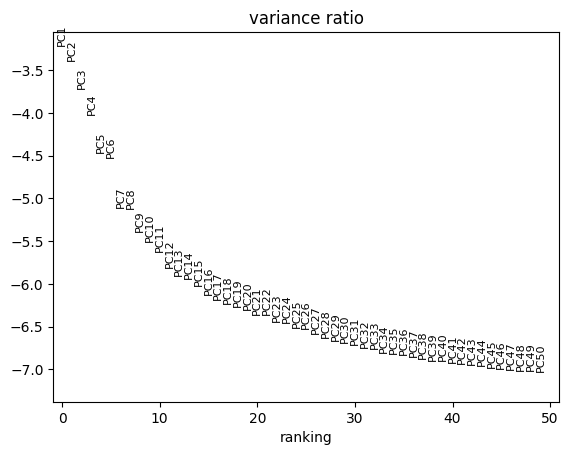

In [7]:
sc.pl.pca_variance_ratio(adata_DC, log=True, n_pcs = 50) #ndim = 20

## Sans harmony

In [8]:
sc.pp.neighbors(adata_DC, n_pcs=20)
sc.tl.umap(adata_DC)

computing neighbors
    using 'X_pca' with n_pcs = 20


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packag

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:25)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


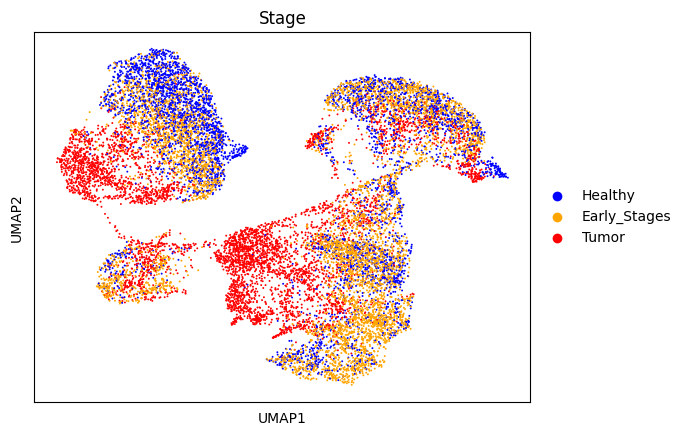

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


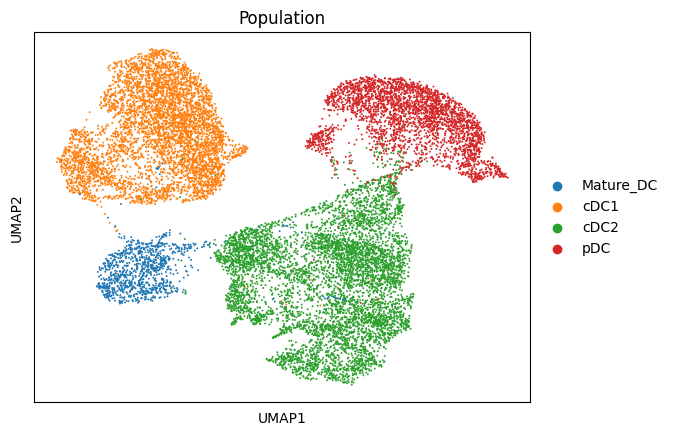

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


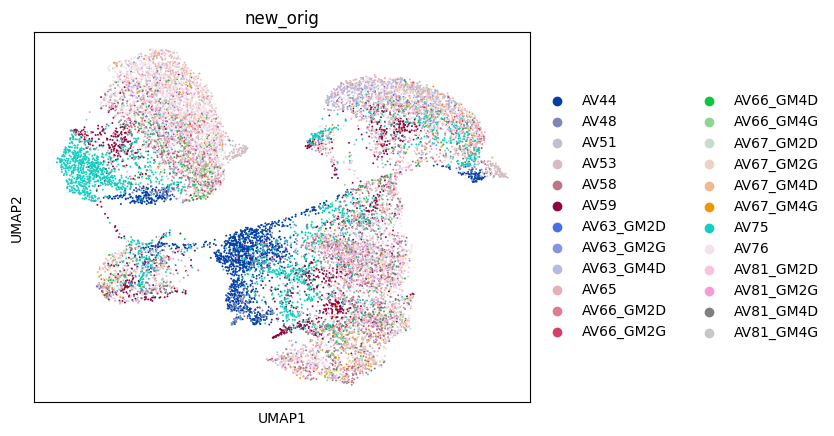

In [9]:
sc.pl.umap(adata_DC, color = 'Stage')
sc.pl.umap(adata_DC, color = 'Population')
sc.pl.umap(adata_DC, color = 'new_orig')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:02)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


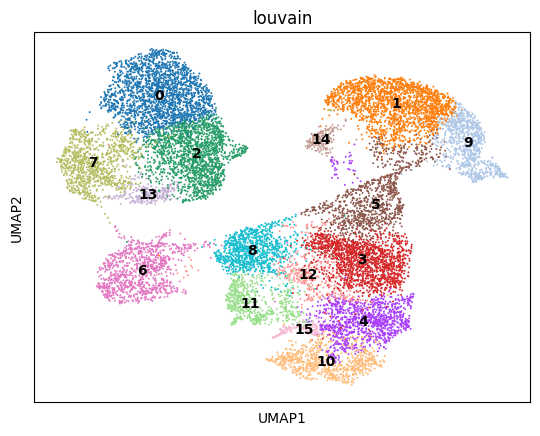

In [10]:
sc.tl.louvain(adata_DC)
sc.pl.umap(adata_DC, color = 'louvain', legend_loc = "on data")

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


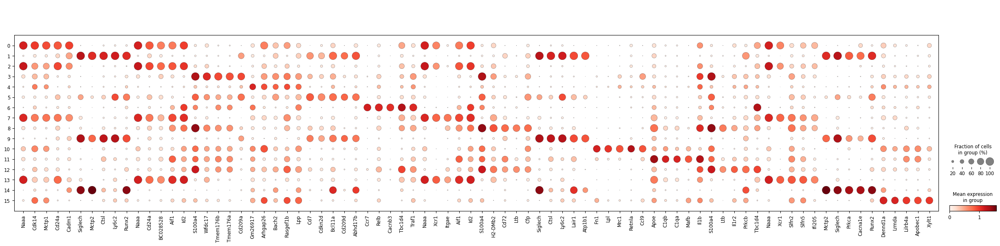

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


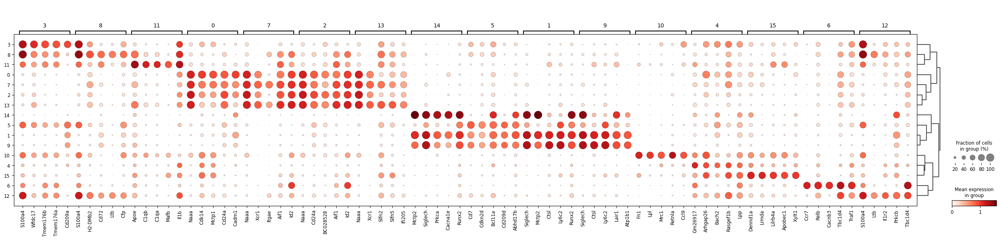

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Stage']`
categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


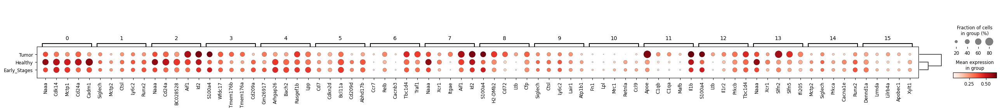

In [11]:
sc.tl.rank_genes_groups(adata_DC, "louvain")
sc.tl.filter_rank_genes_groups(adata_DC, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_percent = 25 and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_DC.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_DC, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_DC, genes, groupby="louvain")
sc.pl.rank_genes_groups_dotplot(adata_DC, key = "rank_genes_groups_filtered", n_genes= 5 )
sc.pl.rank_genes_groups_dotplot(adata_DC, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


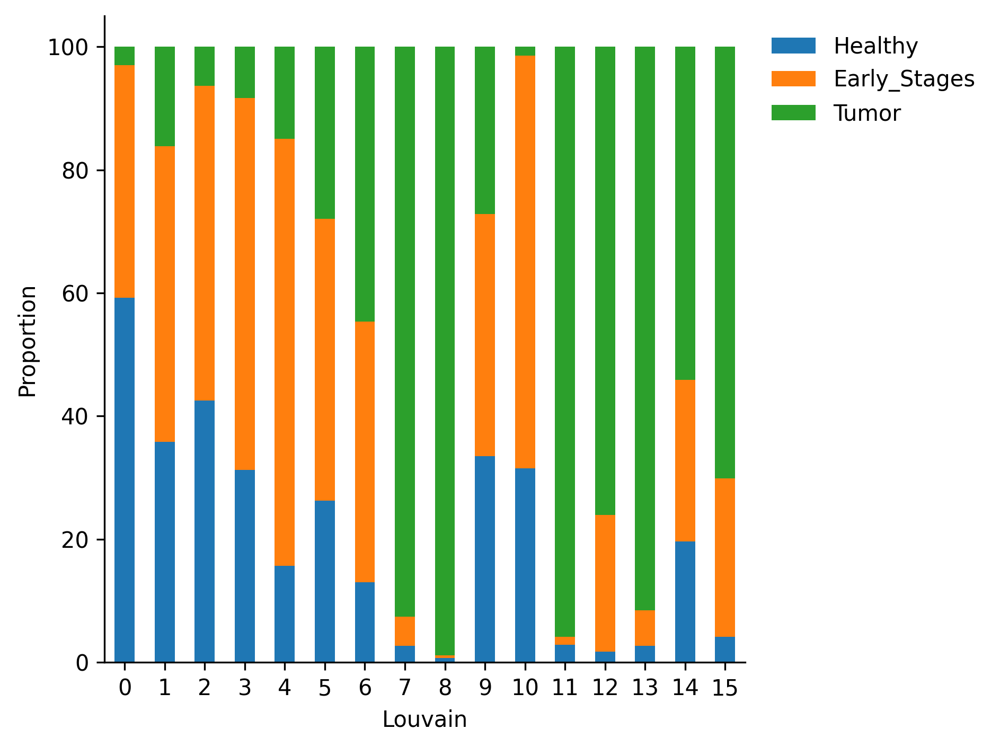

In [12]:
Stage_by_cluster = sf.get_cluster_proportions(adata_DC, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


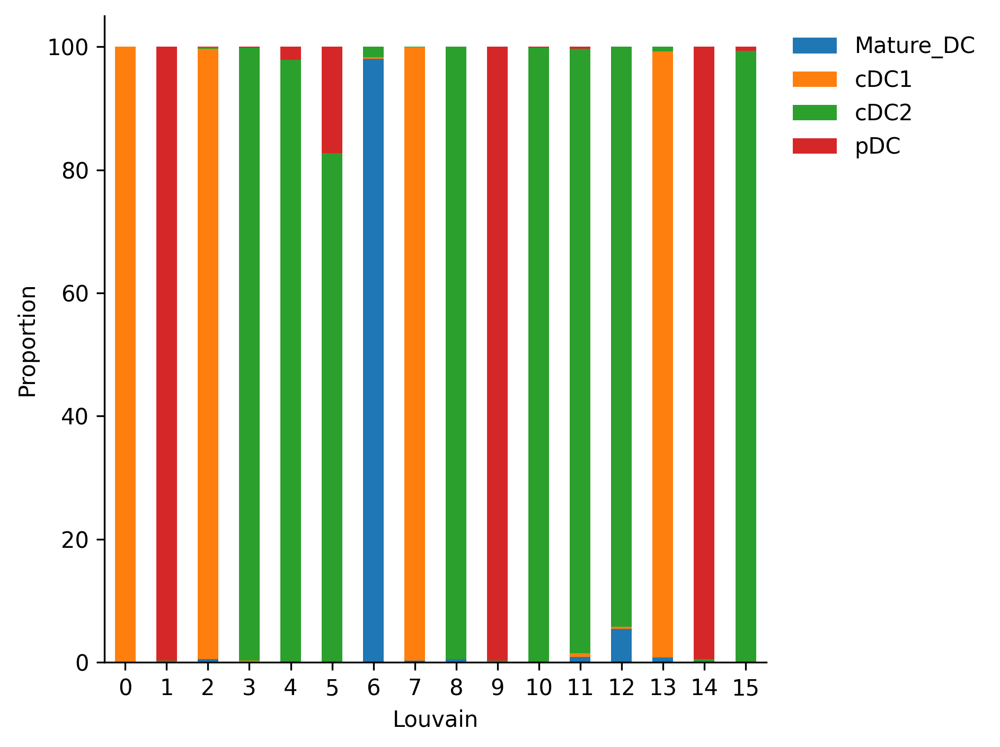

In [13]:
Stage_by_cluster = sf.get_cluster_proportions(adata_DC, cluster_key="Population", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

## Avec integration d'harmony

2024-05-03 15:20:45,787 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-03 15:20:49,697 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-03 15:20:49,771 - harmonypy - INFO - Iteration 1 of 10
2024-05-03 15:20:53,497 - harmonypy - INFO - Iteration 2 of 10
2024-05-03 15:20:57,301 - harmonypy - INFO - Iteration 3 of 10
2024-05-03 15:21:00,943 - harmonypy - INFO - Iteration 4 of 10
2024-05-03 15:21:04,728 - harmonypy - INFO - Iteration 5 of 10
2024-05-03 15:21:08,498 - harmonypy - INFO - Iteration 6 of 10
2024-05-03 15:21:12,332 - harmonypy - INFO - Iteration 7 of 10
2024-05-03 15:21:16,008 - harmonypy - INFO - Iteration 8 of 10
2024-05-03 15:21:19,679 - harmonypy - INFO - Iteration 9 of 10
2024-05-03 15:21:23,463 - harmonypy - INFO - Iteration 10 of 10
2024-05-03 15:21:26,268 - harmonypy - INFO - Stopped before convergence


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


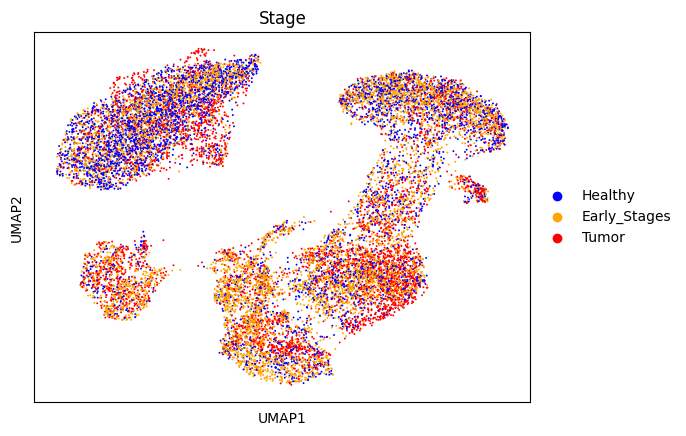

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


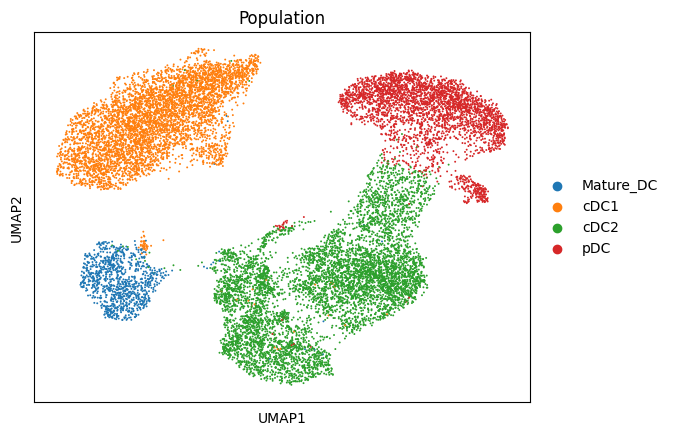

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


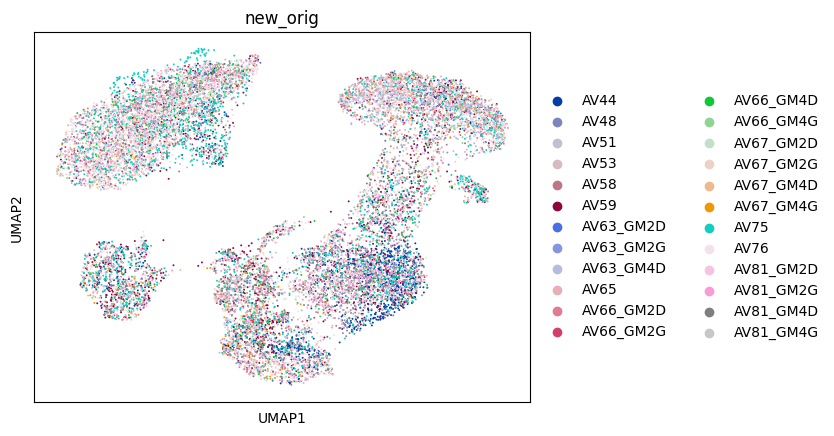

In [14]:
sc.external.pp.harmony_integrate(adata_DC, "orig.ident")
sc.pp.neighbors(adata_DC, n_pcs=20, use_rep='X_pca_harmony')
sc.tl.umap(adata_DC)

sc.pl.umap(adata_DC, color = 'Stage')
sc.pl.umap(adata_DC, color = 'Population')
sc.pl.umap(adata_DC, color = 'new_orig')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:02)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


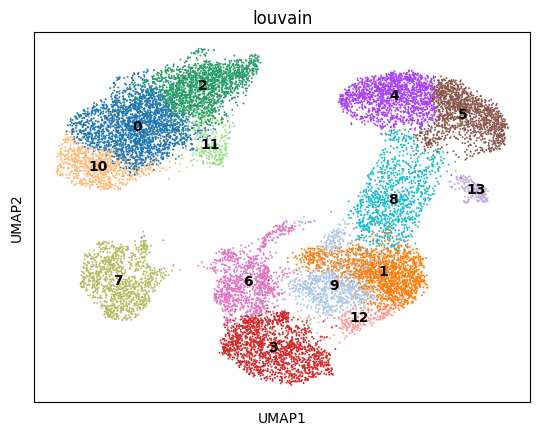

In [15]:
sc.tl.louvain(adata_DC)
sc.pl.umap(adata_DC, color = 'louvain', legend_loc = "on data")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


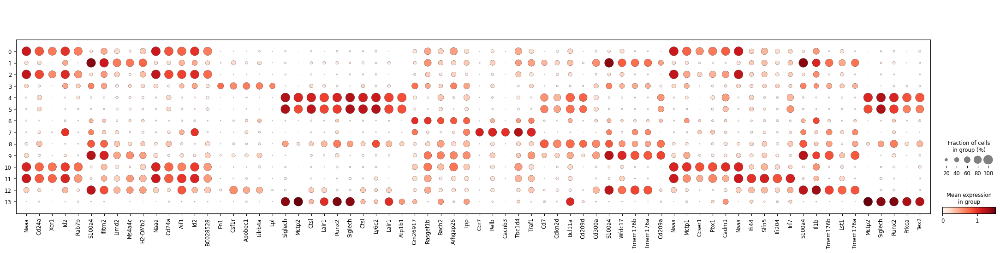

Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


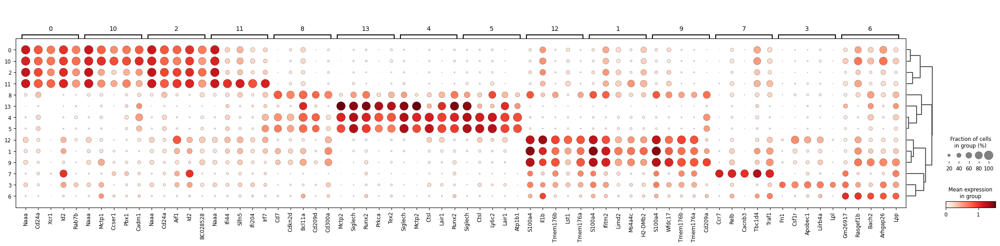

categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


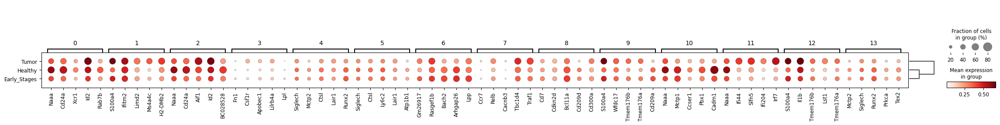

In [16]:
sc.tl.rank_genes_groups(adata_DC, "louvain")
sc.tl.filter_rank_genes_groups(adata_DC, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_in = 25% and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_DC.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_DC, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_DC, genes, groupby="louvain")
sc.tl.dendrogram(adata_DC, use_rep="X_pca_harmony", groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_DC, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_DC, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


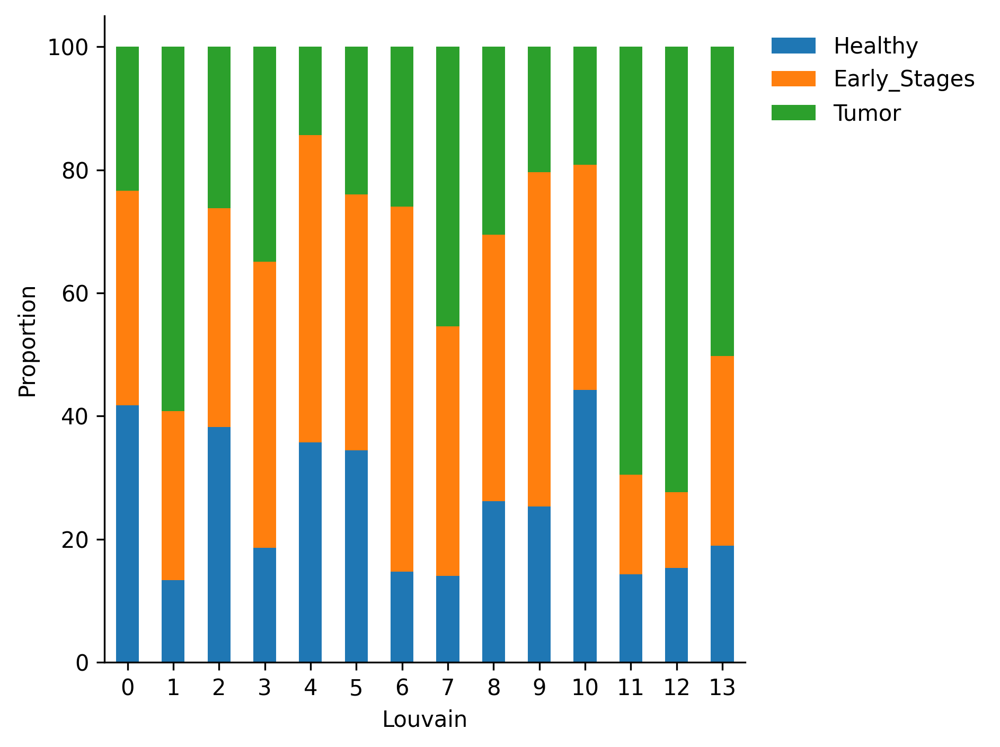

In [17]:
Stage_by_cluster = sf.get_cluster_proportions(adata_DC, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


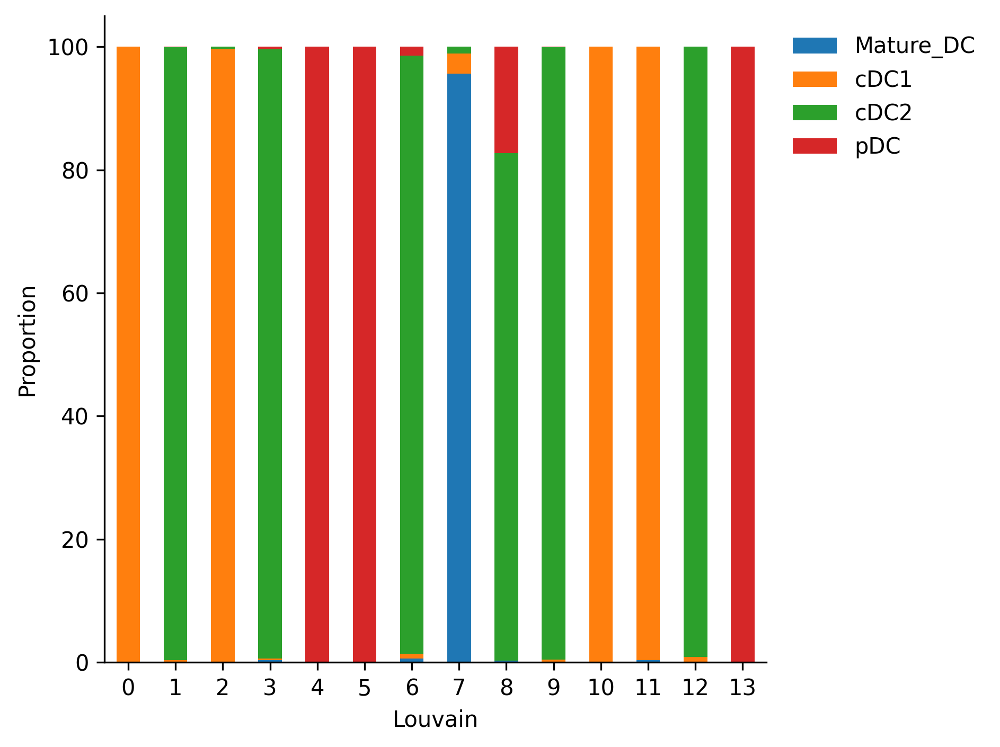

In [18]:
Stage_by_cluster = sf.get_cluster_proportions(adata_DC, cluster_key="Population", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

# cDC1
[//]: # (-.- .tabset .tabset-pills)

In [19]:
adata_cDC1 = adata[adata.obs['Population'].isin(['cDC1']), :].raw.to_adata().copy()
adata_cDC1


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(


AnnData object with n_obs × n_vars = 5008 × 25572
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Experiment_ID', 'Stage', 'New_Cell_ID', 'Population', 'Mouse_ID', 'Week_post Cre_activation', 'Sub_class_Stage', 'Mammary_glands', 'mouse_age_(Week)', 'new_orig'
    var: 'features', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'Stage_colors', 'neighbors', 'umap', 'new_orig_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

normalizing counts per cell
    finished (0:00:00)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


    with n_comps=50
    finished (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


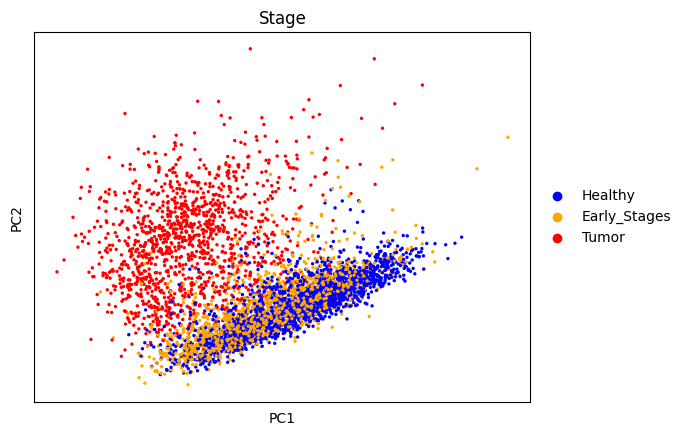

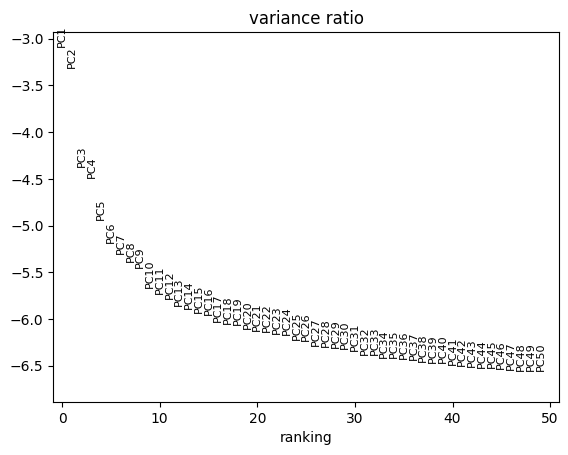

In [20]:
adata_cDC1 = sf.pp_PCA(adata_cDC1) # Function defined in scFunction.py

# Normalize, Log-transform, select HVG, scale data and perform PCA
sc.pl.pca(adata_cDC1, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_cDC1, log=True, n_pcs = 50) #ndim = 20

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


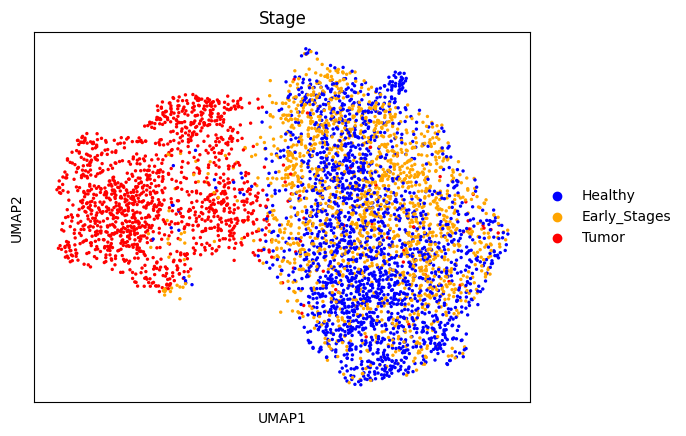

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


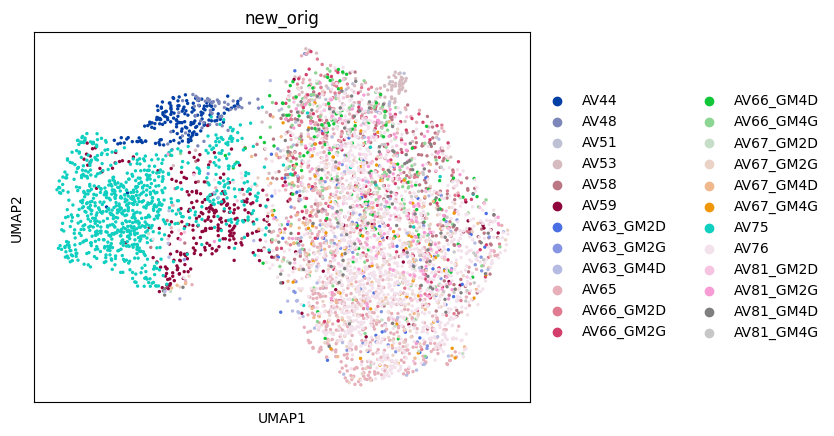

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


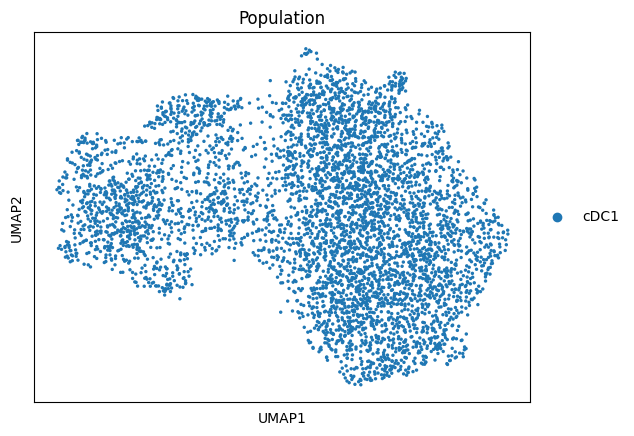

In [21]:
sc.pp.neighbors(adata_cDC1, n_pcs=20)
sc.tl.umap(adata_cDC1)
sc.pl.umap(adata_cDC1, color = 'Stage')
sc.pl.umap(adata_cDC1, color = 'new_orig')
sc.pl.umap(adata_cDC1, color = 'Population')

### Regress cycle

In [22]:
cell_cycle_genes = [x.strip().capitalize() for x in open('../data/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_cDC1.var_names]

sc.tl.score_genes_cell_cycle(adata_cDC1, s_genes=s_genes, g2m_genes=g2m_genes)

sc.pp.regress_out(adata_cDC1, ['S_score', 'G2M_score'])
sc.pp.scale(adata_cDC1)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    472 total control genes are used. (0:00:00)
computing score 'G2M_score'


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'G2M_score', score of gene set (adata.obs).
    729 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)
regressing out ['S_score', 'G2M_score']
    finished (0:00:08)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


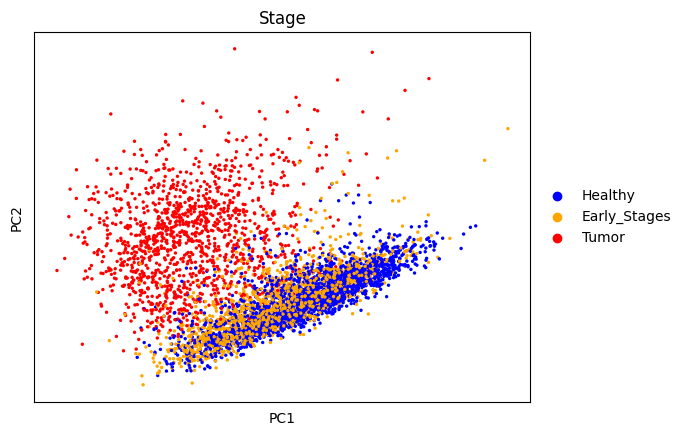

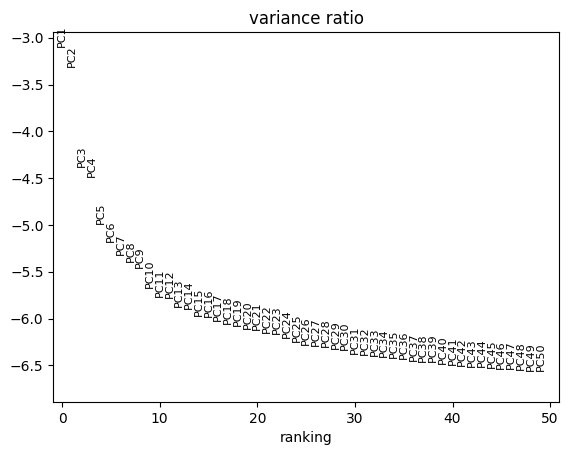

In [23]:
sc.tl.pca(adata_cDC1)
sc.pl.pca(adata_cDC1, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_cDC1, log=True, n_pcs = 50) #ndim = 20

## Sans harmony

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


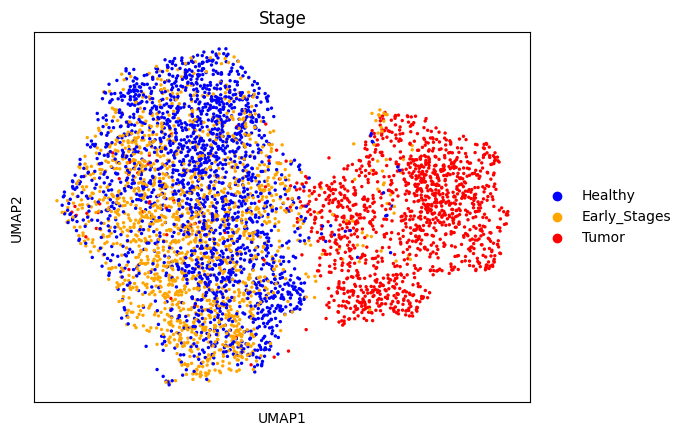

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


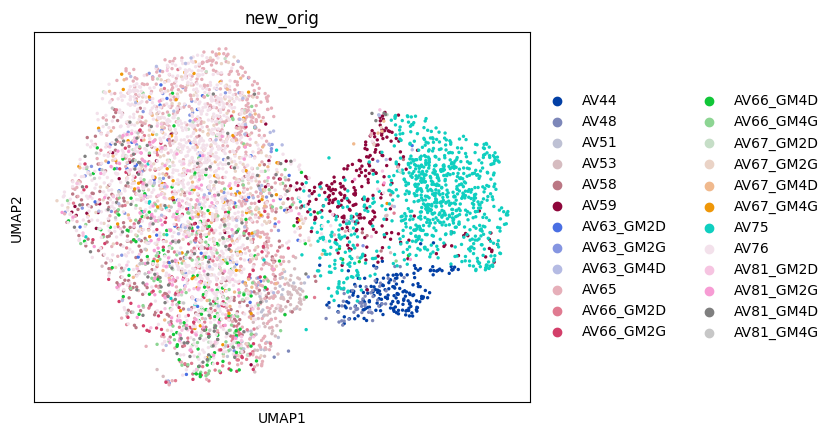

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


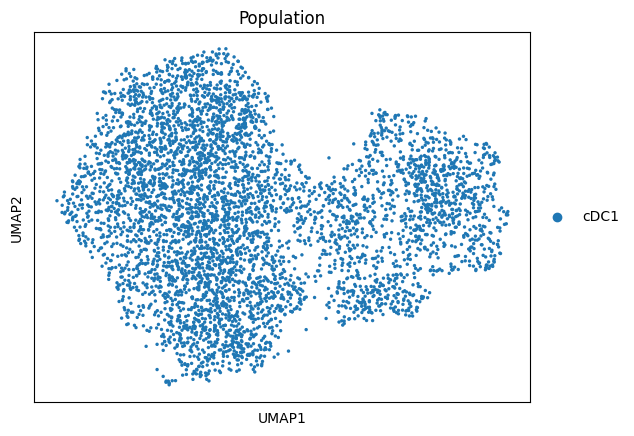

In [24]:
sc.pp.neighbors(adata_cDC1, n_pcs=20)
sc.tl.umap(adata_cDC1)
sc.pl.umap(adata_cDC1, color = 'Stage')
sc.pl.umap(adata_cDC1, color = 'new_orig')
sc.pl.umap(adata_cDC1, color = 'Population')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 10 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


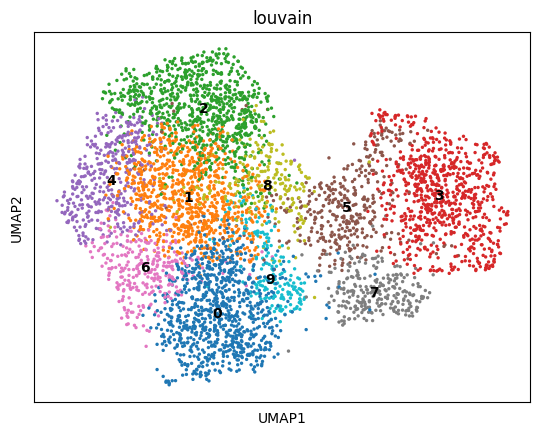

In [25]:
sc.tl.louvain(adata_cDC1, resolution = 0.8)
sc.pl.umap(adata_cDC1, color = 'louvain', legend_loc = 'on data')

computing density on 'umap'
--> added
    'umap_density_Stage', densities (adata.obs)
    'umap_density_Stage_params', parameter (adata.uns)


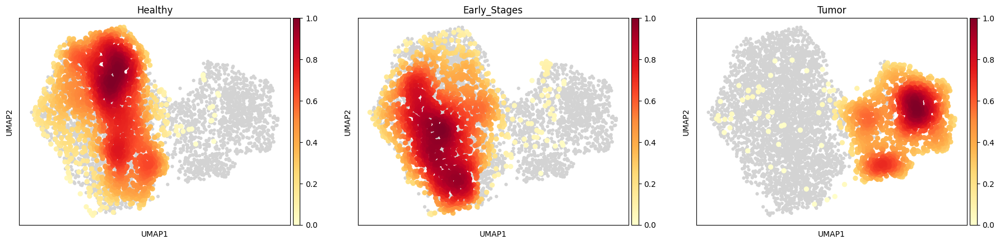

In [26]:
sc.tl.embedding_density(adata_cDC1, groupby="Stage")
sc.pl.embedding_density(adata_cDC1, groupby="Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


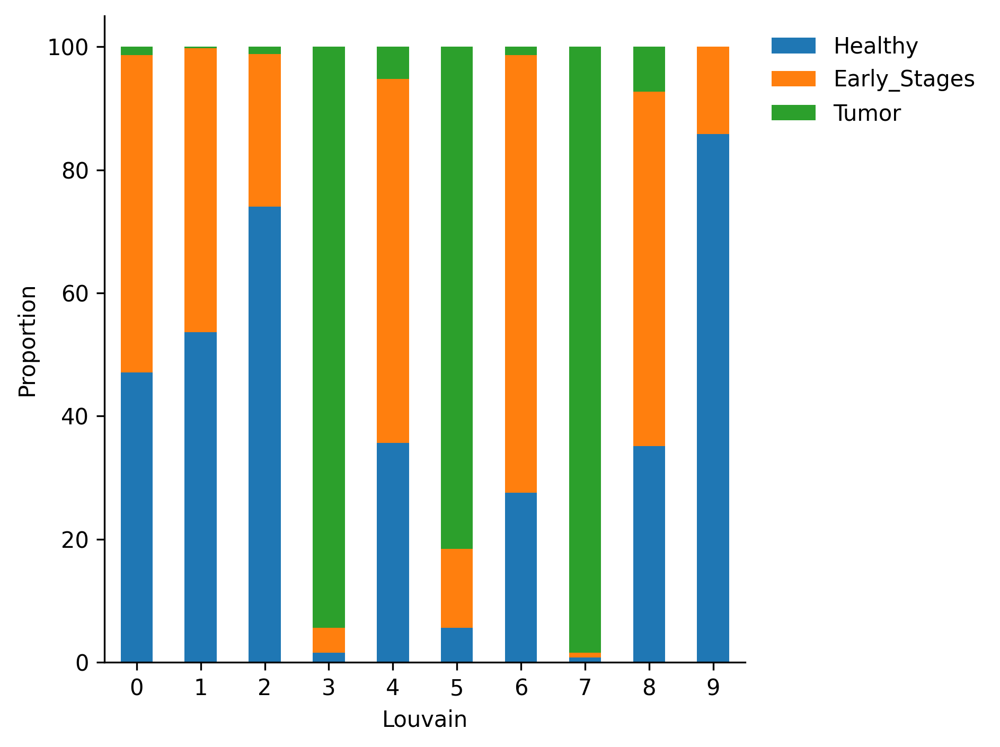

In [27]:
Stage_by_cluster = sf.get_cluster_proportions(adata_cDC1, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


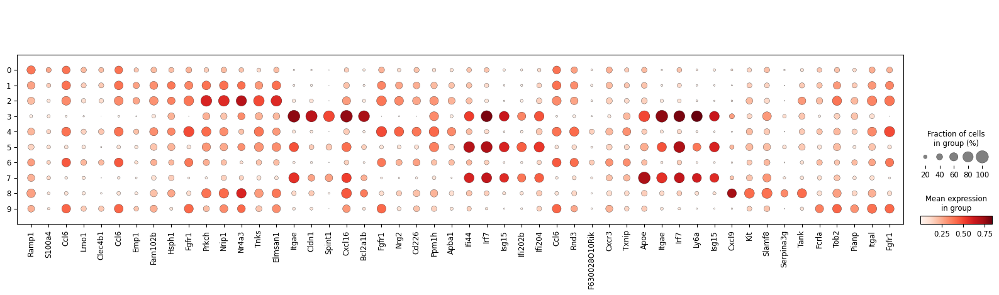

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


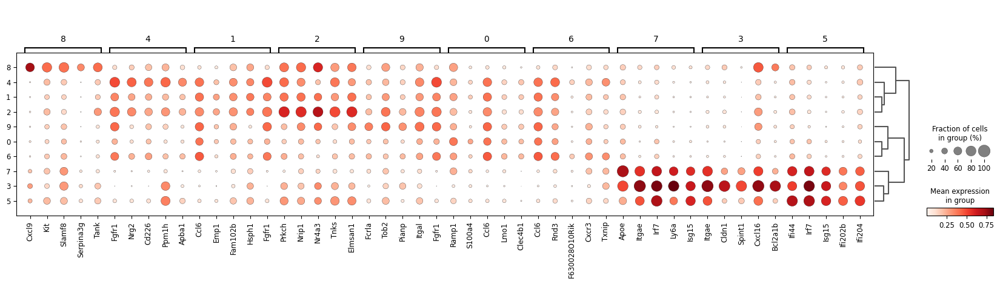

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Stage']`
categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


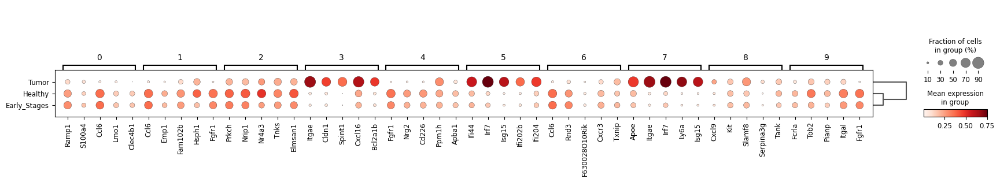

In [28]:
sc.tl.rank_genes_groups(adata_cDC1, "louvain")
sc.tl.filter_rank_genes_groups(adata_cDC1, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_percent = 25 and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_cDC1.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_cDC1, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_cDC1, genes, groupby="louvain")
sc.pl.rank_genes_groups_dotplot(adata_cDC1, key = "rank_genes_groups_filtered", n_genes= 5 )
sc.pl.rank_genes_groups_dotplot(adata_cDC1, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

Marqueurs pas vraiments spécifiques sauf pour les clusters de la tumeur

## Integration avec harmony

2024-05-03 15:22:33,516 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-03 15:22:35,638 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-03 15:22:35,657 - harmonypy - INFO - Iteration 1 of 10
2024-05-03 15:22:36,634 - harmonypy - INFO - Iteration 2 of 10
2024-05-03 15:22:37,529 - harmonypy - INFO - Iteration 3 of 10
2024-05-03 15:22:38,242 - harmonypy - INFO - Iteration 4 of 10
2024-05-03 15:22:38,865 - harmonypy - INFO - Iteration 5 of 10
2024-05-03 15:22:39,483 - harmonypy - INFO - Iteration 6 of 10
2024-05-03 15:22:40,212 - harmonypy - INFO - Iteration 7 of 10
2024-05-03 15:22:40,868 - harmonypy - INFO - Iteration 8 of 10
2024-05-03 15:22:41,357 - harmonypy - INFO - Iteration 9 of 10
2024-05-03 15:22:41,797 - harmonypy - INFO - Iteration 10 of 10
2024-05-03 15:22:42,221 - harmonypy - INFO - Stopped before convergence


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


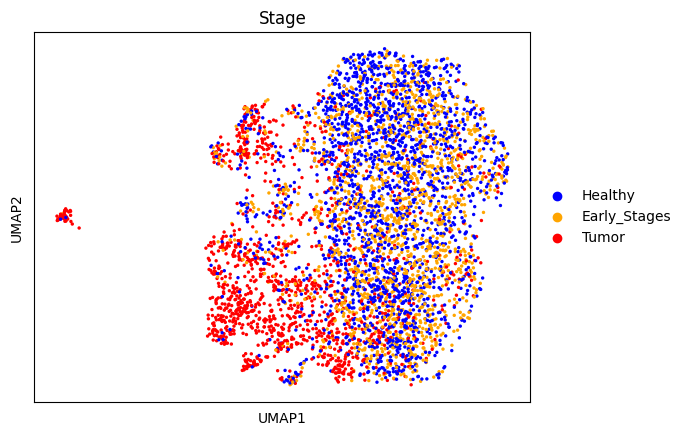

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


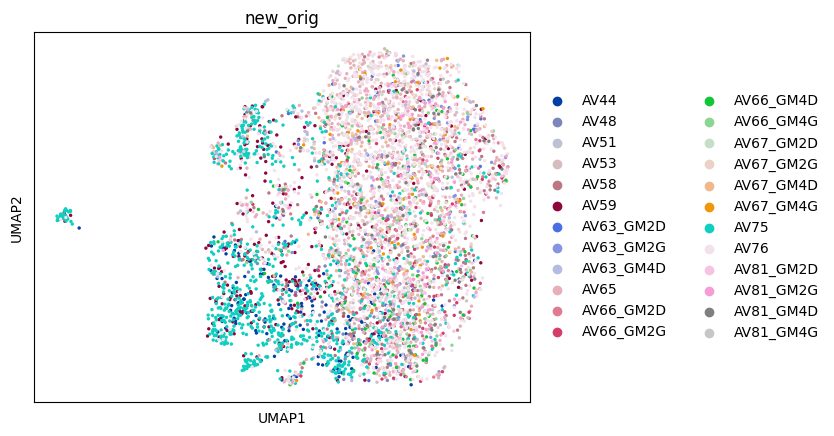

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


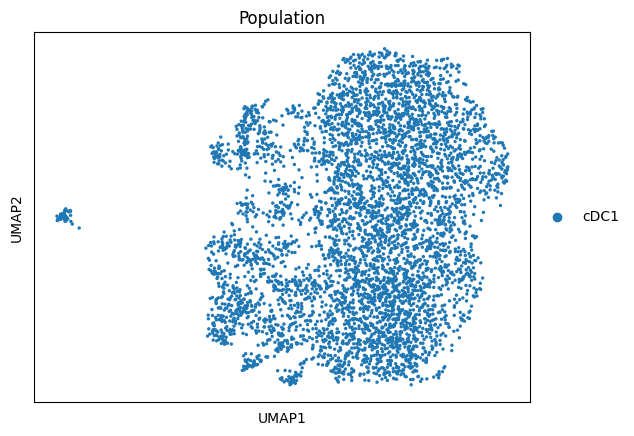

In [29]:
sc.external.pp.harmony_integrate(adata_cDC1, 'orig.ident')

sc.pp.neighbors(adata_cDC1, n_pcs=20, use_rep = "X_pca_harmony")
sc.tl.umap(adata_cDC1)
sc.pl.umap(adata_cDC1, color = 'Stage')
sc.pl.umap(adata_cDC1, color = 'new_orig')
sc.pl.umap(adata_cDC1, color = 'Population')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


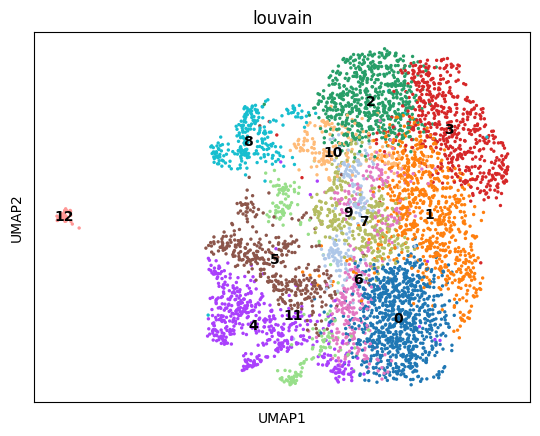

In [30]:
sc.tl.louvain(adata_cDC1)
sc.pl.umap(adata_cDC1, color = 'louvain', legend_loc = 'on data')

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


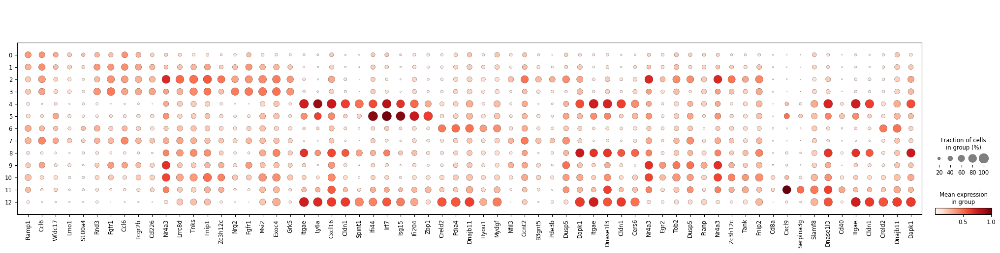

Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


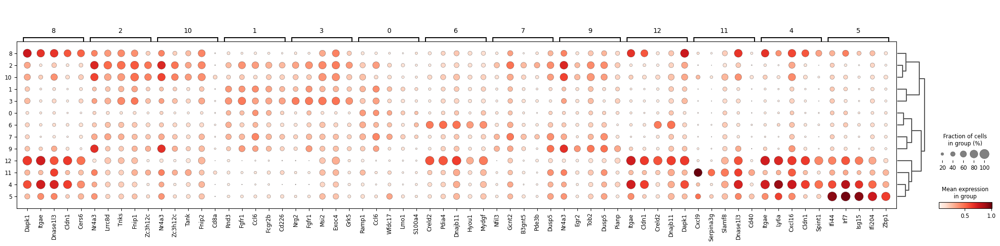

categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


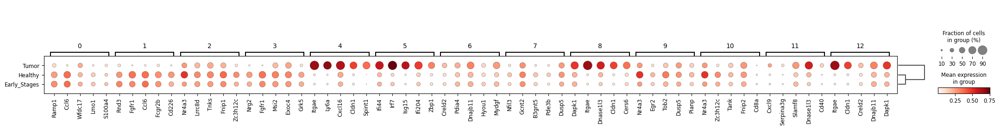

In [31]:
sc.tl.rank_genes_groups(adata_cDC1, "louvain")
sc.tl.filter_rank_genes_groups(adata_cDC1, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_in = 25% and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_cDC1.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_cDC1, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_cDC1, genes, groupby="louvain")
sc.tl.dendrogram(adata_cDC1, use_rep="X_pca_harmony", groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_cDC1, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_cDC1, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


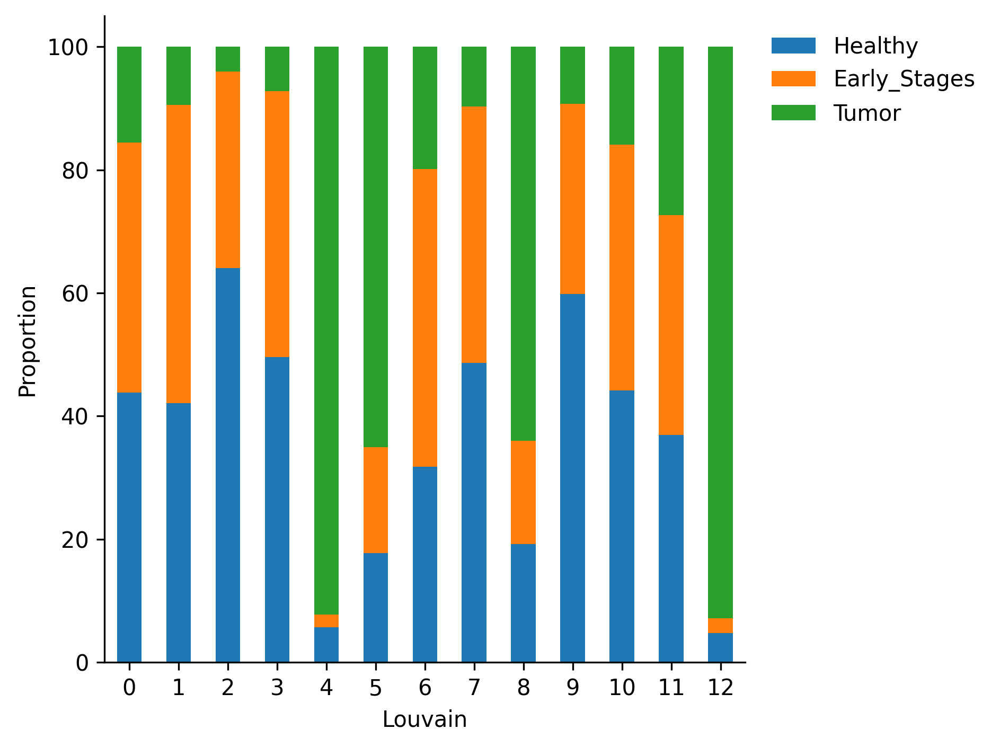

In [32]:
Stage_by_cluster = sf.get_cluster_proportions(adata_cDC1, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

# cDC1 Tumeur uniquement

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


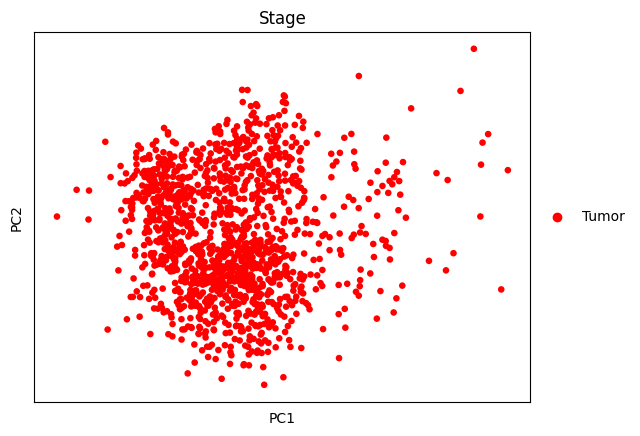

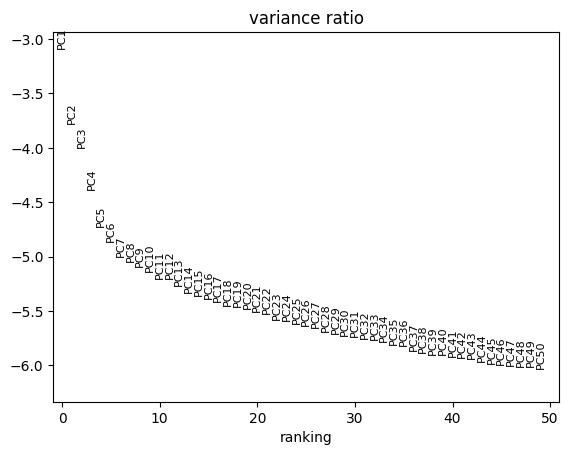

In [33]:
adata_cDC1_T = adata_cDC1[adata_cDC1.obs["Stage"] == "Tumor", :].raw.to_adata().copy()
adata_cDC1_T


adata_cDC1_T = sf.pp_PCA(adata_cDC1_T) # Function defined in scFunction.py

# Normalize, Log-transform, select HVG, scale data and perform PCA
sc.pl.pca(adata_cDC1_T, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_cDC1_T, log=True, n_pcs = 50) #ndim = 10

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


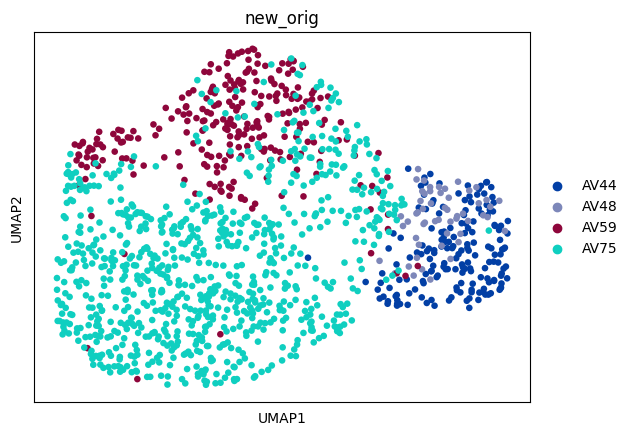

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


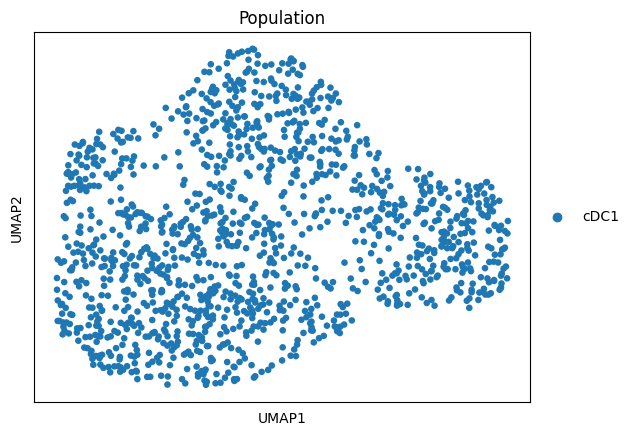

In [34]:
sc.pp.neighbors(adata_cDC1_T, n_pcs=10)
sc.tl.umap(adata_cDC1_T)
sc.pl.umap(adata_cDC1_T, color = 'new_orig')
sc.pl.umap(adata_cDC1_T, color = 'Population')

## Effet batch à corriger

Effet batch trop important, on va harmoniser

## Integration avec harmony

2024-05-03 15:23:04,258 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-03 15:23:04,573 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-03 15:23:04,578 - harmonypy - INFO - Iteration 1 of 10
2024-05-03 15:23:04,757 - harmonypy - INFO - Iteration 2 of 10
2024-05-03 15:23:04,872 - harmonypy - INFO - Iteration 3 of 10
2024-05-03 15:23:04,983 - harmonypy - INFO - Iteration 4 of 10
2024-05-03 15:23:05,089 - harmonypy - INFO - Iteration 5 of 10
2024-05-03 15:23:05,165 - harmonypy - INFO - Iteration 6 of 10
2024-05-03 15:23:05,274 - harmonypy - INFO - Iteration 7 of 10
2024-05-03 15:23:05,343 - harmonypy - INFO - Iteration 8 of 10
2024-05-03 15:23:05,399 - harmonypy - INFO - Iteration 9 of 10
2024-05-03 15:23:05,466 - harmonypy - INFO - Iteration 10 of 10
2024-05-03 15:23:05,545 - harmonypy - INFO - Stopped before convergence


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


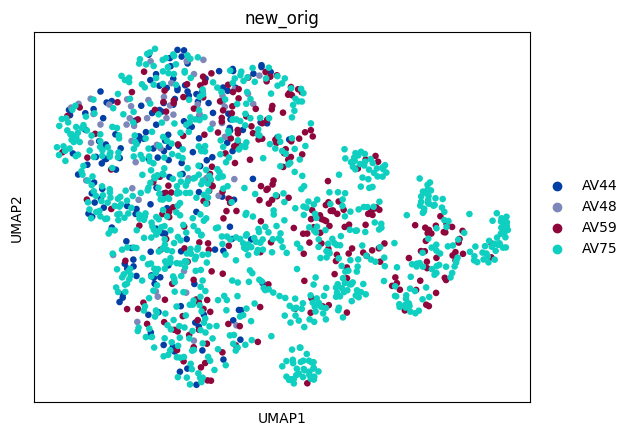

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


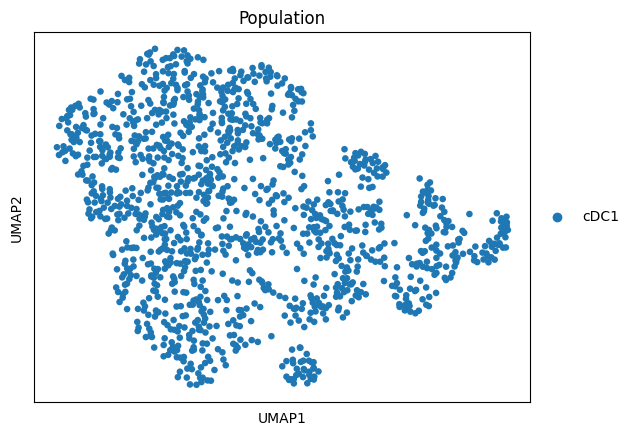

In [35]:
sc.external.pp.harmony_integrate(adata_cDC1_T, "orig.ident")

sc.pp.neighbors(adata_cDC1_T, n_pcs=10, use_rep="X_pca_harmony")
sc.tl.umap(adata_cDC1_T)
sc.pl.umap(adata_cDC1_T, color = 'new_orig')
sc.pl.umap(adata_cDC1_T, color = 'Population')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 6 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


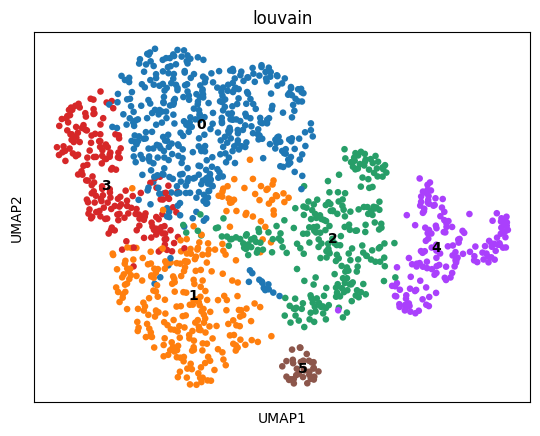

In [36]:
sc.tl.louvain(adata_cDC1_T, resolution = 0.35)
sc.pl.umap(adata_cDC1_T, color = 'louvain', legend_loc = 'on data')

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


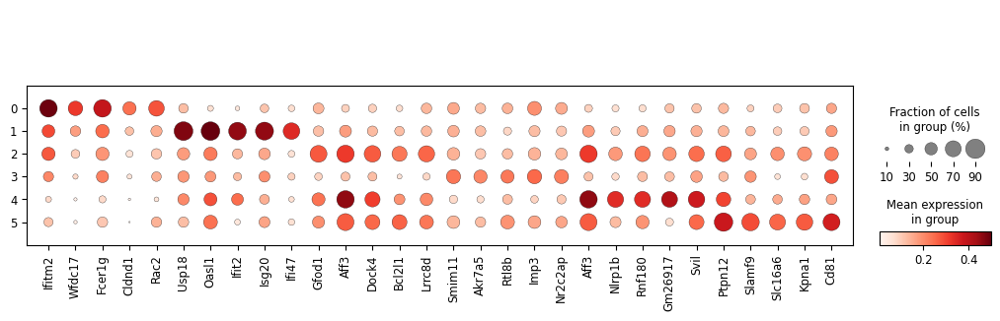

Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


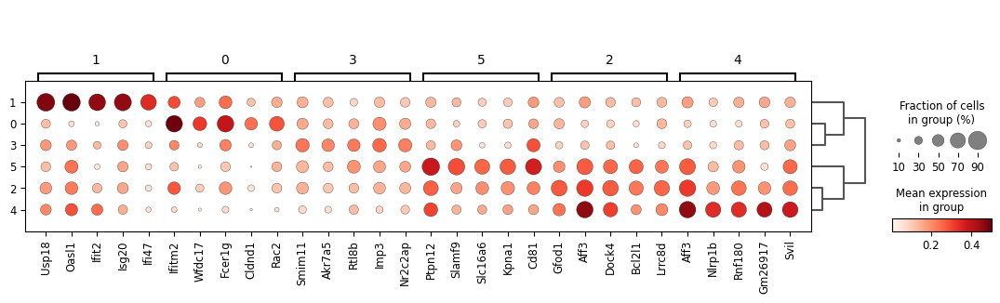

In [37]:
sc.tl.rank_genes_groups(adata_cDC1_T, "louvain")
sc.tl.filter_rank_genes_groups(adata_cDC1_T, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_in = 25% and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_cDC1_T.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_cDC1_T, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_cDC1_T, genes, groupby="louvain")
sc.tl.dendrogram(adata_cDC1_T, use_rep="X_pca_harmony", groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_cDC1_T, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "louvain")

# Early cDC1 vs Healthy cDC1
[//]: # (-.- .tabset .tabset-pills)

In [38]:
# DEG Tumor vs Healthy/Prénéo

sc.tl.rank_genes_groups(adata_cDC1, "Stage", groups = ["Early_Stages"], reference = "Healthy", key_added = "early_vs_healthy")
sc.tl.filter_rank_genes_groups(adata_cDC1, key = "early_vs_healthy", key_added = "early_vs_healthy_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['early_vs_healthy']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [39]:
df = sc.get.rank_genes_groups_df(adata_cDC1, group = "Early_Stages", key = "early_vs_healthy_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [40]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [41]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [42]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

47 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
2,B930036N10Rik,15.629284,1.872259,1.177238e-52,3.763043e-49,48.424461,UP
6,4930404I05Rik,12.022433,1.700718,1.915192e-32,2.040637e-29,28.690234,UP
42,Id3,7.552276,1.552925,5.951859e-14,9.224299e-12,11.035067,UP
29,Gm44710,8.750833,1.425747,3.743477e-18,1.029335e-15,14.987443,UP
46,Cubn,7.337801,1.323430,2.876617e-13,4.086713e-11,10.388626,UP
24,Tex14,8.951442,1.313442,6.301951e-19,1.895923e-16,15.722179,UP
40,1700023H06Rik,7.631718,1.311485,3.208064e-14,5.159536e-12,11.287389,UP
12,Hist1h1e,10.333147,1.254719,1.372559e-24,7.630234e-22,21.117462,UP
33,4930578M01Rik,8.294568,1.196975,1.695821e-16,3.906804e-14,13.408178,UP
70,Frmd8os,6.586147,1.188921,5.376398e-11,5.328886e-09,8.273364,UP


    DOWN-regulated genes

In [43]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

49 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25555,S100a9,-11.997734,-1.329100,1.520393e-32,1.690413e-29,28.772007,DOWN
25528,Slc15a2,-9.666037,-1.155781,7.698949e-22,3.227500e-19,18.491134,DOWN
25549,Nlrp1b,-11.331301,-0.998427,2.817345e-29,2.183186e-26,25.660909,DOWN
25440,March3,-7.357998,-0.979884,2.303770e-13,3.315675e-11,10.479428,DOWN
25517,Pde3b,-9.182540,-0.952214,6.909392e-20,2.337057e-17,16.631331,DOWN
25538,Fosl2,-10.284920,-0.941740,1.774091e-24,9.652565e-22,21.015357,DOWN
25504,Marcksl1,-8.603061,-0.828234,1.133921e-17,2.958839e-15,14.528879,DOWN
25475,Gpr68,-7.934438,-0.826108,2.786572e-15,5.357760e-13,12.271017,DOWN
25431,Igha,-7.245911,-0.820860,5.209104e-13,7.010906e-11,10.154226,DOWN
25540,Gm43914,-10.505002,-0.797025,1.875284e-25,1.089881e-22,21.962621,DOWN


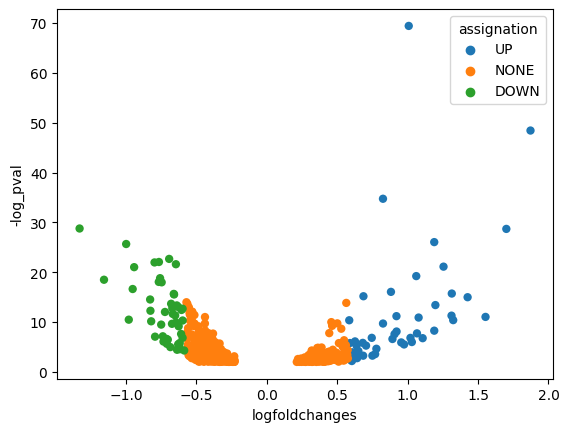

In [44]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [45]:
up_Early_vs_Healthy_cDC1 = list(df_up["names"].values)

In [46]:
df_enrich = sc.queries.enrich(up_Early_vs_Healthy_cDC1,org = "mmusculus")

In [47]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

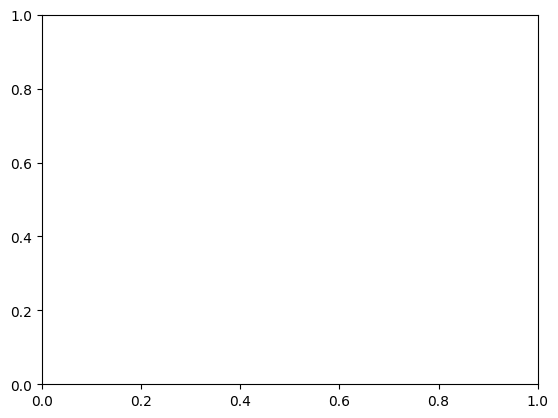

In [48]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

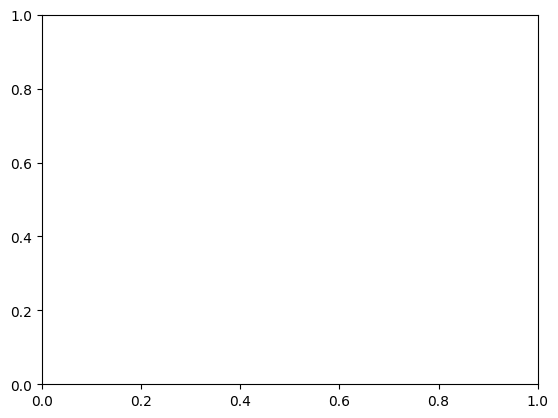

In [49]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

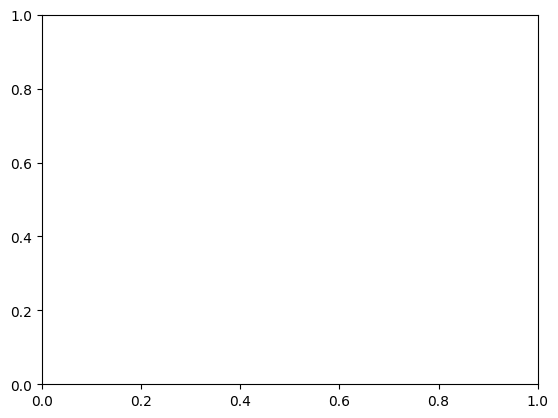

In [50]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: >

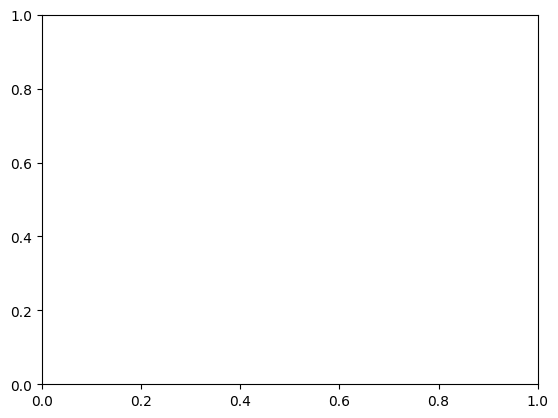

In [51]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [52]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

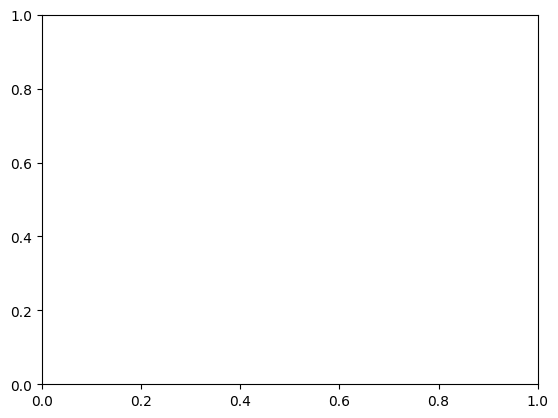

In [53]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

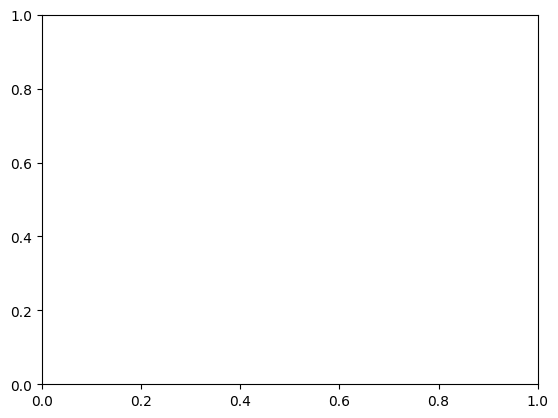

In [54]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

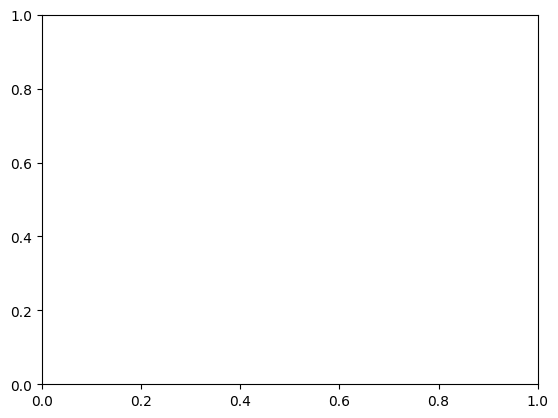

In [55]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [56]:
down_Early_vs_Healthy_cDC1 = list(df_down["names"].values)

In [57]:
df_enrich = sc.queries.enrich(down_Early_vs_Healthy_cDC1,org = "mmusculus")

In [58]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

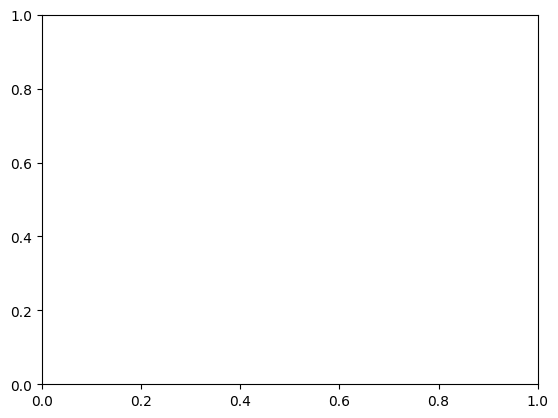

In [59]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

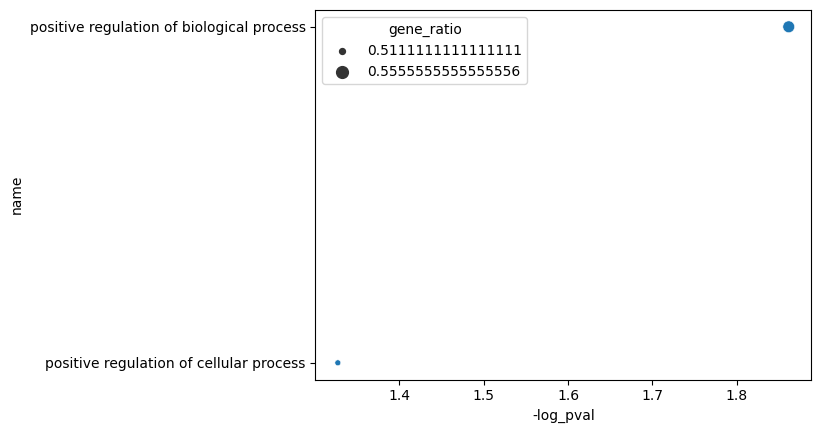

In [60]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

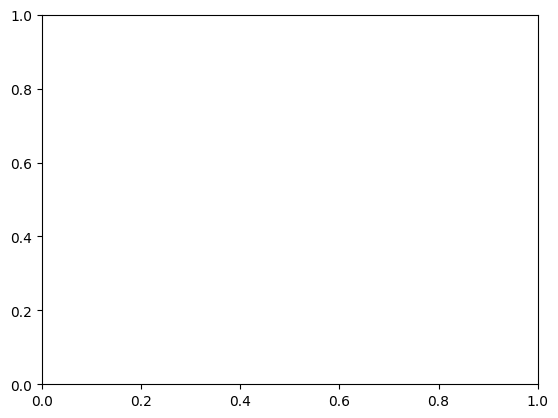

In [61]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

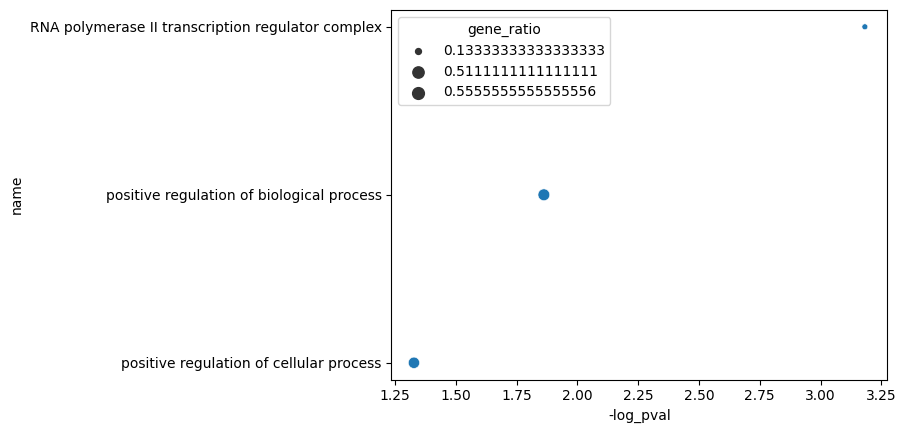

In [62]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [63]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

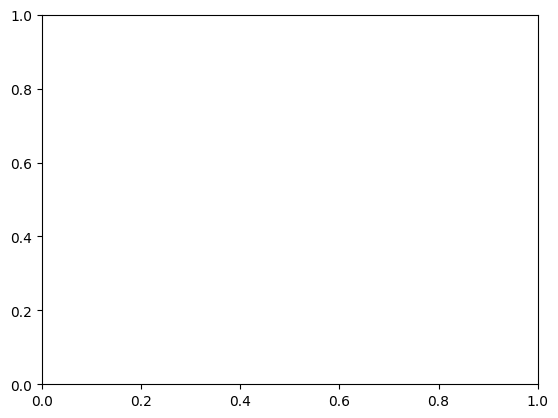

In [64]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

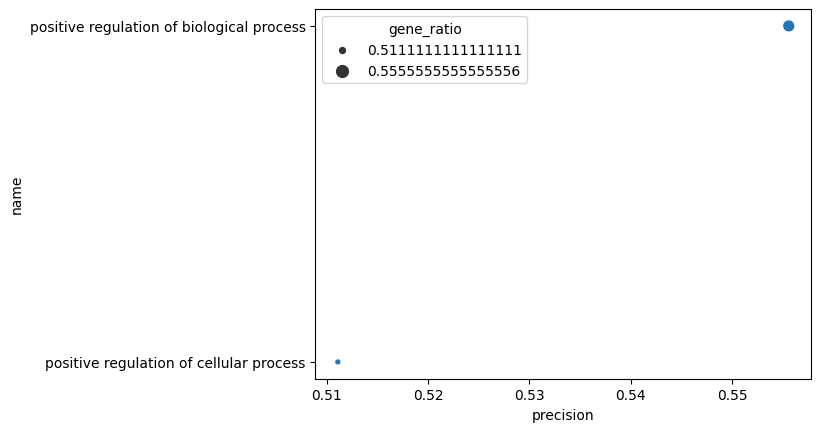

In [65]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

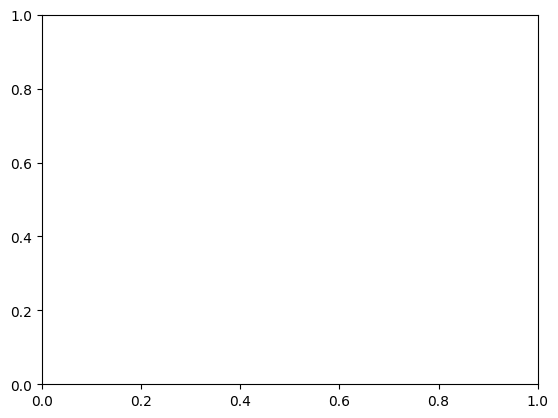

In [66]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

# Tumor cDC1 vs Healthy/Prénéo cDC1
[//]: # (-.- .tabset .tabset-pills)

In [67]:
is_tumor = ["Tumor" if i == "Tumor" else "No_tumor" for i in adata_cDC1.obs["Stage"].values]

adata_cDC1.obs["is_tumor"] = is_tumor

In [68]:
# DEG Tumor vs Healthy/Prénéo

sc.tl.rank_genes_groups(adata_cDC1, "is_tumor", groups = ["Tumor"], reference = "No_tumor", key_added = "tumor_vs_others")
sc.tl.filter_rank_genes_groups(adata_cDC1, key = "tumor_vs_others", key_added = "tumor_vs_others_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['tumor_vs_others']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [69]:
df = sc.get.rank_genes_groups_df(adata_cDC1, group = "Tumor", key = "tumor_vs_others_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [70]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [71]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [72]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

1160 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
576,Cwh43,11.107931,7.493876,1.754783e-27,3.971090e-26,25.401090,UP
352,Gucy2g,13.368802,7.178091,2.367312e-38,7.751203e-37,36.110631,UP
594,Abca13,10.971802,6.205437,6.968284e-27,1.529553e-25,24.815435,UP
18,Plet1,32.771954,6.165792,1.143782e-173,4.238957e-171,170.372741,UP
347,4930567K20Rik,13.451790,6.129696,8.080492e-39,2.680082e-37,36.571852,UP
370,Cdh1,13.107643,5.784544,4.887113e-37,1.550537e-35,34.809518,UP
4,Spint1,42.526325,5.651743,6.796229e-253,8.689659e-250,249.060997,UP
44,Zmynd15,27.277115,5.647219,7.068047e-131,1.412063e-128,127.850146,UP
6,Slfn1,37.996910,5.543896,1.759852e-216,1.285798e-213,212.890827,UP
385,Grm1,12.883591,5.536465,6.544114e-36,2.008957e-34,33.697029,UP


    DOWN-regulated genes

In [73]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

291 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25519,Gas7,-28.379456,-2.392699,4.654968e-164,1.587158e-161,160.799380,DOWN
25514,Tmtc2,-27.517090,-2.096349,5.112112e-154,1.390712e-151,150.856763,DOWN
25430,Cass4,-21.577925,-2.064599,1.956296e-98,2.359736e-96,95.627137,DOWN
25437,Lmo1,-21.852903,-2.048250,7.414545e-101,9.294351e-99,98.031781,DOWN
25491,Frmd4b,-25.361912,-1.993824,2.228802e-132,4.596366e-130,129.337585,DOWN
25473,Ryr1,-23.960732,-1.985940,9.720925e-120,1.726274e-117,116.762890,DOWN
25434,Zfp608,-21.745750,-1.976265,1.157704e-99,1.409753e-97,96.850857,DOWN
25438,Mcub,-21.894823,-1.926163,7.711876e-101,9.619907e-99,98.016829,DOWN
25472,Lrrc1,-23.944408,-1.895132,4.196164e-119,7.349610e-117,116.133736,DOWN
25501,Nrp1,-25.919264,-1.893385,1.265438e-137,2.915295e-135,134.535317,DOWN


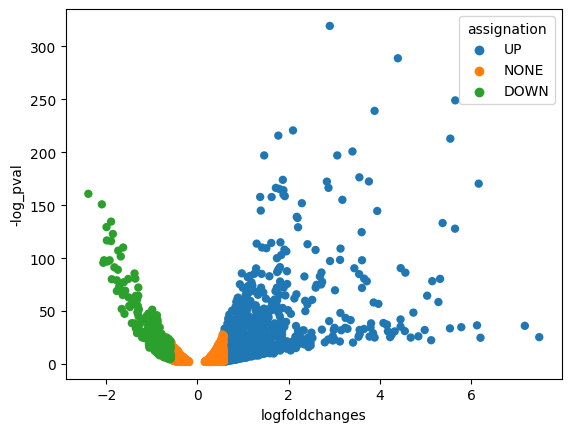

In [74]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [75]:
up_Tumor_vs_Others_cDC1 = list(df_up["names"].values)

In [76]:
df_enrich = sc.queries.enrich(up_Tumor_vs_Others_cDC1,org = "mmusculus")

In [77]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

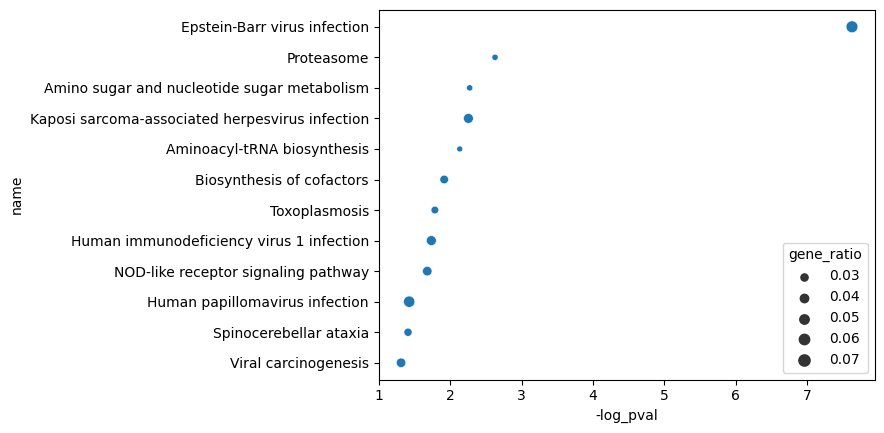

In [78]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

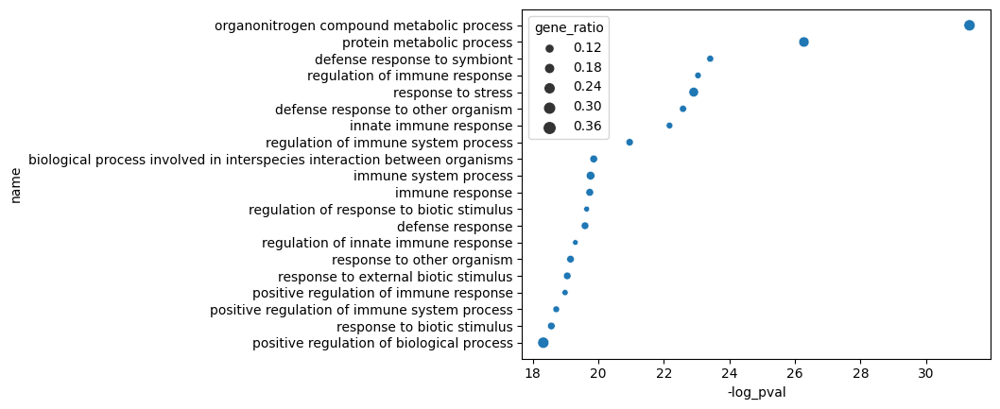

In [79]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

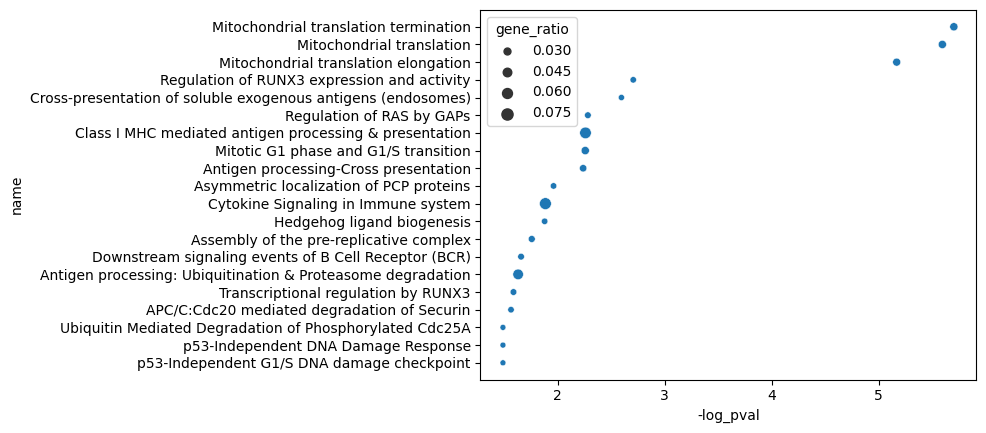

In [80]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

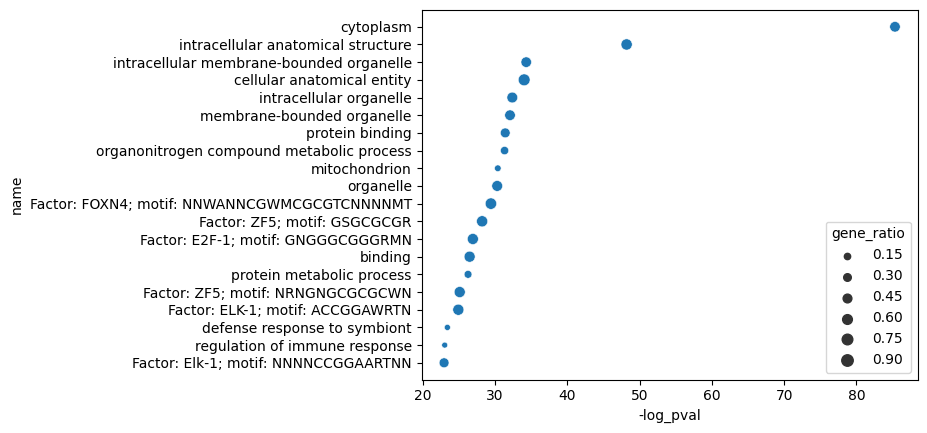

In [81]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [82]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

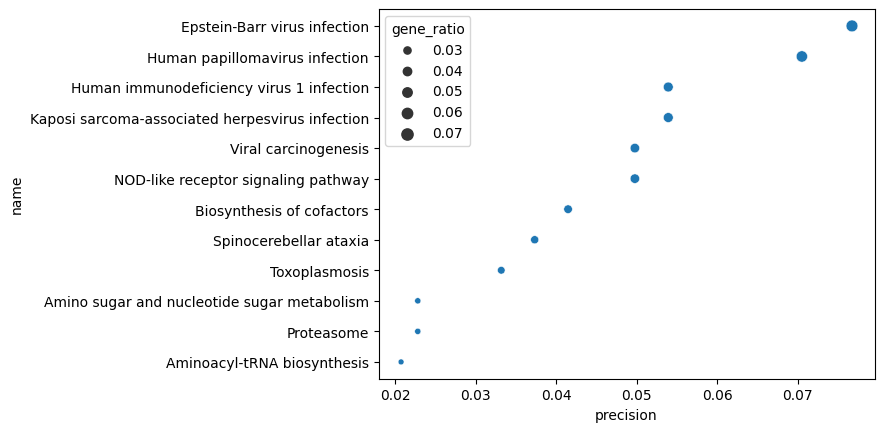

In [83]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

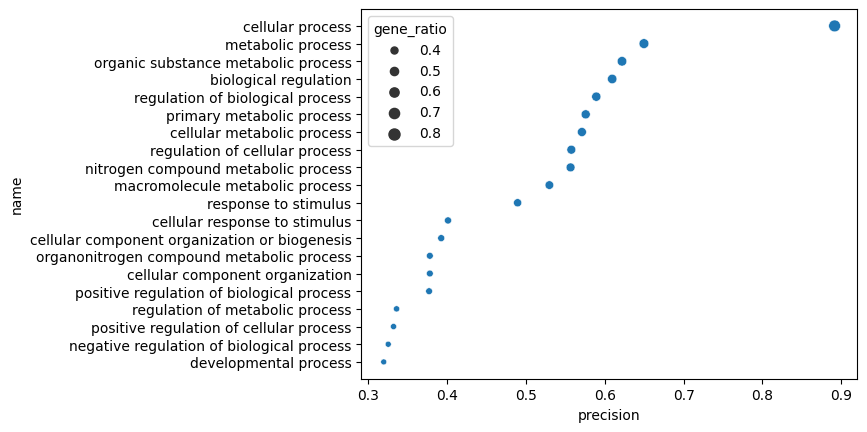

In [84]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

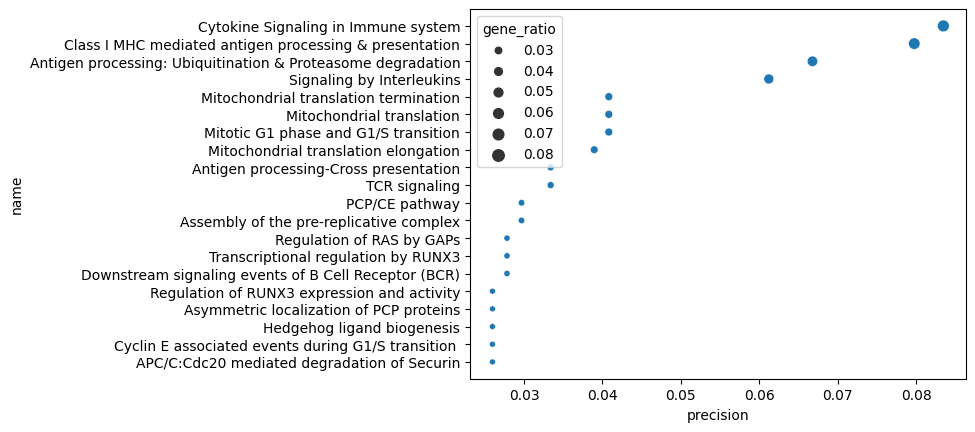

In [85]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [86]:
down_Tumor_vs_Others_cDC1 = list(df_down["names"].values)

In [87]:
df_enrich = sc.queries.enrich(down_Tumor_vs_Others_cDC1,org = "mmusculus")

In [88]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

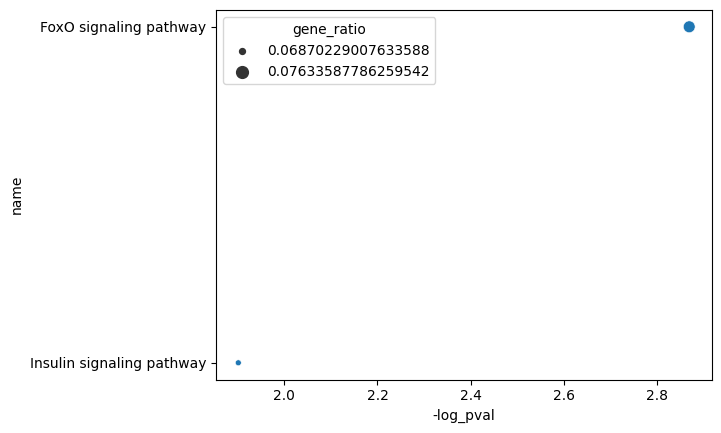

In [89]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

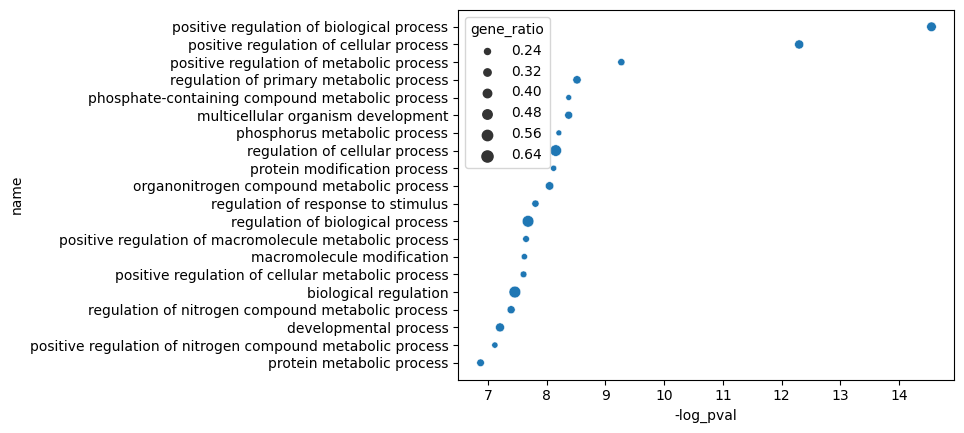

In [90]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

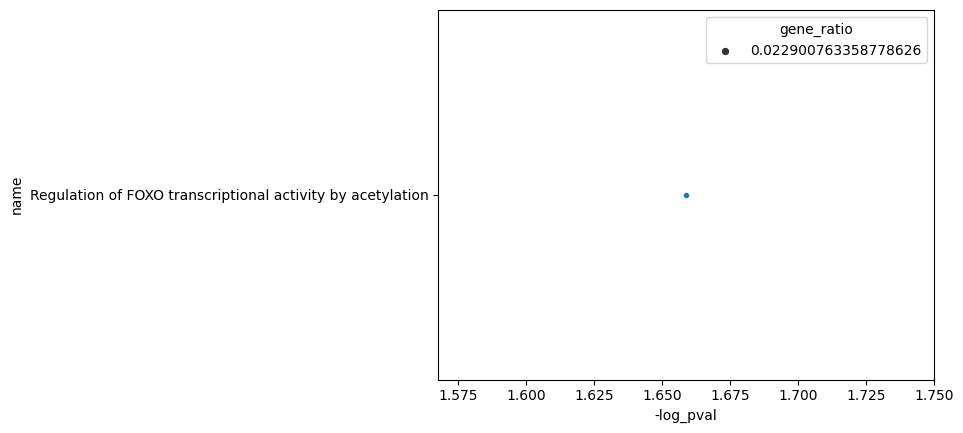

In [91]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

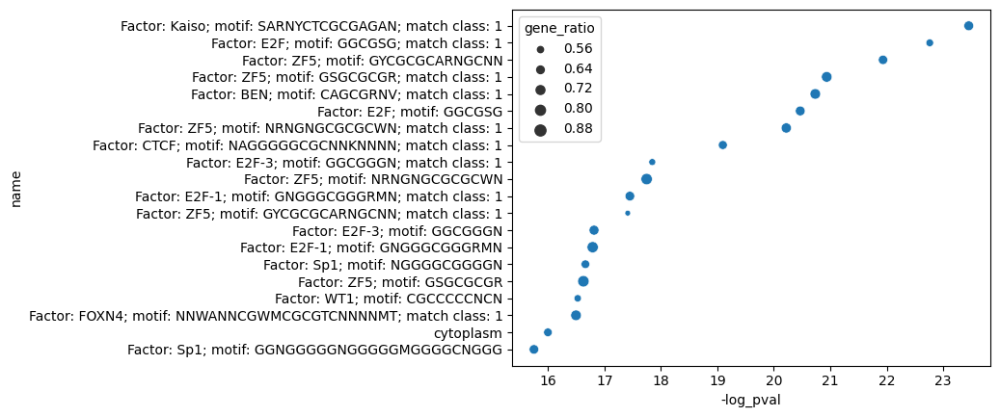

In [92]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [93]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

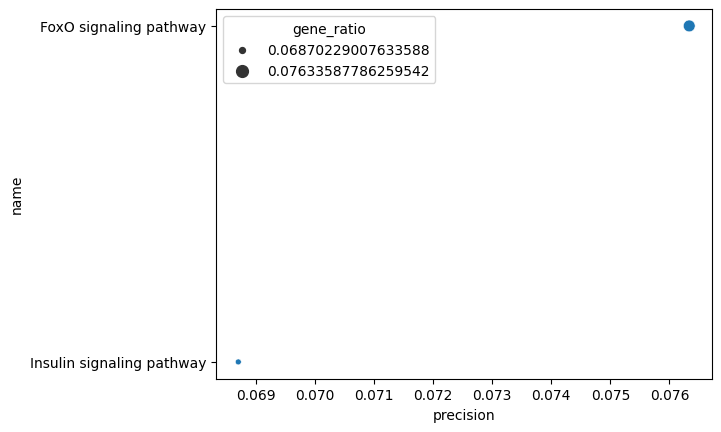

In [94]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

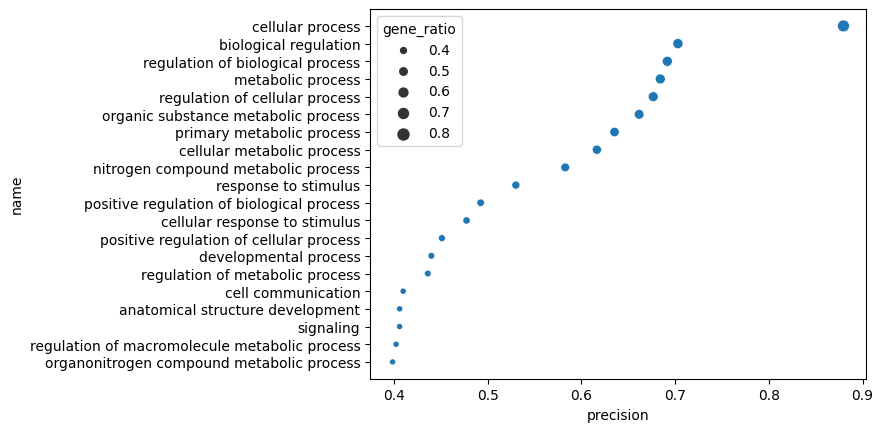

In [95]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

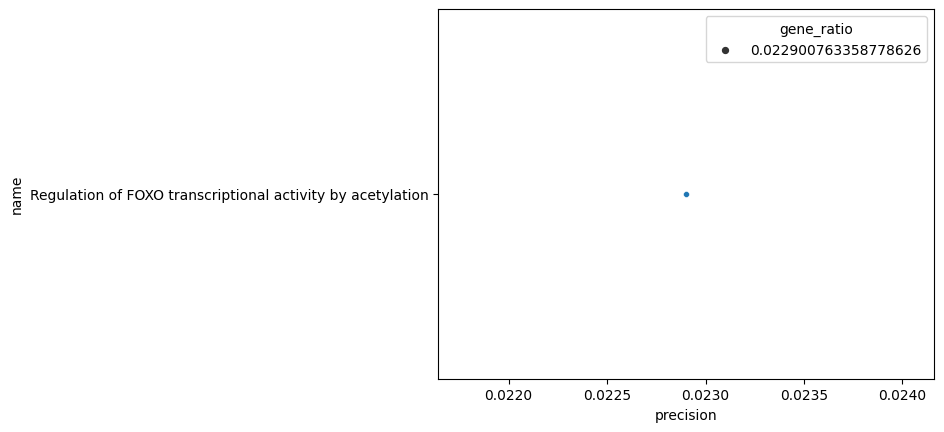

In [96]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

In [97]:
# La on a les pathways tumor vs others mais on trouve des trucs comme cell motility. 
# Il faudrait savoir si on a des pathways exclusifs entre tumor et prénéo et entre tumor et healthy

In [98]:
df_up.to_csv("../data/DEG_DC/up_cDC1_tumor_vs_others.csv")

In [99]:
df_down.to_csv("../data/DEG_DC/down_cDC1_tumor_vs_others.csv")

# Tumor cDC1 vs Healthy cDC1
[//]: # (-.- .tabset .tabset-pills)

In [100]:
# DEG Tumor vs Healthy

sc.tl.rank_genes_groups(adata_cDC1, "Stage", groups = ["Tumor"], reference = "Healthy", key_added = "tumor_vs_healthy")
sc.tl.filter_rank_genes_groups(adata_cDC1, key = "tumor_vs_healthy", key_added = "tumor_vs_healthy_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['tumor_vs_healthy']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [101]:
df = sc.get.rank_genes_groups_df(adata_cDC1, group = "Tumor", key = "tumor_vs_healthy_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [102]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [103]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [104]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

1334 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
343,Gucy2g,13.371049,7.405824,2.264278e-38,7.689523e-37,36.114101,UP
376,Tm4sf5,12.903799,6.732115,5.423288e-36,1.689212e-34,33.772316,UP
549,Cwh43,11.023008,6.593793,4.067567e-27,9.430266e-26,25.025476,UP
38,Zmynd15,27.613634,6.588857,2.333507e-133,5.629475e-131,130.249532,UP
550,Abca13,11.002185,6.568739,5.098305e-27,1.176659e-25,24.929349,UP
13,Plet1,32.900627,6.562489,9.344998e-175,4.344914e-172,171.362019,UP
337,4930567K20Rik,13.488267,6.521855,5.138010e-39,1.792486e-37,36.746544,UP
6,Slfn1,38.424641,6.339379,6.189871e-220,6.087976e-217,216.215527,UP
4,Spint1,42.886898,6.257674,9.751811e-256,1.558583e-252,251.807270,UP
35,Oasl1,28.326220,6.211524,3.721467e-139,1.012397e-136,135.994649,UP


    DOWN-regulated genes

In [105]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

378 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25515,Gas7,-26.208138,-2.600259,6.654573e-136,1.701707e-133,132.769115,DOWN
25516,Tmtc2,-26.233051,-2.337347,5.781440e-137,1.508602e-134,133.821425,DOWN
25497,Frmd4b,-24.955347,-2.222737,1.445835e-125,3.055611e-123,122.514902,DOWN
25383,Cass4,-18.727028,-2.137441,3.592941e-74,3.002571e-72,71.522507,DOWN
25450,Ryr1,-21.773130,-2.114442,8.996643e-98,1.179806e-95,94.928189,DOWN
25491,Zc3h12c,-24.202198,-2.088544,1.073943e-118,2.034286e-116,115.691588,DOWN
25382,Stom,-18.693184,-2.083407,6.988997e-74,5.765246e-72,71.239182,DOWN
25473,Lrrc1,-22.844469,-2.076378,5.476779e-107,8.592158e-105,104.065898,DOWN
25400,Timd4,-19.204216,-2.013785,6.106437e-78,5.657747e-76,75.247357,DOWN
25475,Nrp1,-23.035486,-1.971054,9.520003e-109,1.531104e-106,105.814995,DOWN


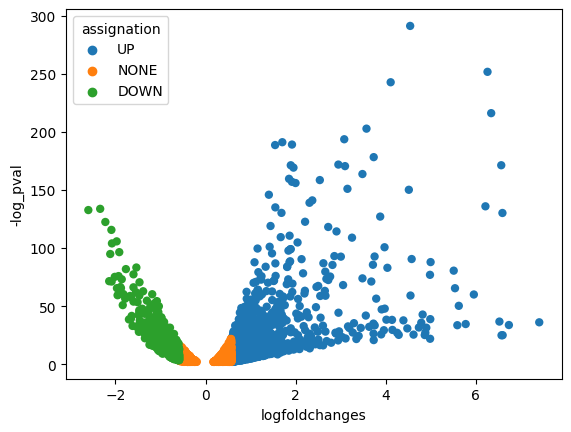

In [106]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [107]:
up_Tumor_vs_Healthy_cDC1 = list(df_up["names"].values)

In [108]:
df_enrich = sc.queries.enrich(up_Tumor_vs_Healthy_cDC1,org = "mmusculus")

In [109]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

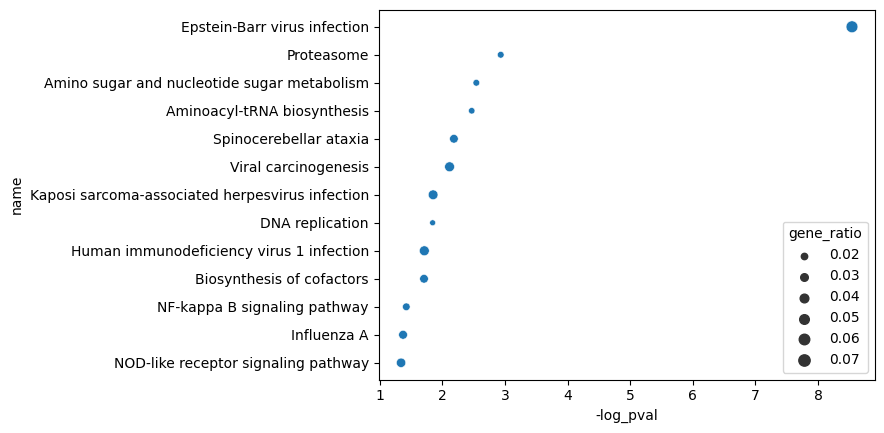

In [110]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

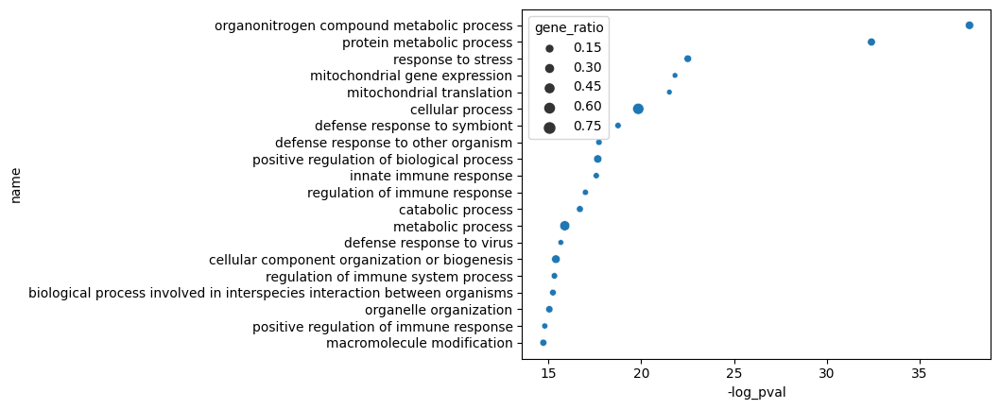

In [111]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

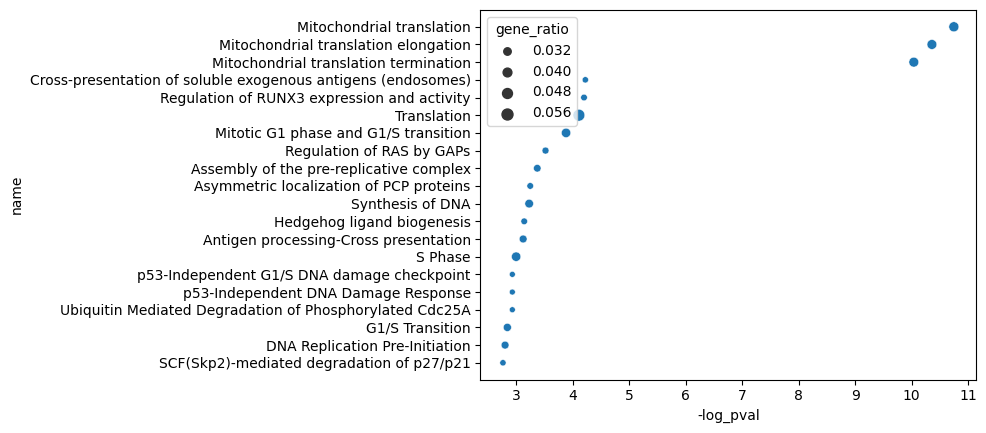

In [112]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All Databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

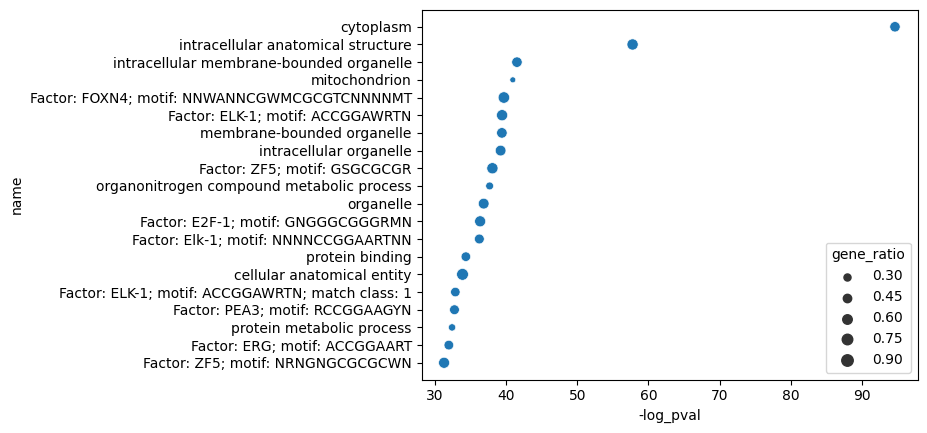

In [113]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [114]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

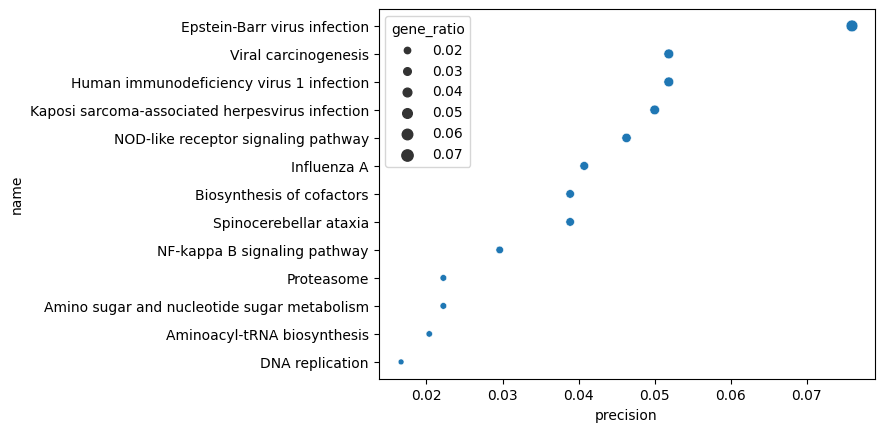

In [115]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

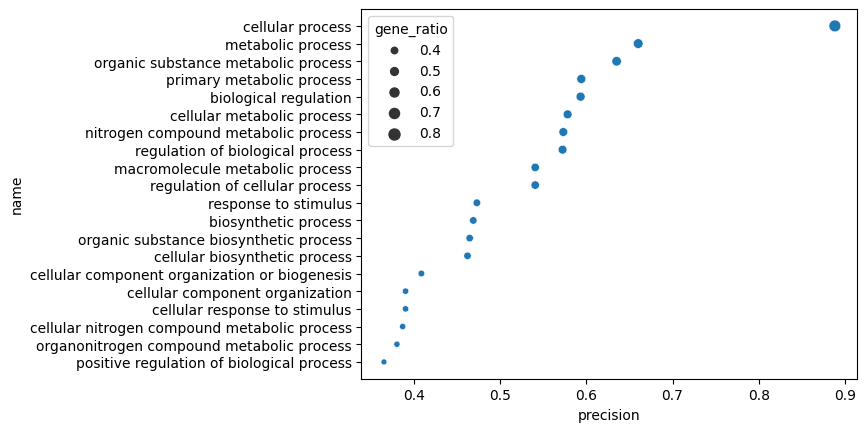

In [116]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

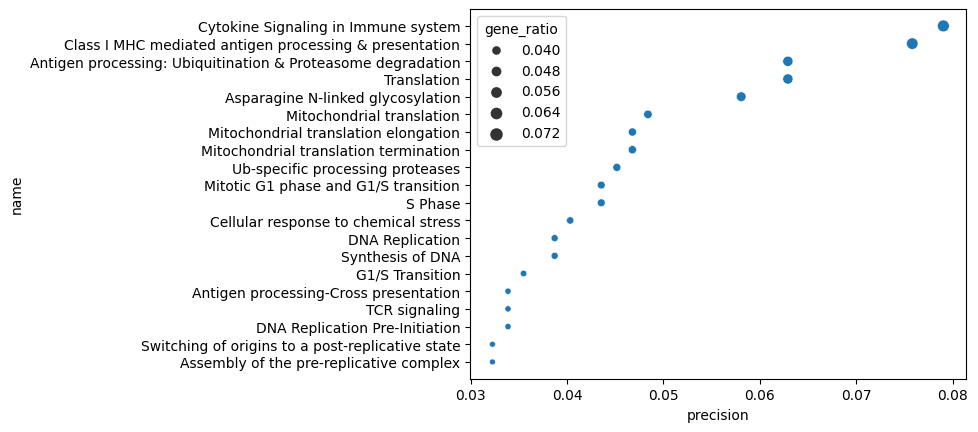

In [117]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [118]:
down_Tumor_vs_Healthy_cDC1 = list(df_down["names"].values)

In [119]:
df_enrich = sc.queries.enrich(down_Tumor_vs_Healthy_cDC1,org = "mmusculus")

In [120]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

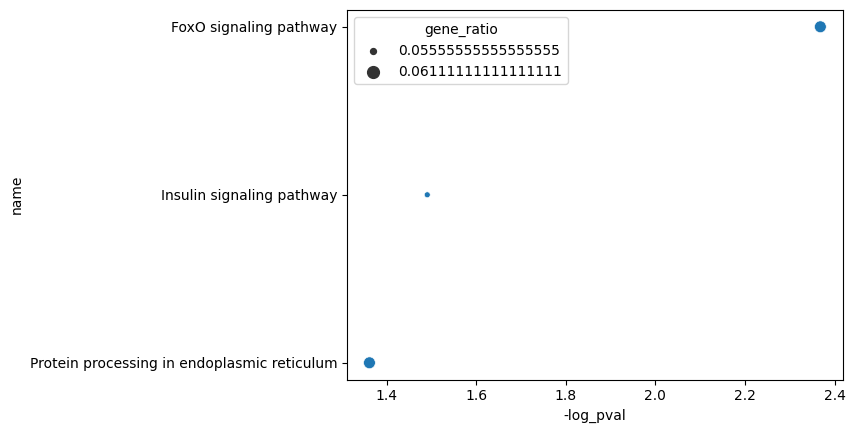

In [121]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

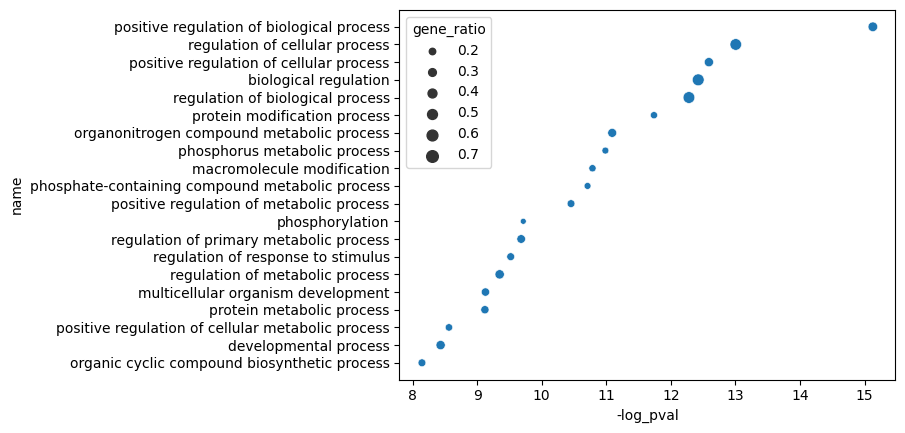

In [122]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

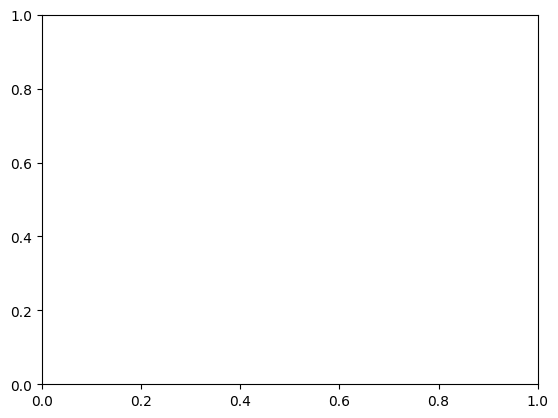

In [123]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All Databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

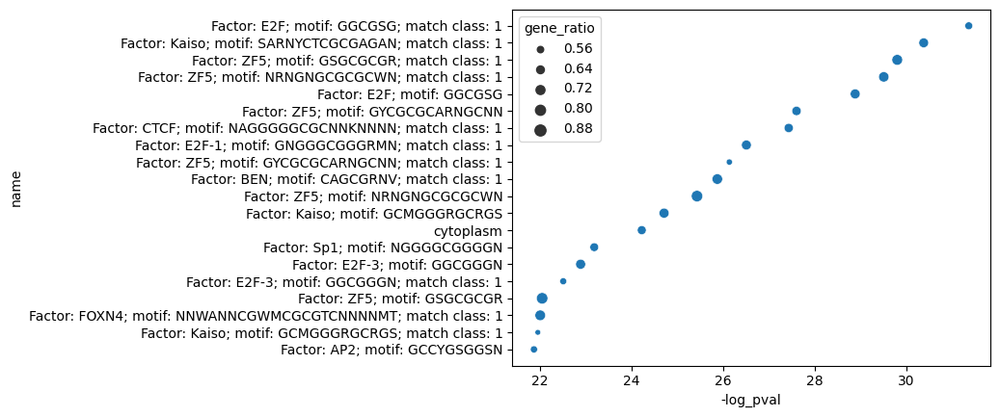

In [124]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [125]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

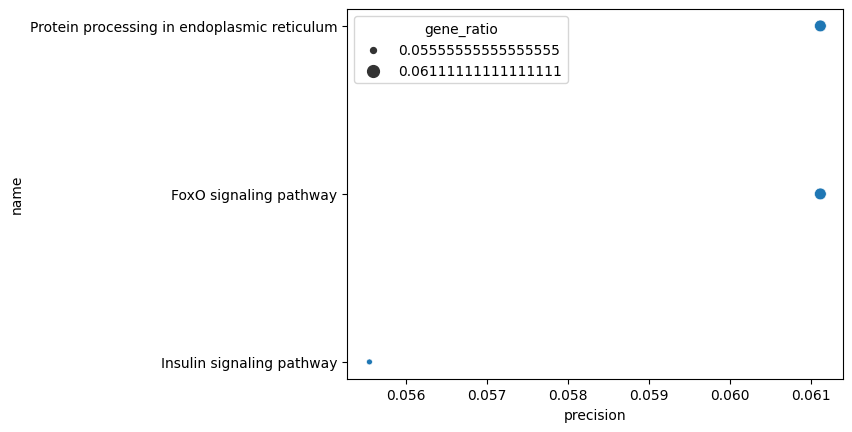

In [126]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

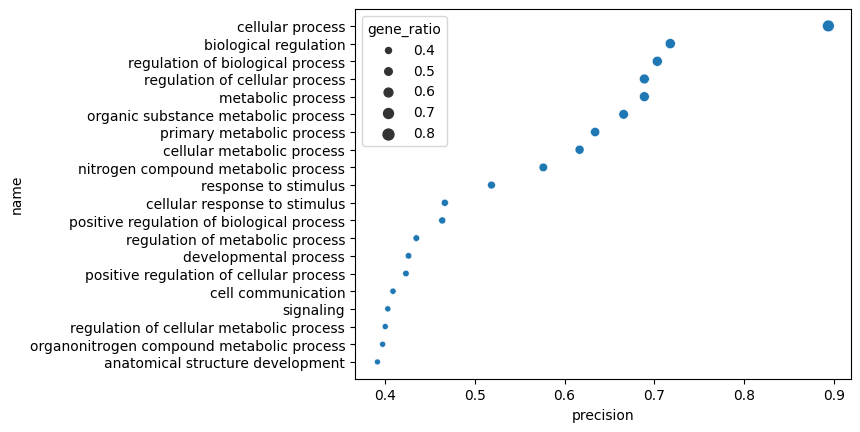

In [127]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

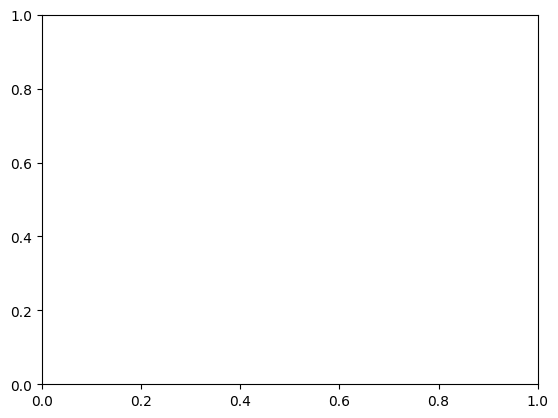

In [128]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

# Tumor cDC1 vs Preneo cDC1
[//]: # (-.- .tabset .tabset-pills)

In [129]:
# DEG Tumor vs Preneo

sc.tl.rank_genes_groups(adata_cDC1, "Stage", groups = ["Tumor"], reference = "Early_Stages", key_added = "tumor_vs_early")
sc.tl.filter_rank_genes_groups(adata_cDC1, key = "tumor_vs_early", key_added = "tumor_vs_early_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['tumor_vs_early']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [130]:
df = sc.get.rank_genes_groups_df(adata_cDC1, group = "Tumor", key = "tumor_vs_early_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [131]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [132]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [133]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

1086 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
381,Cwh43,11.183533,25.313259,8.162190e-28,2.907013e-26,25.536553,UP
228,Gucy2g,13.331977,6.953269,3.549529e-38,1.837420e-36,35.735791,UP
405,Abca13,10.885768,5.875319,1.599434e-26,5.374604e-25,24.269654,UP
12,Plet1,32.419487,5.811663,8.335271e-172,7.612484e-169,168.118474,UP
250,Cdh1,13.053848,5.797550,8.471094e-37,4.222667e-35,34.374413,UP
232,4930567K20Rik,13.246120,5.779312,7.507817e-38,3.816897e-36,35.418290,UP
262,Grm1,12.788441,5.478957,1.754800e-35,8.356379e-34,33.077982,UP
70,Axl,20.389330,5.367020,4.508256e-81,7.296526e-79,78.136884,UP
452,Kcp,10.435044,5.304898,1.364830e-24,4.184823e-23,22.378323,UP
3,Spint1,41.358772,5.169076,7.481398e-249,1.471648e-245,244.832196,UP


    DOWN-regulated genes

In [134]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

225 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25450,Lmo1,-17.429890,-2.153549,2.736113e-64,2.964741e-62,61.528013,DOWN
25454,Gas7,-17.602364,-2.118205,1.832739e-65,2.055561e-63,62.687070,DOWN
25432,Zfp608,-16.809126,-1.989224,2.438000e-60,2.292078e-58,57.639771,DOWN
25398,Cass4,-15.262593,-1.976372,1.980961e-50,1.507653e-48,47.821699,DOWN
25437,Mcub,-17.078947,-1.967272,3.894919e-62,3.921294e-60,59.406571,DOWN
25417,Ryr1,-15.790245,-1.824545,1.143505e-53,9.682688e-52,51.014004,DOWN
25471,Nrp1,-18.500999,-1.799350,4.279680e-72,5.612306e-70,69.250859,DOWN
25442,Tmtc2,-17.224789,-1.773626,2.901929e-63,3.066452e-61,60.513364,DOWN
25302,Ccl2,-12.498490,-1.707610,7.350787e-35,3.442753e-33,32.463094,DOWN
25352,Phka2,-14.079842,-1.703762,1.738582e-43,1.053532e-41,40.977352,DOWN


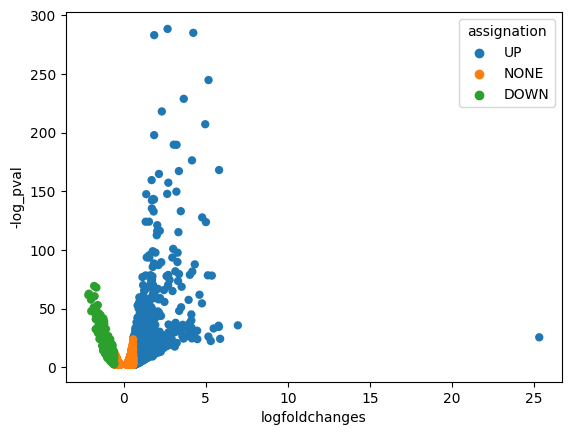

In [135]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [136]:
up_Tumor_vs_Early_cDC1 = list(df_up["names"].values)

In [137]:
df_enrich = sc.queries.enrich(up_Tumor_vs_Early_cDC1,org = "mmusculus")

In [138]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

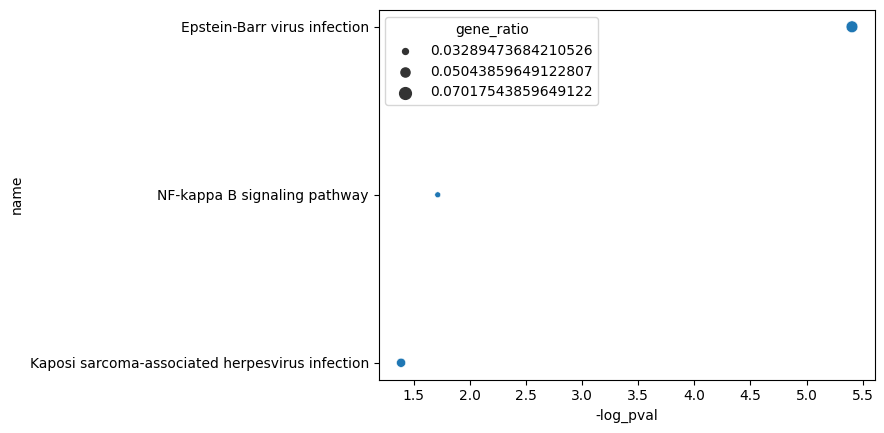

In [139]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

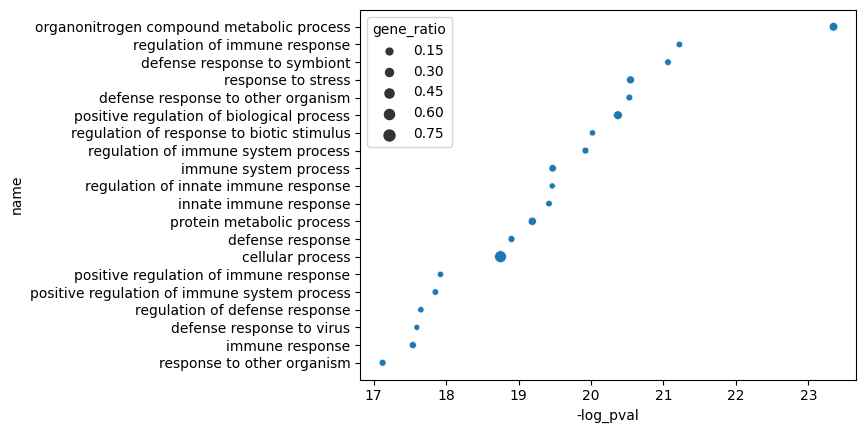

In [140]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

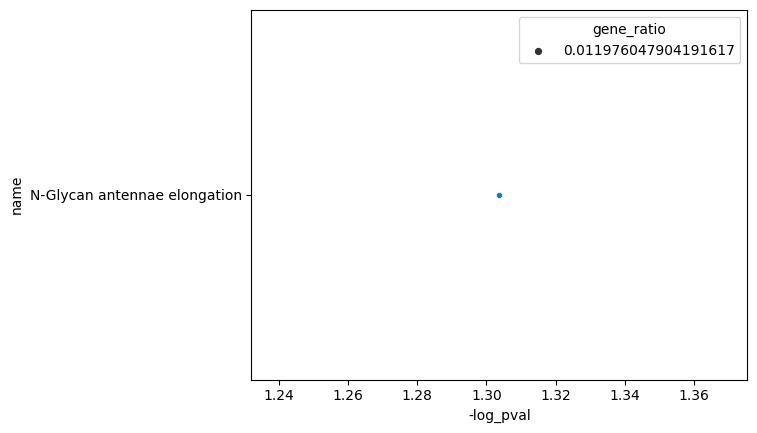

In [141]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All Databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

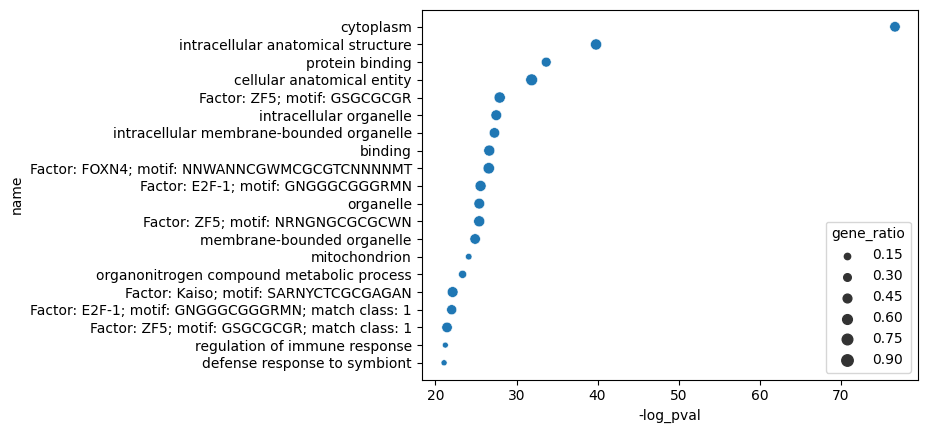

In [142]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

In [143]:
test = df_enrich.sort_values("precision", ascending = False)

### Precision
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

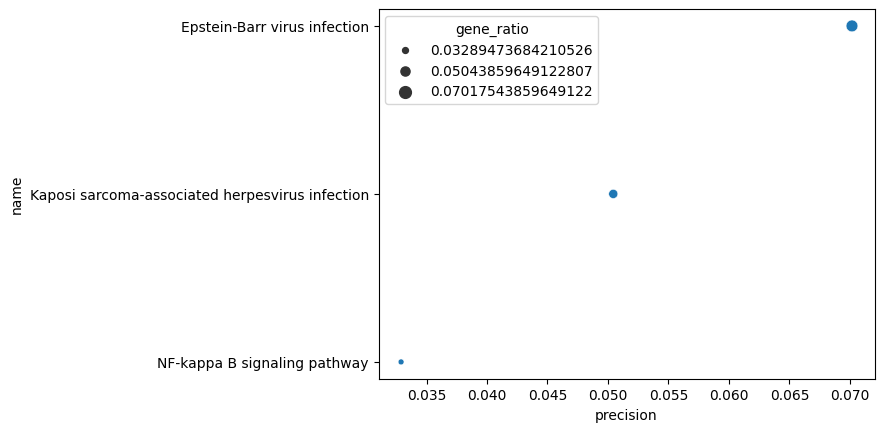

In [144]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

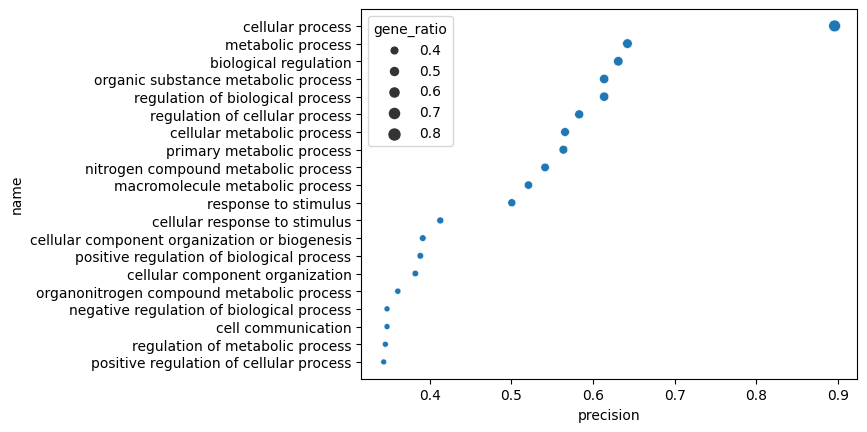

In [145]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

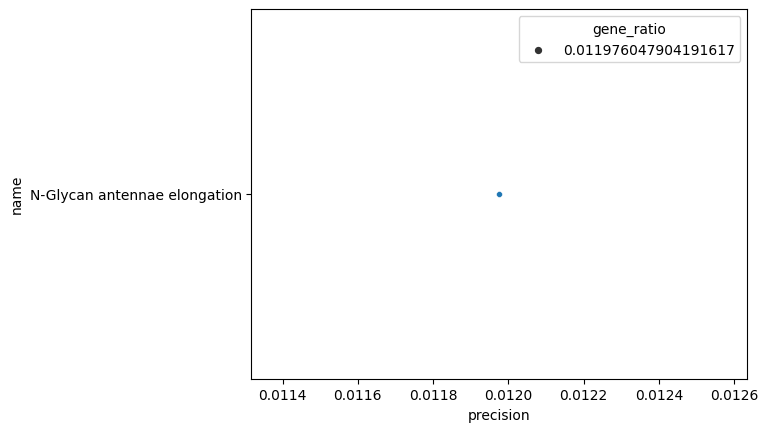

In [146]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [147]:
down_Tumor_vs_Early_cDC1 = list(df_down["names"].values)

In [148]:
df_enrich = sc.queries.enrich(down_Tumor_vs_Early_cDC1,org = "mmusculus")

In [149]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

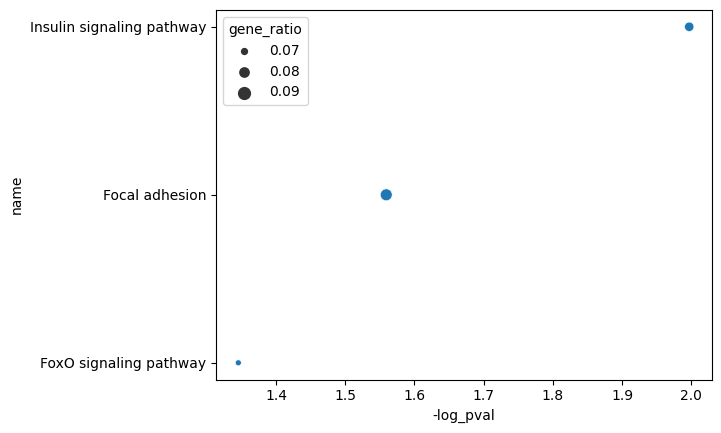

In [150]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

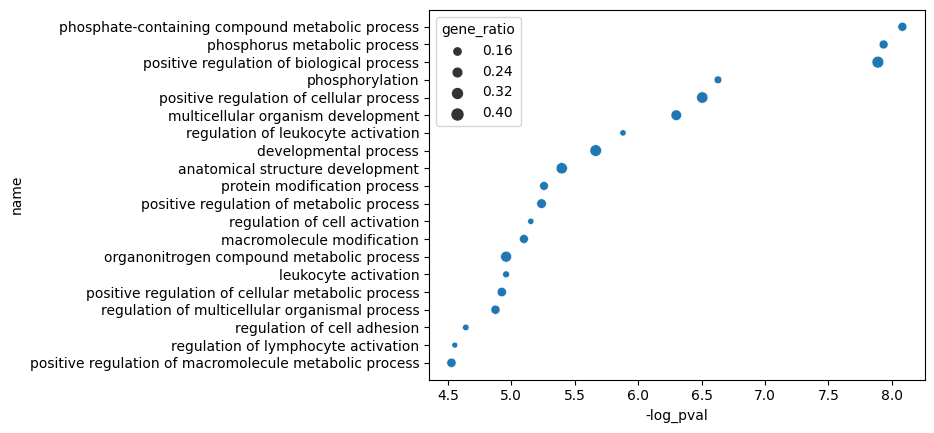

In [151]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

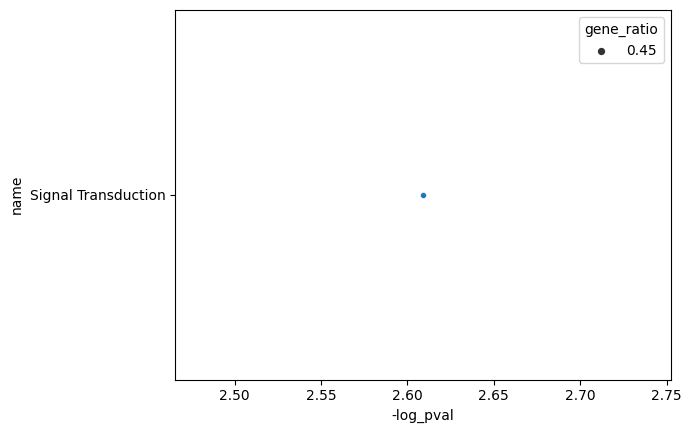

In [152]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All Databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

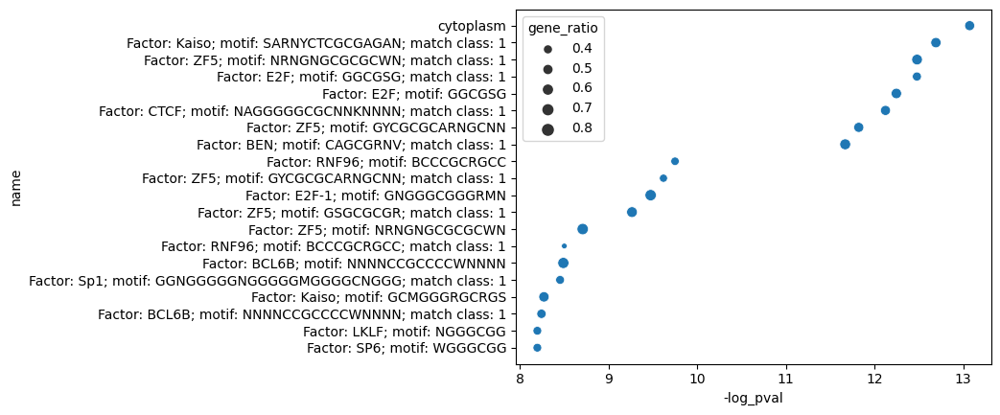

In [153]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [154]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

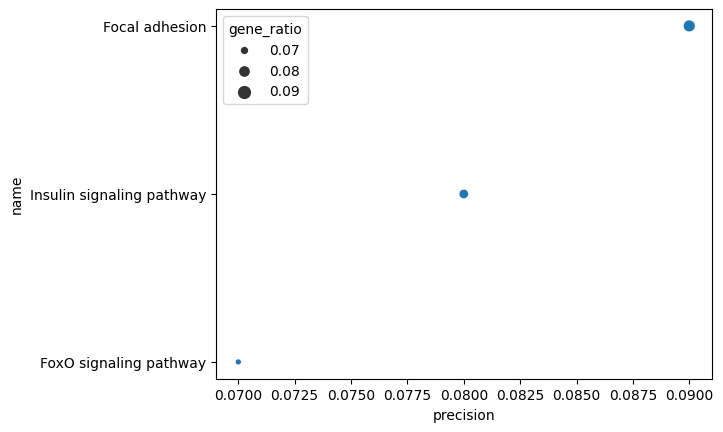

In [155]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

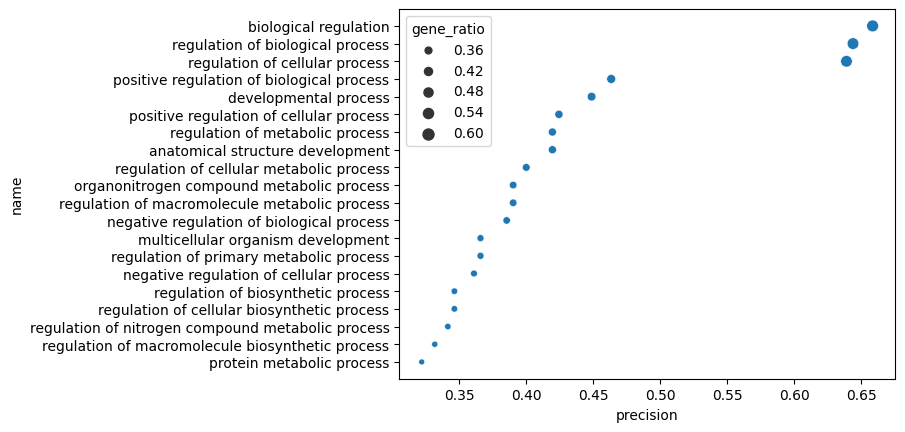

In [156]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

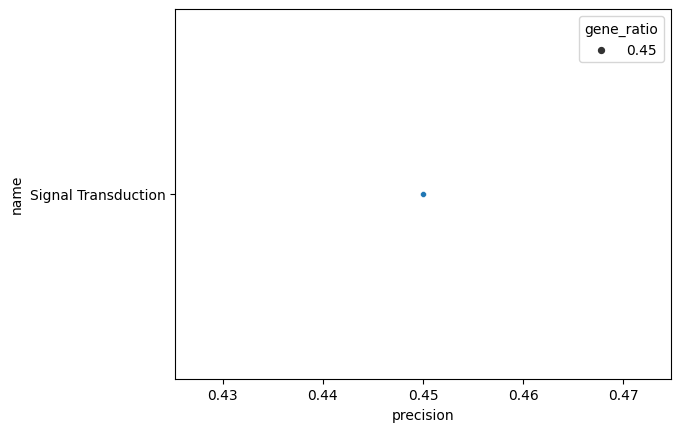

In [157]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Venn diagram
[//]: # (-.- .tabset .tabset-pills)

### UP
[//]: # (-.- .tabset .tabset-pills)

In [158]:
# Diagramme de venn
from matplotlib_venn import venn2


df_enrich_up_TE_cDC1 = sc.queries.enrich(up_Tumor_vs_Early_cDC1,org = "mmusculus")
df_enrich_up_TH_cDC1 = sc.queries.enrich(up_Tumor_vs_Healthy_cDC1,org = "mmusculus")

TE_kegg = df_enrich_up_TE_cDC1[df_enrich_up_TE_cDC1["source"] == 'KEGG']
TH_kegg = df_enrich_up_TH_cDC1[df_enrich_up_TH_cDC1["source"] == 'KEGG']

TE_gobp = df_enrich_up_TE_cDC1[df_enrich_up_TE_cDC1["source"] == 'GO:BP']
TH_gobp = df_enrich_up_TH_cDC1[df_enrich_up_TH_cDC1["source"] == 'GO:BP']

TE_reac = df_enrich_up_TE_cDC1[df_enrich_up_TE_cDC1["source"] == 'REAC']
TH_reac = df_enrich_up_TH_cDC1[df_enrich_up_TH_cDC1["source"] == 'REAC']

In [159]:
def venn_diagram(a1, b1, labels=['A', 'B']):

    a = set(a1)
    b = set(b1)

    only_a = len(a - b)
    only_b = len(b - a)

    a_b = len(a & b)
    
    venn2(subsets=(only_a, only_b, a_b), set_labels=labels)
    
    print(f"only in {labels[0]} : {a-b}")
    print("---------------------------------------------------------------")
    print(f"only in {labels[1]} : {b-a}")
    

#### KEGG

only in TE : set()
---------------------------------------------------------------
only in TH : {'NOD-like receptor signaling pathway', 'Biosynthesis of cofactors', 'Human immunodeficiency virus 1 infection', 'Aminoacyl-tRNA biosynthesis', 'Viral carcinogenesis', 'Influenza A', 'Amino sugar and nucleotide sugar metabolism', 'DNA replication', 'Proteasome', 'Spinocerebellar ataxia'}


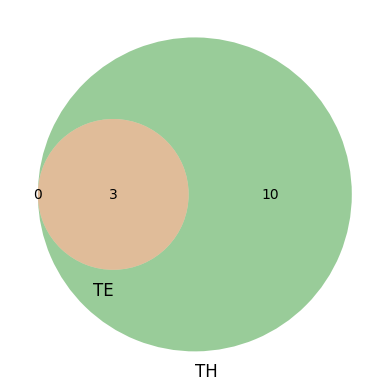

In [160]:
# KEGG
venn_diagram(TE_kegg.name.values, TH_kegg.name.values, labels = ["TE", "TH"])

#### GO:BP

only in TE : {'regulation of leukocyte proliferation', 'positive regulation of cellular component organization', 'positive regulation of leukocyte proliferation', 'regulation of cell population proliferation', 'immune effector process', 'regulation of cell-cell adhesion', 'regulation of cell differentiation', 'MAPK cascade', 'leukocyte mediated immunity', 'positive regulation of cell-cell adhesion', 'multicellular organism development', 'cytoskeleton organization', 'protein phosphorylation', 'actin cytoskeleton organization', 'cellular developmental process', 'organophosphate biosynthetic process', 'lymphocyte activation', 'regulation of lymphocyte mediated immunity', 'regulation of hemopoiesis', 'signal transduction', 'platelet morphogenesis', 'regulation of cell cycle', 'phosphorylation', 'cell communication', 'regulation of developmental process', 'negative regulation of metabolic process', 'regulation of CD8-positive, alpha-beta T cell activation', 'type II interferon-mediated sign

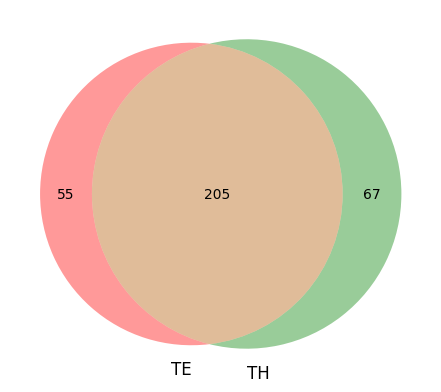

In [161]:
# GO/BP
venn_diagram(TE_gobp.name.values, TH_gobp.name.values, labels = ["TE", "TH"])

#### REAC

only in TE : {'N-Glycan antennae elongation'}
---------------------------------------------------------------
only in TH : {'FBXL7 down-regulates AURKA during mitotic entry and in early mitosis', 'Cyclin A:Cdk2-associated events at S phase entry', 'Orc1 removal from chromatin', 'GSK3B and BTRC:CUL1-mediated-degradation of NFE2L2', 'Ub-specific processing proteases', 'Antigen processing: Ubiquitination & Proteasome degradation', 'G1/S DNA Damage Checkpoints', 'AUF1 (hnRNP D0) binds and destabilizes mRNA', 'APC/C:Cdh1 mediated degradation of Cdc20 and other APC/C:Cdh1 targeted proteins in late mitosis/early G1', 'Oxygen-dependent proline hydroxylation of Hypoxia-inducible Factor Alpha', 'Degradation of AXIN', 'Cdc20:Phospho-APC/C mediated degradation of Cyclin A', 'APC/C:Cdc20 mediated degradation of Securin', 'Interleukin-1 signaling', 'Transcriptional regulation by RUNX3', 'GLI3 is processed to GLI3R by the proteasome', 'Mitochondrial translation termination', 'The role of GTSE1 in G2/

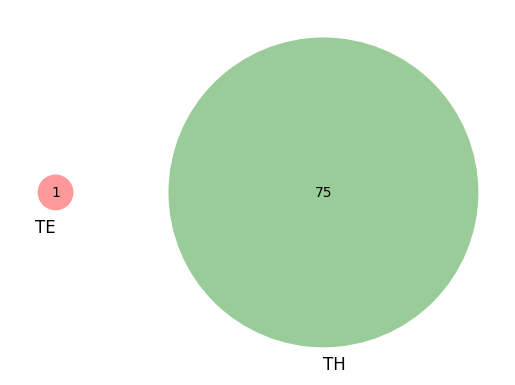

In [162]:
# REAC
venn_diagram(TE_reac.name.values, TH_reac.name.values, labels = ["TE", "TH"])

### DOWN
[//]: # (-.- .tabset .tabset-pills)

In [163]:
# Diagramme de venn
from matplotlib_venn import venn2


df_enrich_down_TE_cDC1 = sc.queries.enrich(down_Tumor_vs_Early_cDC1,org = "mmusculus")
df_enrich_down_TH_cDC1 = sc.queries.enrich(down_Tumor_vs_Healthy_cDC1,org = "mmusculus")

TE_kegg = df_enrich_down_TE_cDC1[df_enrich_down_TE_cDC1["source"] == 'KEGG']
TH_kegg = df_enrich_down_TH_cDC1[df_enrich_down_TH_cDC1["source"] == 'KEGG']

TE_gobp = df_enrich_down_TE_cDC1[df_enrich_down_TE_cDC1["source"] == 'GO:BP']
TH_gobp = df_enrich_down_TH_cDC1[df_enrich_down_TH_cDC1["source"] == 'GO:BP']

TE_reac = df_enrich_down_TE_cDC1[df_enrich_down_TE_cDC1["source"] == 'REAC']
TH_reac = df_enrich_down_TH_cDC1[df_enrich_down_TH_cDC1["source"] == 'REAC']

#### KEGG

only in TE : {'Focal adhesion'}
---------------------------------------------------------------
only in TH : {'Protein processing in endoplasmic reticulum'}


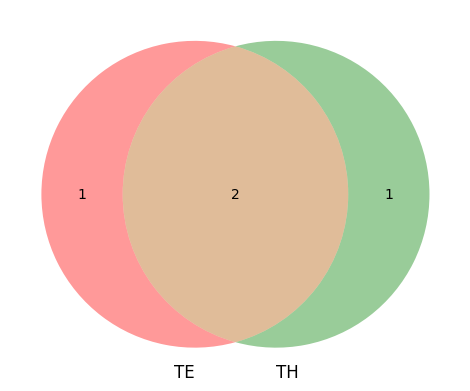

In [164]:
# KEGG
venn_diagram(TE_kegg.name.values, TH_kegg.name.values, labels = ["TE", "TH"])

#### GO:BP

only in TE : {'positive regulation of cellular component organization', 'regulation of lipid catabolic process', 'immune system process', 'endothelial cell apoptotic process', 'antigen receptor-mediated signaling pathway', 'response to oxidative stress', 'epithelial cell apoptotic process', 'positive regulation of muscle cell apoptotic process', 'positive regulation of immune system process', 'negative regulation of programmed cell death', 'cellular response to oxidative stress', 'B cell apoptotic process', 'positive regulation of B cell receptor signaling pathway'}
---------------------------------------------------------------
only in TH : {'regulation of programmed cell death', 'cellular nitrogen compound biosynthetic process', 'regulation of molecular function', 'lymphocyte differentiation', 'organophosphate biosynthetic process', 'positive regulation of cell differentiation', 'regulation of nucleobase-containing compound metabolic process', 'anatomical structure morphogenesis', 'v

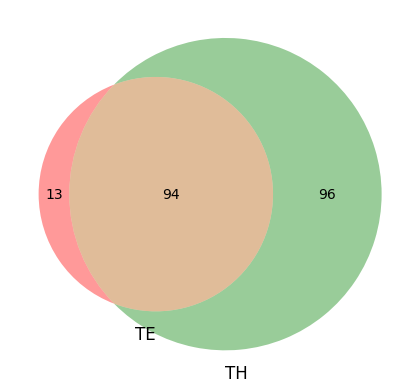

In [165]:
# GO/BP
venn_diagram(TE_gobp.name.values, TH_gobp.name.values, labels = ["TE", "TH"])

#### REAC

only in TE : {'Signal Transduction'}
---------------------------------------------------------------
only in TH : set()


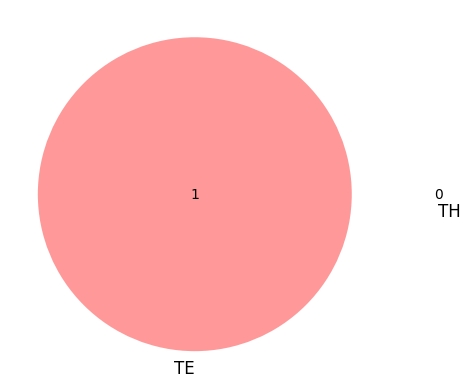

In [166]:
# REAC
venn_diagram(TE_reac.name.values, TH_reac.name.values, labels = ["TE", "TH"])

Rien de concluant

# cDC2
[//]: # (-.- .tabset .tabset-pills)

In [167]:
adata_cDC2 = adata[adata.obs['Population'].isin(['cDC2']), :].raw.to_adata().copy()
adata_cDC2


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(


AnnData object with n_obs × n_vars = 6292 × 25572
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Experiment_ID', 'Stage', 'New_Cell_ID', 'Population', 'Mouse_ID', 'Week_post Cre_activation', 'Sub_class_Stage', 'Mammary_glands', 'mouse_age_(Week)', 'new_orig'
    var: 'features', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'Stage_colors', 'neighbors', 'umap', 'new_orig_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


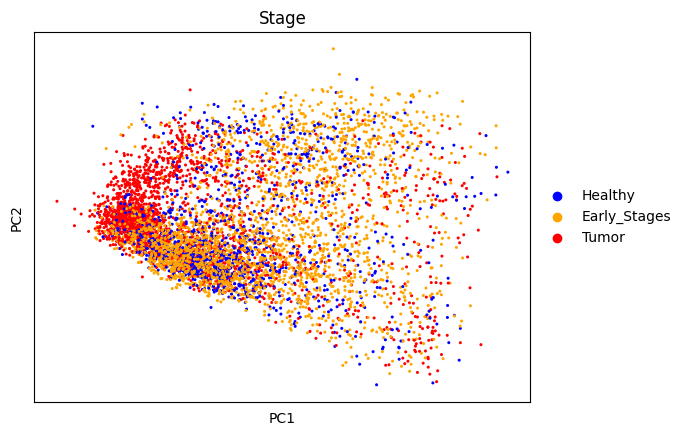

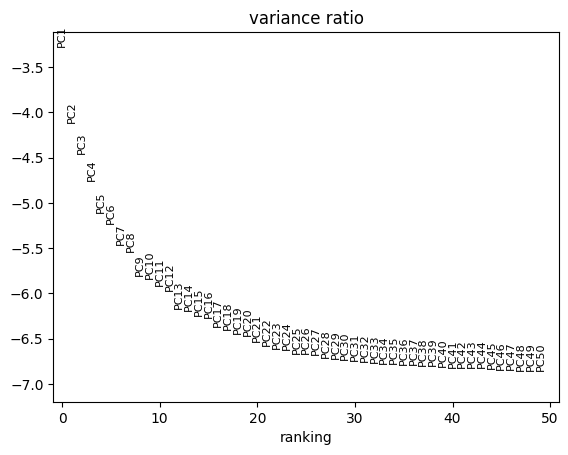

In [168]:
adata_cDC2 = sf.pp_PCA(adata_cDC2) # Function defined in scFunction.py

# Normalize, Log-transform, select HVG, scale data and perform PCA
sc.pl.pca(adata_cDC2, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_cDC2, log=True, n_pcs = 50) #ndim = 20

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


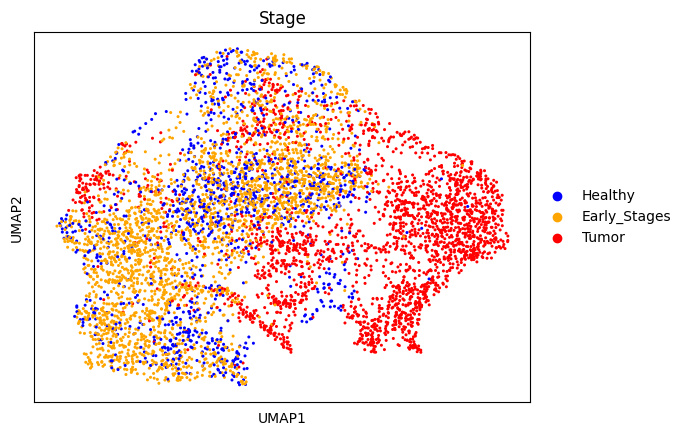

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


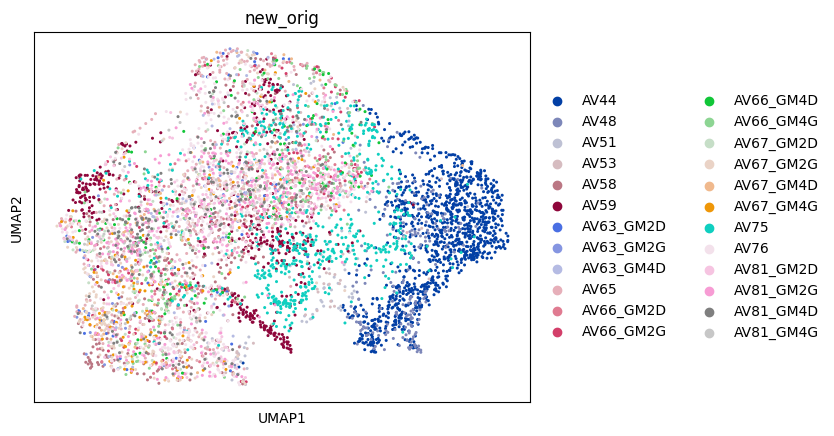

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


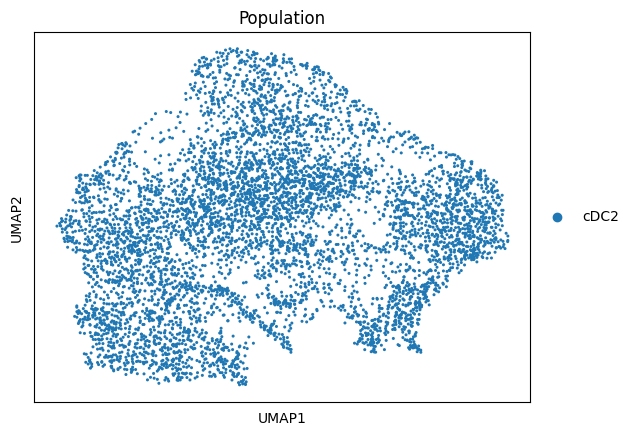

In [169]:
sc.pp.neighbors(adata_cDC2, n_pcs=20)
sc.tl.umap(adata_cDC2)
sc.pl.umap(adata_cDC2, color = 'Stage')
sc.pl.umap(adata_cDC2, color = 'new_orig')
sc.pl.umap(adata_cDC2, color = 'Population')

### Regress cycle

In [170]:
cell_cycle_genes = [x.strip().capitalize() for x in open('../data/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_cDC2.var_names]

sc.tl.score_genes_cell_cycle(adata_cDC2, s_genes=s_genes, g2m_genes=g2m_genes)

sc.pp.regress_out(adata_cDC2, ['S_score', 'G2M_score'])
sc.pp.scale(adata_cDC2)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    472 total control genes are used. (0:00:00)
computing score 'G2M_score'


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'G2M_score', score of gene set (adata.obs).
    684 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)
regressing out ['S_score', 'G2M_score']
    finished (0:00:13)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


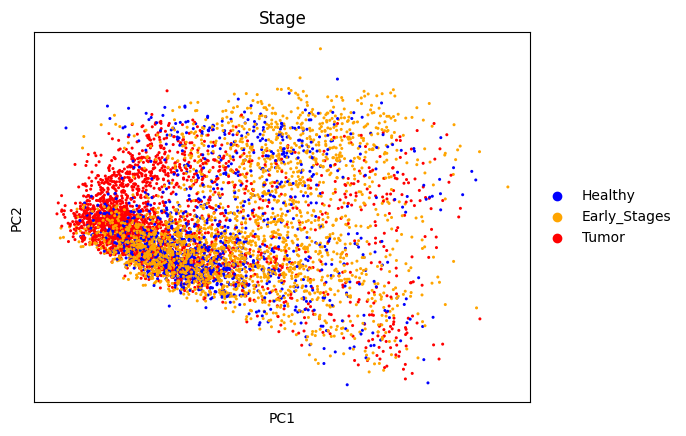

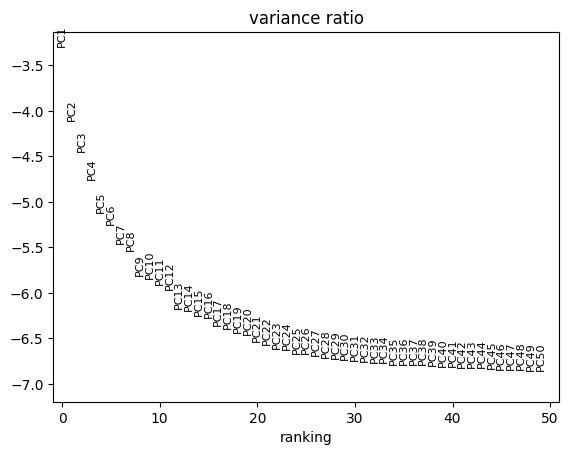

In [171]:
sc.tl.pca(adata_cDC2)
sc.pl.pca(adata_cDC2, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_cDC2, log=True, n_pcs = 50) #ndim = 20

## Sans harmony

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


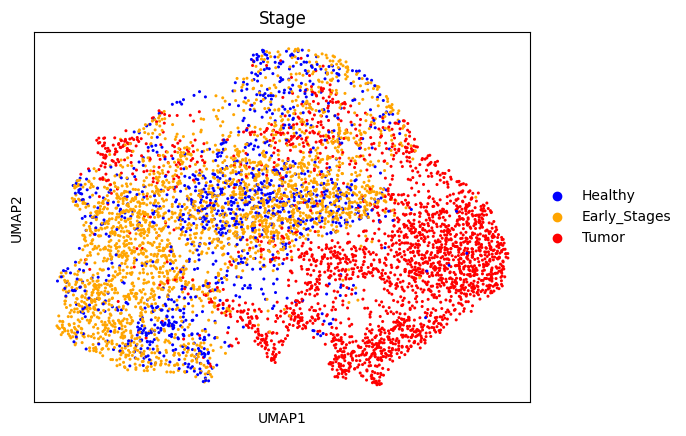

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


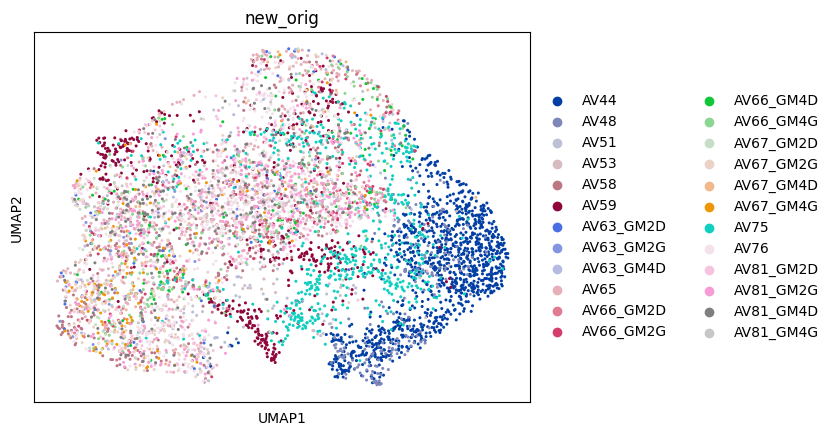

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


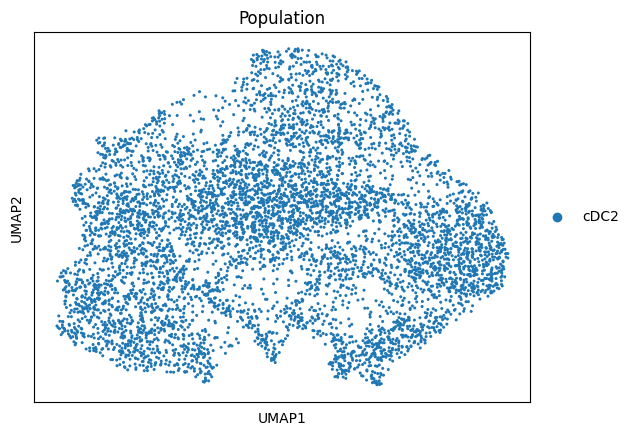

In [172]:
sc.pp.neighbors(adata_cDC2, n_pcs=20)
sc.tl.umap(adata_cDC2)
sc.pl.umap(adata_cDC2, color = 'Stage')
sc.pl.umap(adata_cDC2, color = 'new_orig')
sc.pl.umap(adata_cDC2, color = 'Population')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 9 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


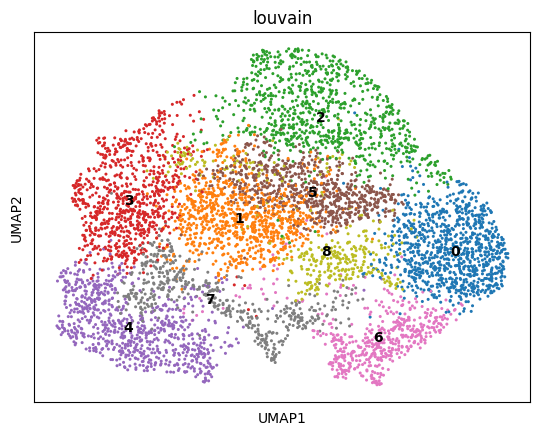

In [173]:
sc.tl.louvain(adata_cDC2, resolution = 0.8)
sc.pl.umap(adata_cDC2, color = 'louvain', legend_loc = 'on data')

computing density on 'umap'
--> added
    'umap_density_Stage', densities (adata.obs)
    'umap_density_Stage_params', parameter (adata.uns)


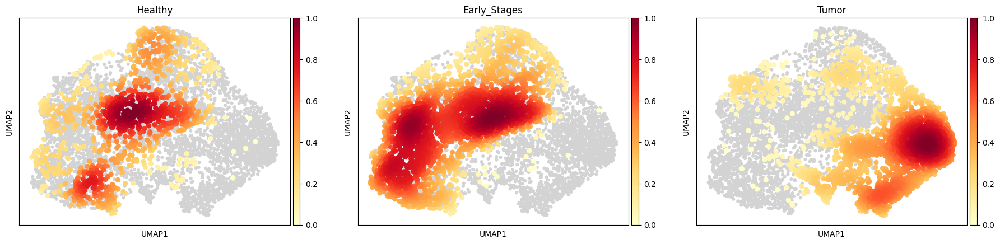

In [174]:
sc.tl.embedding_density(adata_cDC2, groupby="Stage")
sc.pl.embedding_density(adata_cDC2, groupby="Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


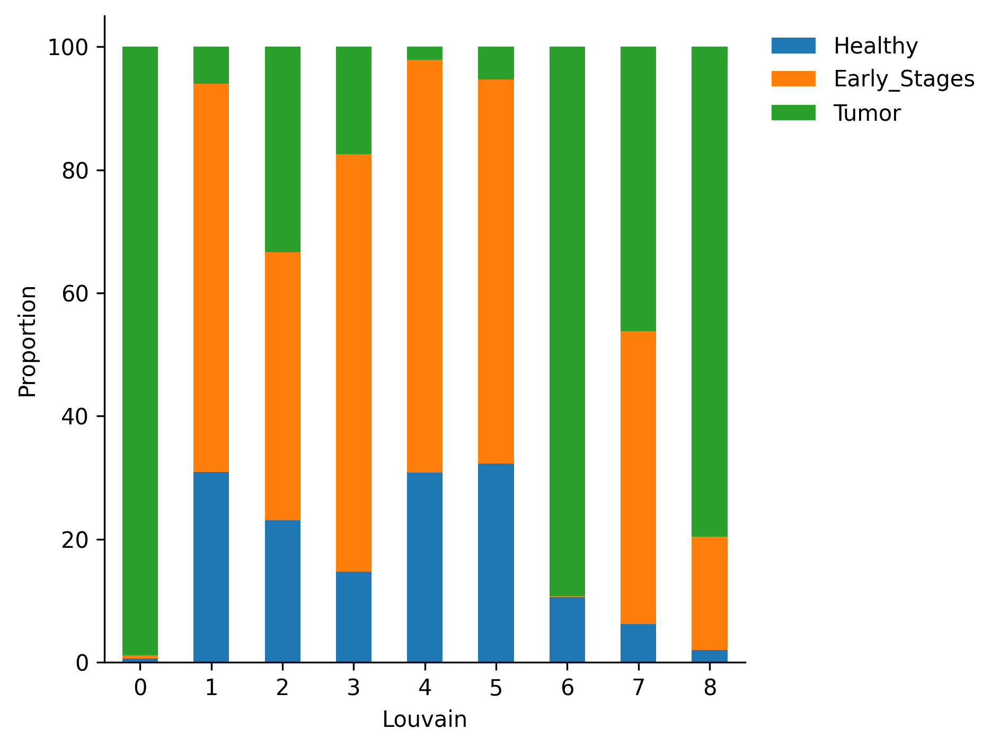

In [175]:
Stage_by_cluster = sf.get_cluster_proportions(adata_cDC2, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


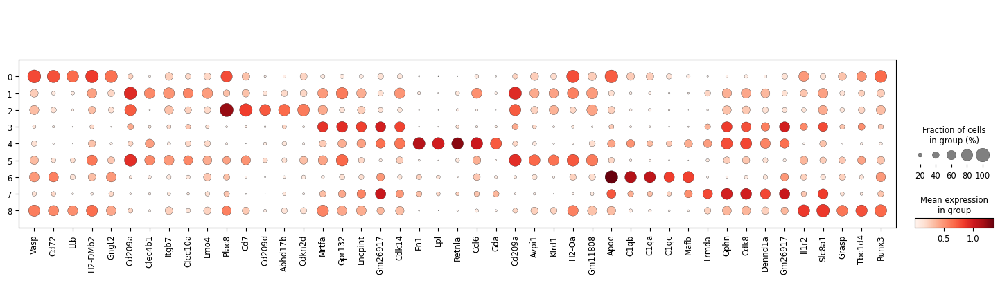

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


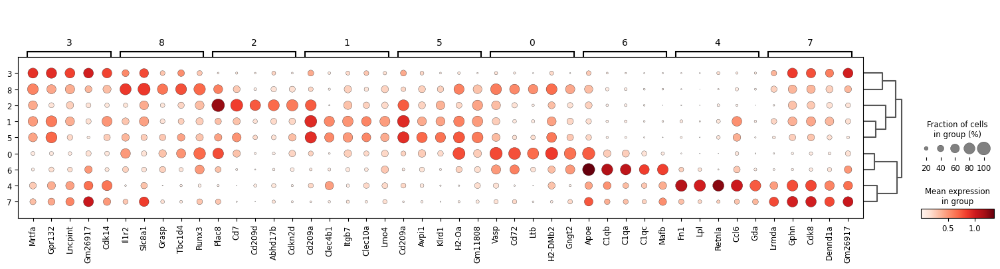

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Stage']`
categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


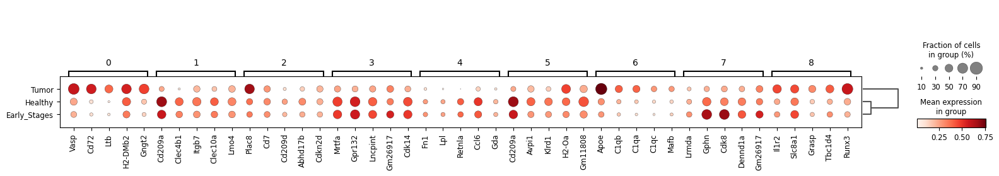

In [176]:
sc.tl.rank_genes_groups(adata_cDC2, "louvain")
sc.tl.filter_rank_genes_groups(adata_cDC2, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_percent = 25 and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_cDC2.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_cDC2, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_cDC2, genes, groupby="louvain")
sc.pl.rank_genes_groups_dotplot(adata_cDC2, key = "rank_genes_groups_filtered", n_genes= 5 )
sc.pl.rank_genes_groups_dotplot(adata_cDC2, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

## Integration avec harmony

2024-05-03 15:24:40,774 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-03 15:24:43,310 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-03 15:24:43,340 - harmonypy - INFO - Iteration 1 of 10
2024-05-03 15:24:44,531 - harmonypy - INFO - Iteration 2 of 10
2024-05-03 15:24:45,903 - harmonypy - INFO - Iteration 3 of 10
2024-05-03 15:24:47,298 - harmonypy - INFO - Iteration 4 of 10
2024-05-03 15:24:48,120 - harmonypy - INFO - Iteration 5 of 10
2024-05-03 15:24:49,182 - harmonypy - INFO - Iteration 6 of 10
2024-05-03 15:24:50,254 - harmonypy - INFO - Iteration 7 of 10
2024-05-03 15:24:50,925 - harmonypy - INFO - Iteration 8 of 10
2024-05-03 15:24:51,470 - harmonypy - INFO - Iteration 9 of 10
2024-05-03 15:24:52,008 - harmonypy - INFO - Iteration 10 of 10
2024-05-03 15:24:52,592 - harmonypy - INFO - Stopped before convergence


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


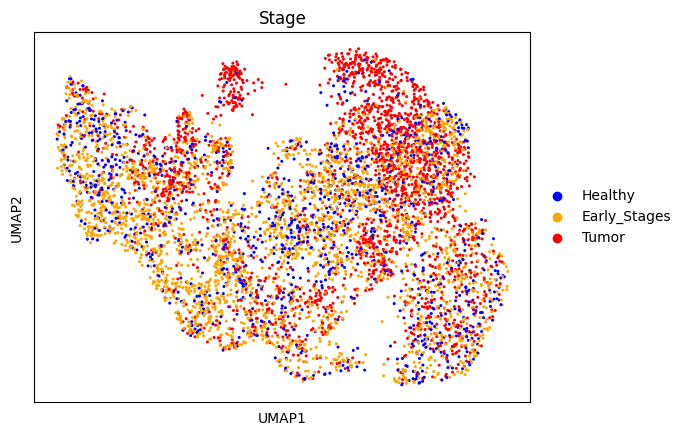

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


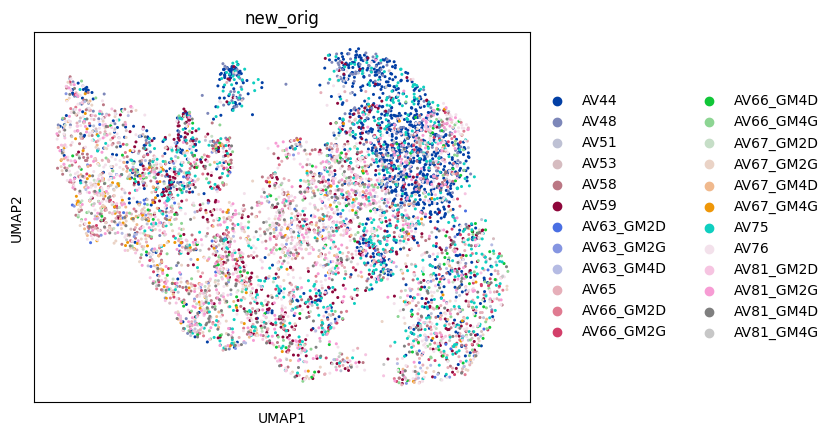

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


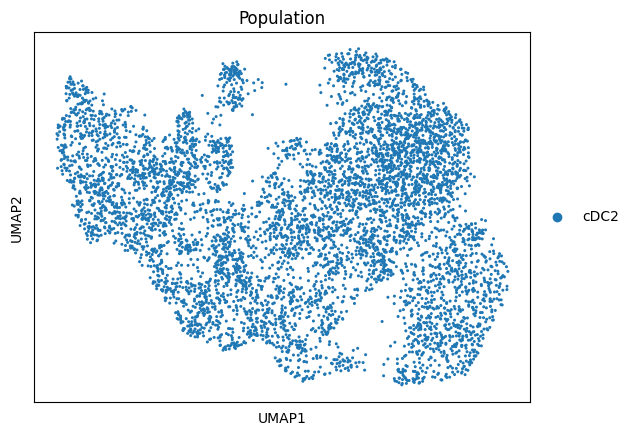

In [177]:
sc.external.pp.harmony_integrate(adata_cDC2, 'orig.ident')

sc.pp.neighbors(adata_cDC2, n_pcs=20, use_rep = "X_pca_harmony")
sc.tl.umap(adata_cDC2)
sc.pl.umap(adata_cDC2, color = 'Stage')
sc.pl.umap(adata_cDC2, color = 'new_orig')
sc.pl.umap(adata_cDC2, color = 'Population')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


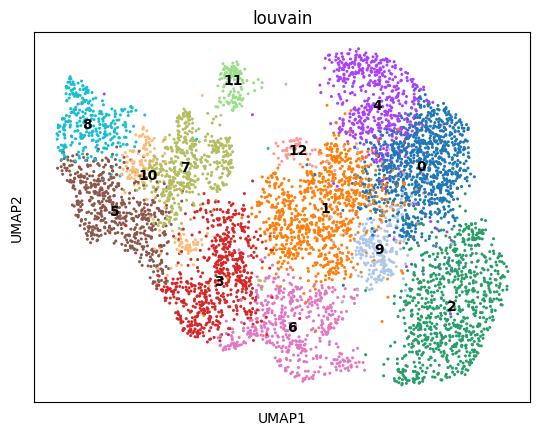

In [178]:
sc.tl.louvain(adata_cDC2)
sc.pl.umap(adata_cDC2, color = 'louvain', legend_loc = 'on data')

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


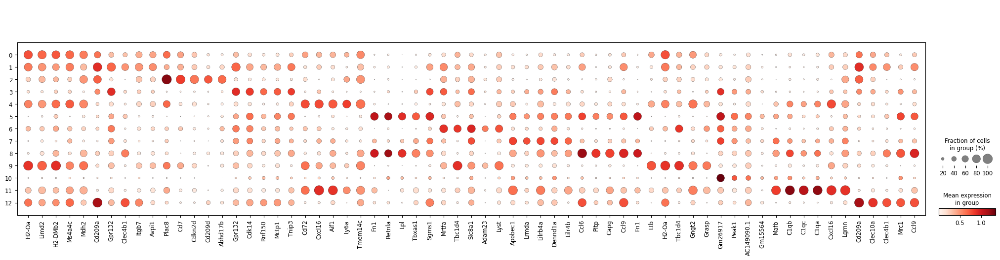

Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


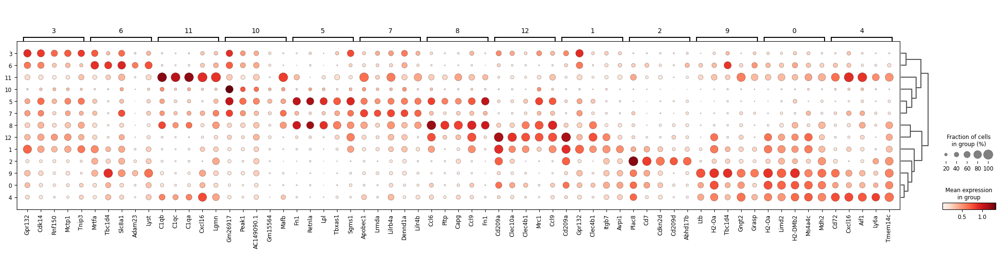

categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


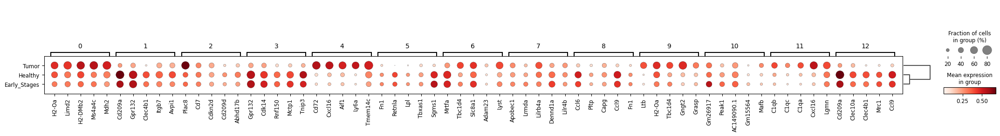

In [179]:
sc.tl.rank_genes_groups(adata_cDC2, "louvain")
sc.tl.filter_rank_genes_groups(adata_cDC2, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_in = 25% and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_cDC2.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_cDC2, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_cDC2, genes, groupby="louvain")
sc.tl.dendrogram(adata_cDC2, use_rep="X_pca_harmony", groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_cDC2, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_cDC2, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


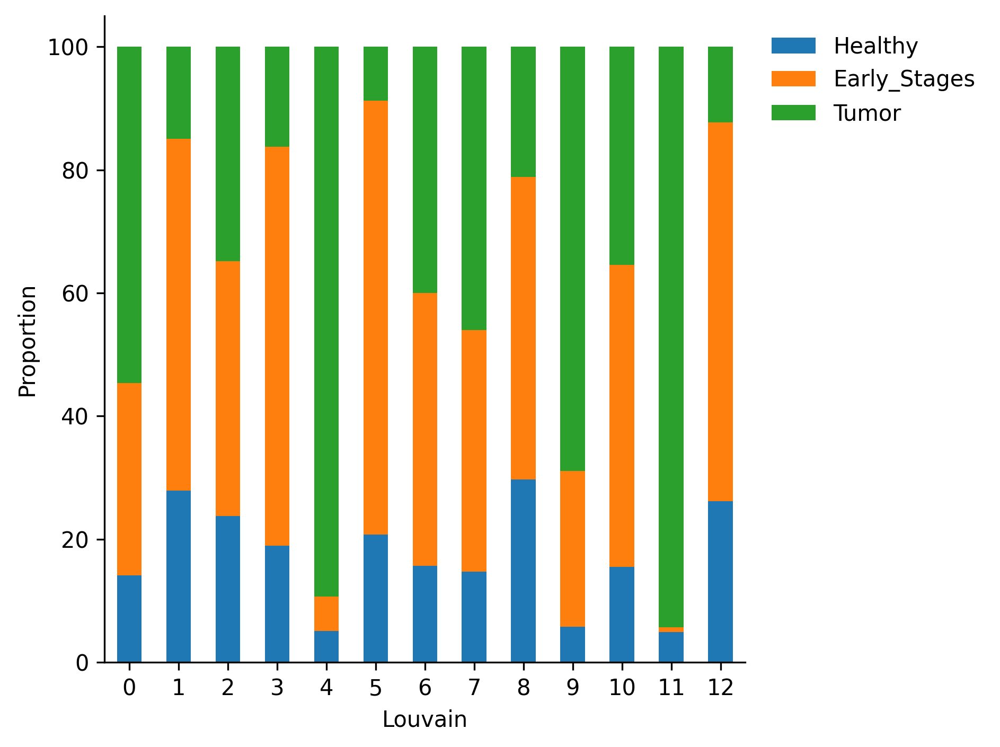

In [180]:
Stage_by_cluster = sf.get_cluster_proportions(adata_cDC2, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

# Signature cDC2 et MoMAC/MoDC

In [181]:
cDC2_signature = ["Clec4a4", "Dpp4", "H2-Aa", "H2-Eb1", "Klri1", "Kmo", "Ltb", "Nav1", "Pkib", "Ppp1r14a", "Relb", "Rogdi",
                 "Tspan13", "Ube2e2", "Zbtb46"]

Mo_Mac_MoDC_signature = ["C1qa", "C1qb", "C1qc", "Klra2", "Ly6i", "Lyz2",
                        "Mafb", "Ms4a6d", "Siglec1", "Spic", "Vcam1"]

sc.tl.score_genes(adata_DC, cDC2_signature, score_name="score_cDC2")
sc.tl.score_genes(adata_DC, Mo_Mac_MoDC_signature, score_name="score_Mo_Mac_MoDC")

sc.tl.score_genes(adata_cDC2, cDC2_signature, score_name="score_cDC2")
sc.tl.score_genes(adata_cDC2, Mo_Mac_MoDC_signature, score_name="score_Mo_Mac_MoDC")

computing score 'score_cDC2'
    finished: added
    'score_cDC2', score of gene set (adata.obs).
    350 total control genes are used. (0:00:00)
computing score 'score_Mo_Mac_MoDC'


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'score_Mo_Mac_MoDC', score of gene set (adata.obs).
    450 total control genes are used. (0:00:00)
computing score 'score_cDC2'


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'score_cDC2', score of gene set (adata.obs).
    299 total control genes are used. (0:00:00)
computing score 'score_Mo_Mac_MoDC'


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'score_Mo_Mac_MoDC', score of gene set (adata.obs).
    399 total control genes are used. (0:00:00)


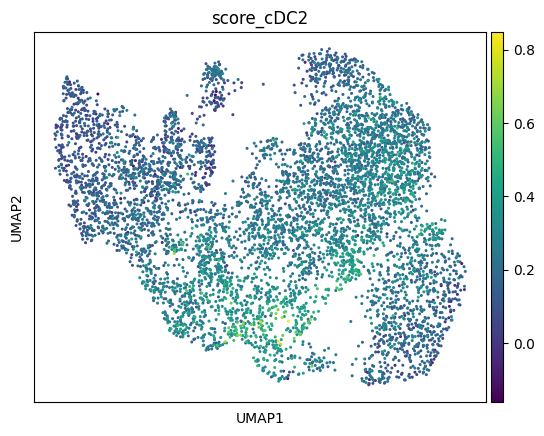

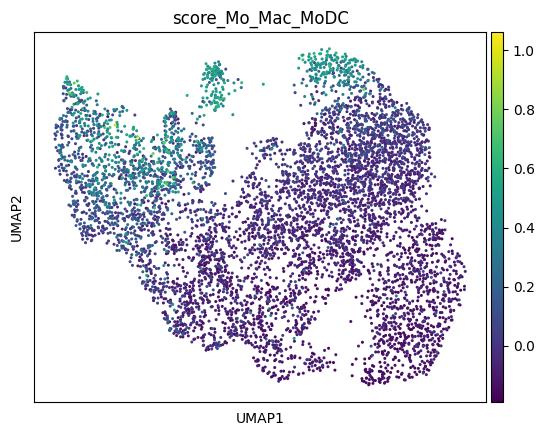

In [182]:
sc.pl.umap(adata_cDC2, color = 'score_cDC2')
sc.pl.umap(adata_cDC2, color = "score_Mo_Mac_MoDC")

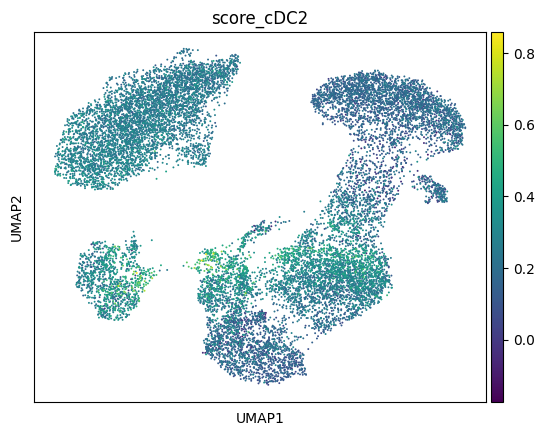

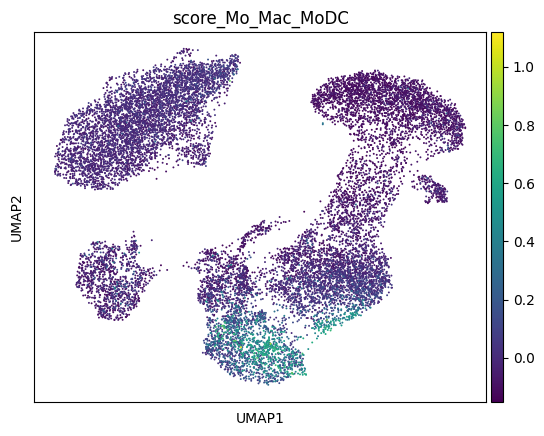

In [183]:
sc.pl.umap(adata_DC, color = 'score_cDC2')
sc.pl.umap(adata_DC, color = "score_Mo_Mac_MoDC")

Pour l'instant on va garder toutes les cellules "cDC2" même si on a surement des MoMac

# Early cDC2 vs Healthy cDC2
[//]: # (-.- .tabset .tabset-pills)

In [184]:
# DEG Tumor vs Healthy/Prénéo

sc.tl.rank_genes_groups(adata_cDC2, "Stage", groups = ["Early_Stages"], reference = "Healthy", key_added = "early_vs_healthy")
sc.tl.filter_rank_genes_groups(adata_cDC2, key = "early_vs_healthy", key_added = "early_vs_healthy_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['early_vs_healthy']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [185]:
df = sc.get.rank_genes_groups_df(adata_cDC2, group = "Early_Stages", key = "early_vs_healthy_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [186]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [187]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [188]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

62 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
12,4930404I05Rik,10.763637,1.964225,1.221390e-26,1.156792e-23,22.936745,UP
32,Gm36199,8.045229,1.581116,1.144666e-15,2.217530e-13,12.654131,UP
10,B930036N10Rik,10.788010,1.470722,1.035536e-26,1.018490e-23,22.992043,UP
9,Gm44710,11.509295,1.376602,4.082740e-30,5.220191e-27,26.282314,UP
20,Ildr1,9.503860,1.352460,3.711384e-21,1.608602e-18,17.793551,UP
0,Cdk8,20.357857,1.304438,1.958829e-86,5.009118e-82,81.300239,UP
39,Cubn,7.588967,1.256510,4.149491e-14,6.029022e-12,11.219753,UP
27,Gm30198,8.382798,1.233275,7.486682e-17,1.664778e-14,13.778644,UP
35,Gm29282,7.840750,1.233018,5.986308e-15,9.750438e-13,12.010976,UP
3,Gm20513,16.289141,1.214014,2.946955e-57,1.883988e-53,52.724922,UP


    DOWN-regulated genes

In [189]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

71 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25570,Hsph1,-14.517361,-1.730756,6.602151e-45,1.875891e-41,40.726792,DOWN
25427,Arl13b,-7.365751,-0.985475,2.676400e-13,3.546161e-11,10.450242,DOWN
25434,Sdc4,-7.568086,-0.943756,5.982363e-14,8.594438e-12,11.065783,DOWN
25527,Dnajb1,-9.382554,-0.865842,1.766764e-20,6.743238e-18,17.171131,DOWN
25473,Pvr,-8.086069,-0.864726,1.094028e-15,2.152038e-13,12.667150,DOWN
25439,Ahsa1,-7.651939,-0.829914,3.130334e-14,4.654006e-12,11.332173,DOWN
25293,Dynlt1f,-6.026885,-0.824472,1.996813e-09,1.426327e-07,6.845781,DOWN
25485,Smpdl3a,-8.432451,-0.803799,6.607271e-17,1.482115e-14,13.829118,DOWN
25281,Itga5,-5.947969,-0.803241,3.226941e-09,2.214750e-07,6.654675,DOWN
25500,Bcl2a1d,-8.735209,-0.795593,5.255450e-18,1.385488e-15,14.858397,DOWN


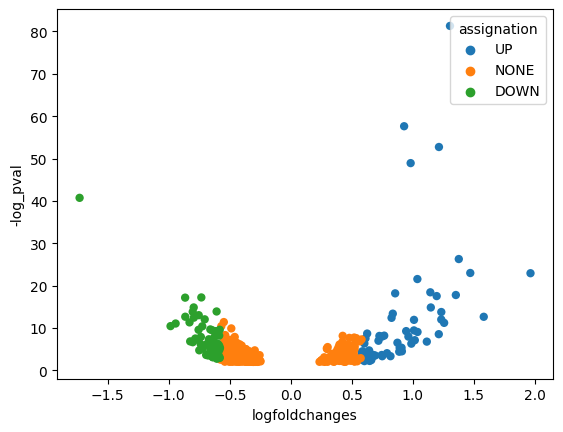

In [190]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [191]:
up_Early_vs_Healthy_cDC2 = list(df_up["names"].values)

In [192]:
df_enrich = sc.queries.enrich(up_Early_vs_Healthy_cDC2,org = "mmusculus")

In [193]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

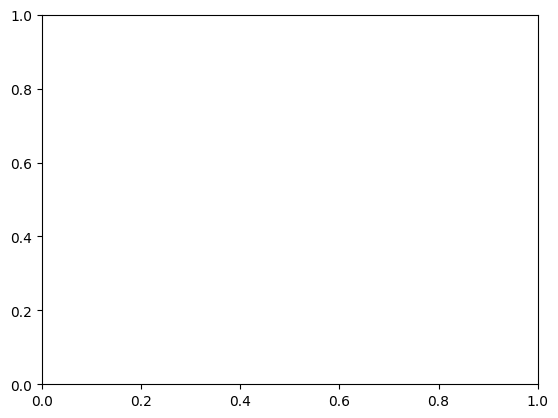

In [194]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

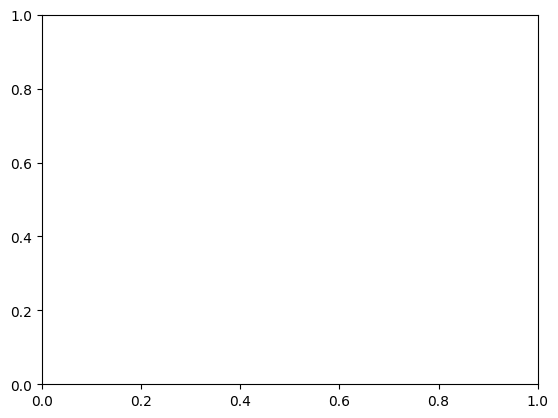

In [195]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

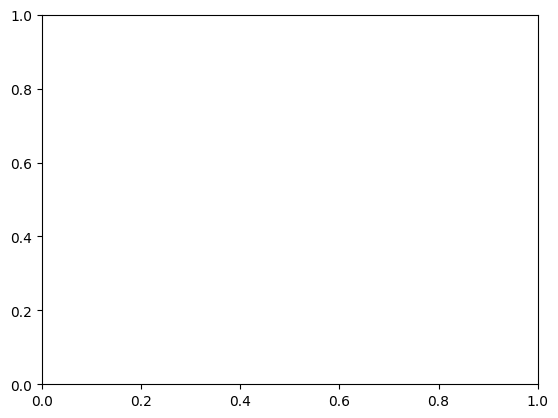

In [196]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: >

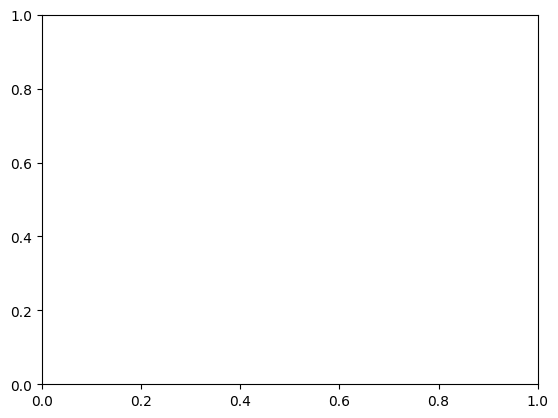

In [197]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [198]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

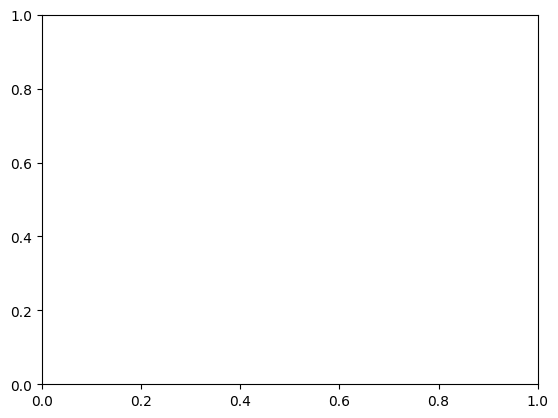

In [199]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

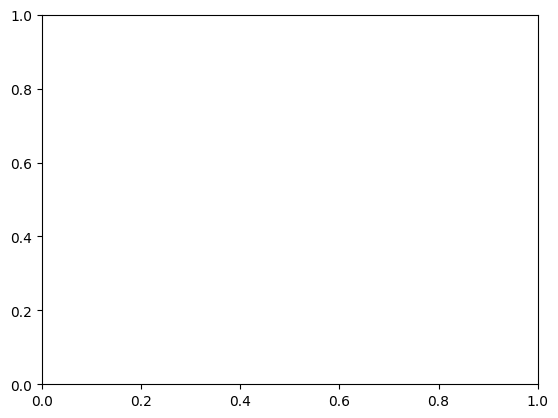

In [200]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

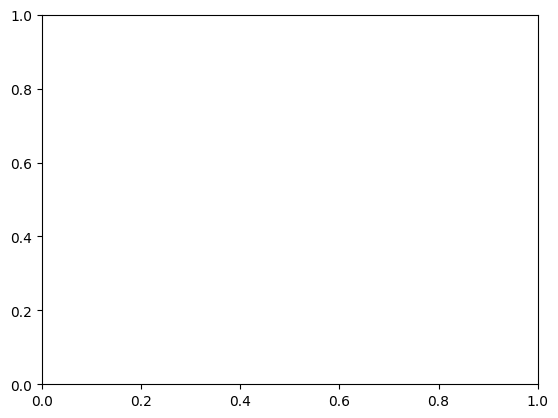

In [201]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [202]:
down_Early_vs_Healthy_cDC2 = list(df_down["names"].values)

In [203]:
df_enrich = sc.queries.enrich(down_Early_vs_Healthy_cDC2,org = "mmusculus")

In [204]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

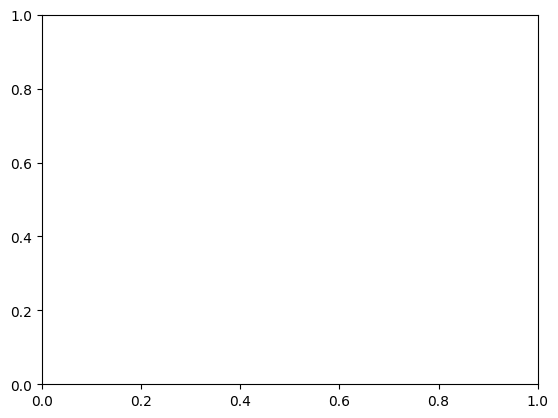

In [205]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

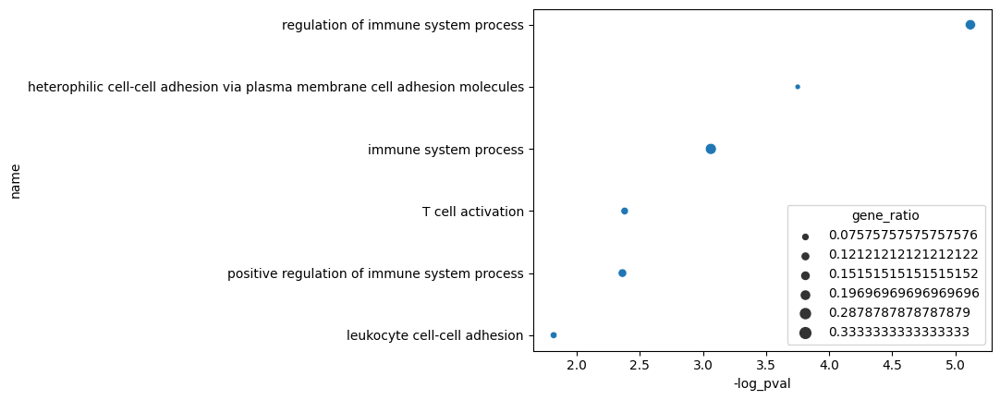

In [206]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

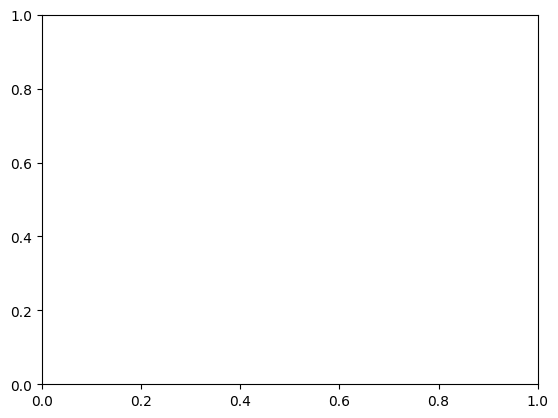

In [207]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

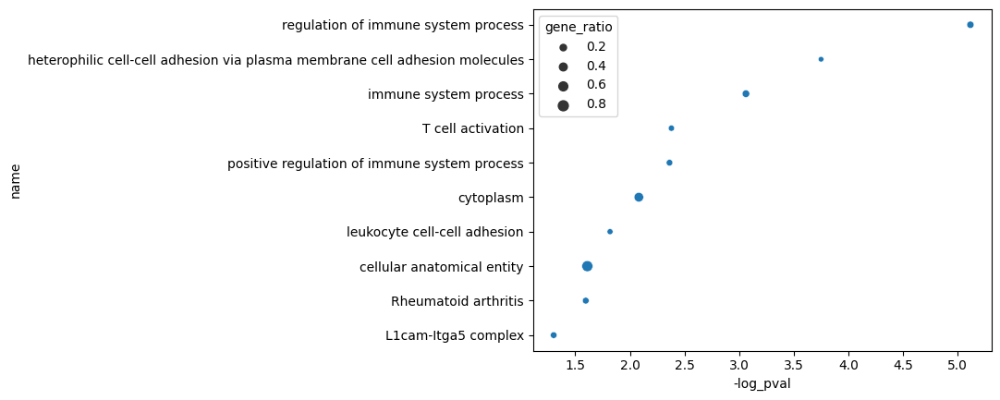

In [208]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [209]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

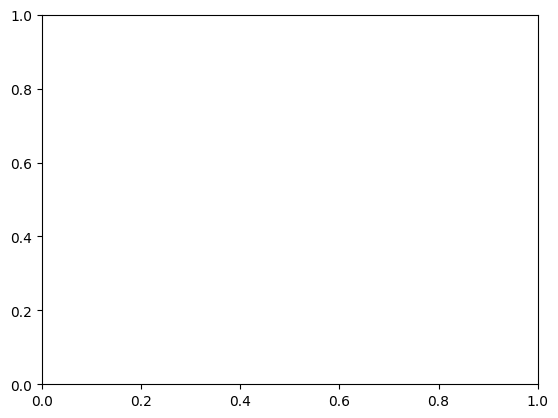

In [210]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

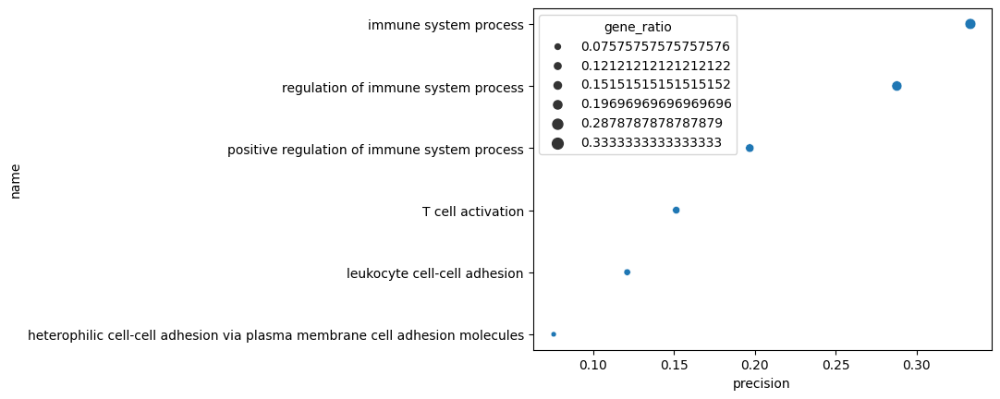

In [211]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

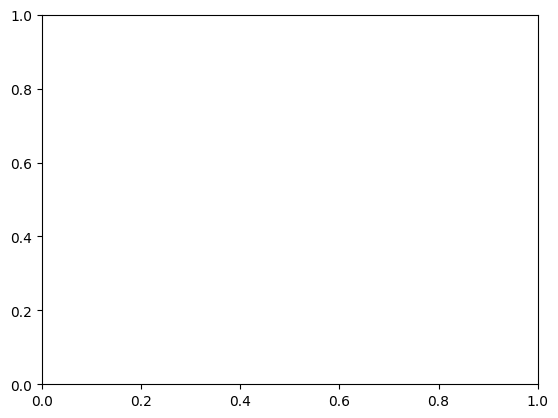

In [212]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

# Tumor cDC2 vs Healthy/Prénéo cDC2
[//]: # (-.- .tabset .tabset-pills)

In [213]:
is_tumor = ["Tumor" if i == "Tumor" else "No_tumor" for i in adata_cDC2.obs["Stage"].values]

adata_cDC2.obs["is_tumor"] = is_tumor

In [214]:
# DEG Tumor vs Healthy/Prénéo


sc.tl.rank_genes_groups(adata_cDC2, "is_tumor", groups = ["Tumor"], reference = "No_tumor", key_added = "tumor_vs_others")
sc.tl.filter_rank_genes_groups(adata_cDC2, key = "tumor_vs_others", key_added = "tumor_vs_others_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['tumor_vs_others']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [215]:
df = sc.get.rank_genes_groups_df(adata_cDC2, group = "Tumor", key = "tumor_vs_others_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [216]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [217]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


In [218]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

1664 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
317,Tmem119,15.910636,6.795034,2.481736e-54,1.125230e-52,51.948759,UP
191,Ppm1j,18.497677,6.064227,1.148385e-71,8.342755e-70,69.078691,UP
26,Itgae,29.364279,5.827927,2.293531e-163,8.500025e-161,160.070580,UP
6,Cdh1,37.085438,5.708272,6.587143e-241,7.656656e-238,237.115961,UP
163,Gna14,19.303894,5.341585,1.327373e-77,1.077574e-75,74.967553,UP
11,Epcam,34.936333,4.810632,1.515283e-219,1.249962e-216,215.903103,UP
351,Htra3,15.560560,4.599503,2.585357e-52,1.080274e-50,49.966466,UP
53,Cldn1,25.162582,4.578405,3.537036e-125,7.294281e-123,122.137018,UP
30,Arhgap24,28.535749,4.546598,3.403228e-156,1.130225e-153,152.946835,UP
171,Ccr6,19.125626,4.475006,2.183616e-76,1.718136e-74,73.764942,UP


In [219]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

441 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25552,Mrc1,-32.146770,-2.562945,6.421336e-209,4.438011e-206,205.352812,DOWN
25537,Fgfr1,-28.518255,-2.418976,1.884592e-167,7.773029e-165,164.109410,DOWN
25527,Stxbp6,-26.955200,-2.282851,4.168127e-151,1.315893e-148,147.880779,DOWN
25541,Prkce,-29.436382,-2.196205,3.535356e-178,1.643748e-175,174.784165,DOWN
25513,Sept11,-24.785488,-2.019850,3.971692e-129,8.987973e-127,126.046338,DOWN
25534,Rnf150,-27.920416,-1.982205,1.553539e-161,5.675299e-159,158.246011,DOWN
25460,Abca9,-20.256880,-1.922344,2.318608e-88,2.390784e-86,85.621460,DOWN
25538,Tiam1,-28.644735,-1.920833,1.165766e-169,5.052708e-167,166.296476,DOWN
25456,Tpk1,-19.909885,-1.906604,1.857501e-85,1.792453e-83,82.746552,DOWN
25539,Ccl6,-28.805857,-1.881264,2.424481e-171,1.087699e-168,167.963491,DOWN


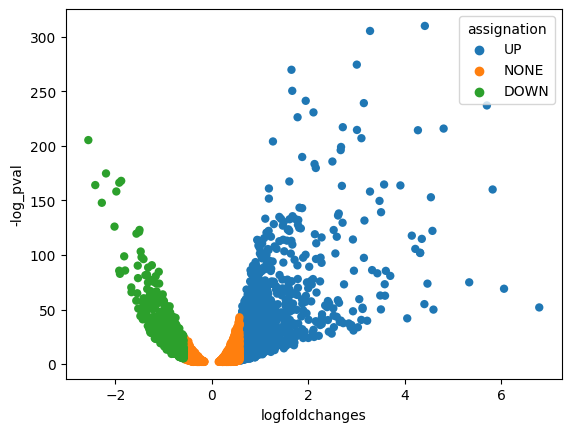

In [220]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [221]:
up_Tumor_vs_Others_cDC2 = list(df_up["names"].values)

In [222]:
df_enrich = sc.queries.enrich(up_Tumor_vs_Others_cDC2,org = "mmusculus")

In [223]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

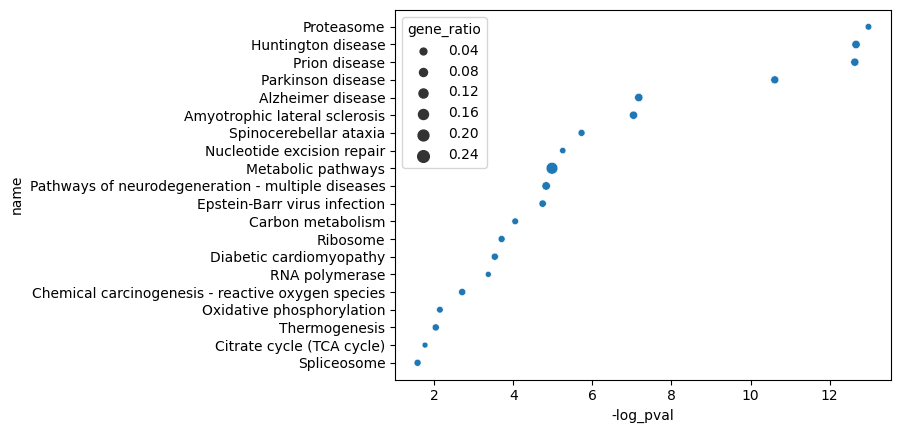

In [224]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

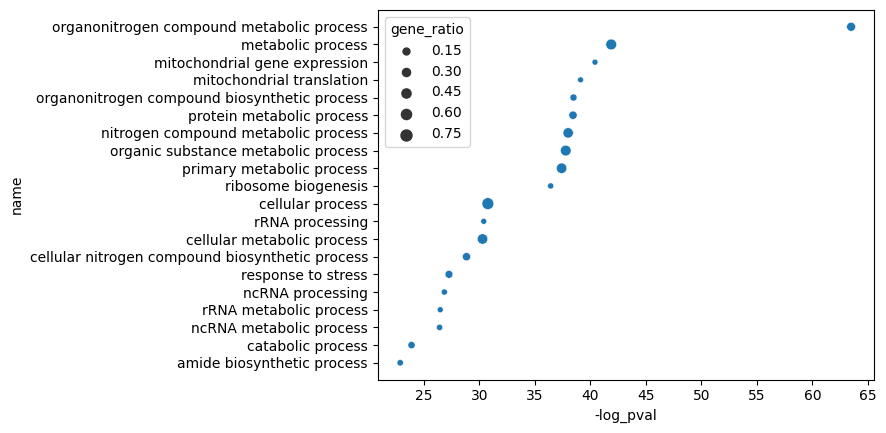

In [225]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

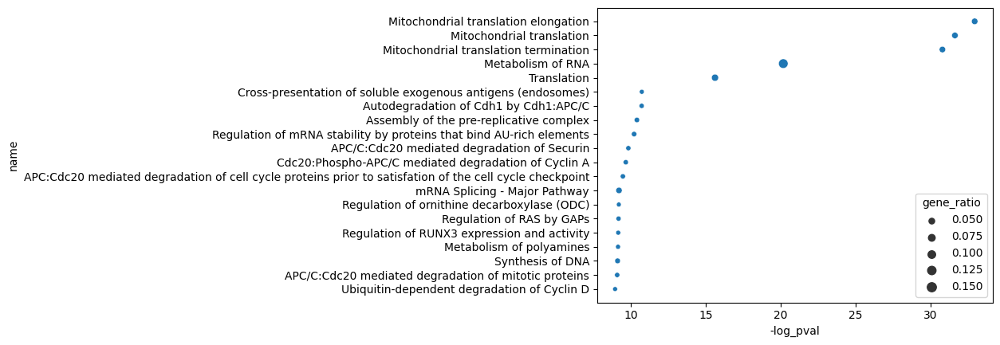

In [226]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All Databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

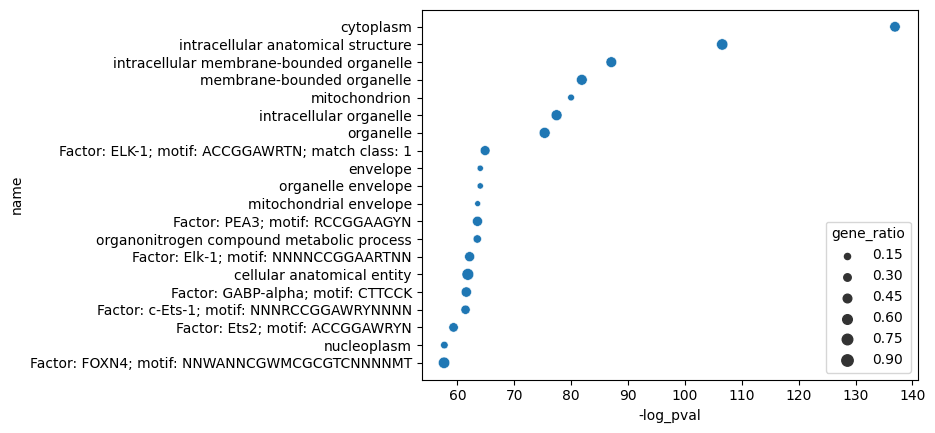

In [227]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [228]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

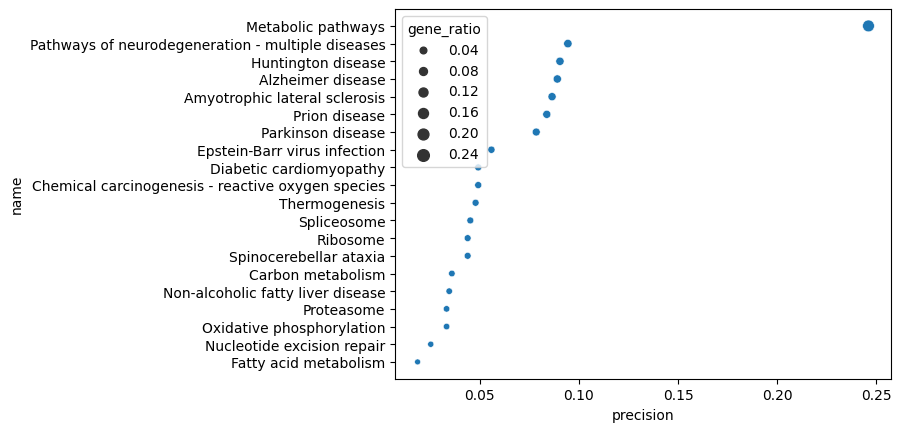

In [229]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

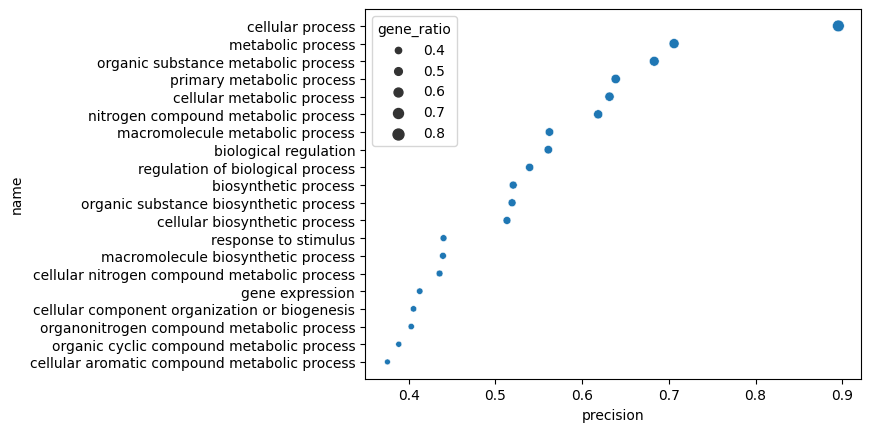

In [230]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

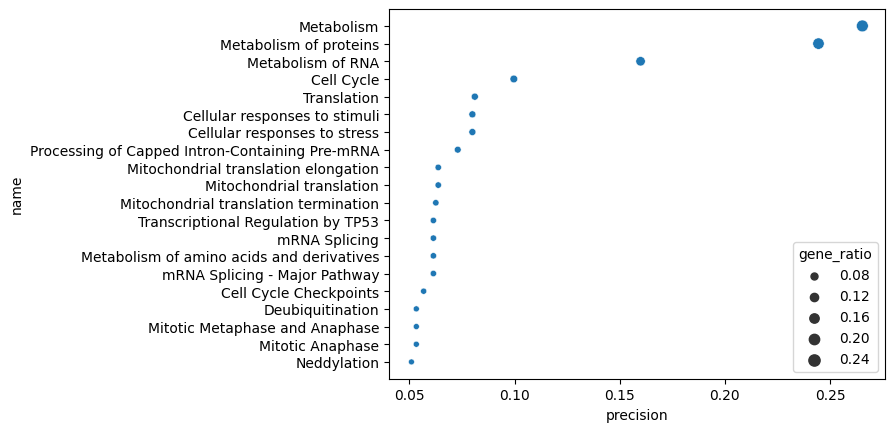

In [231]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [232]:
down_Tumor_vs_Others_cDC2 = list(df_down["names"].values)

In [233]:
df_enrich = sc.queries.enrich(down_Tumor_vs_Others_cDC2,org = "mmusculus")

In [234]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

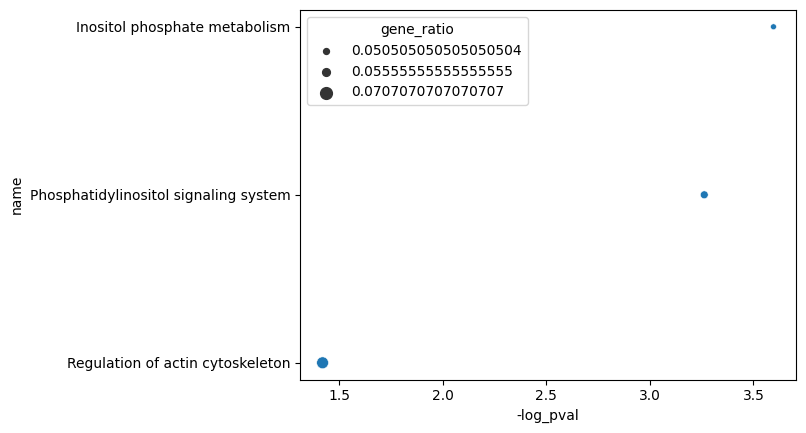

In [235]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

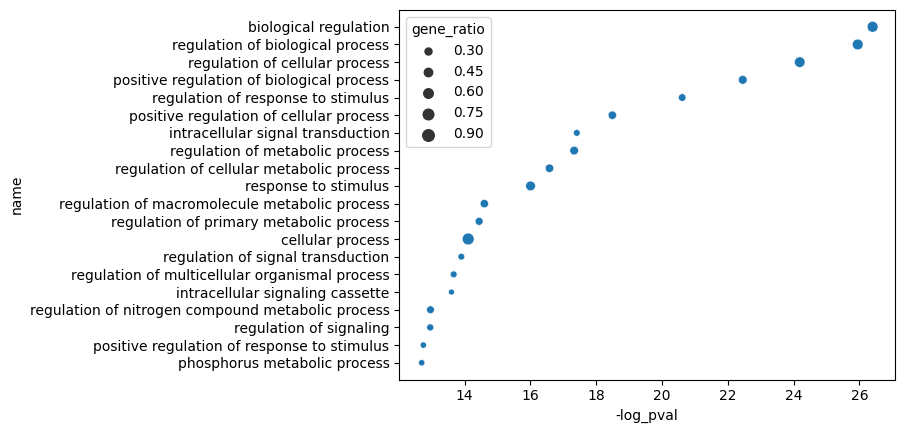

In [236]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

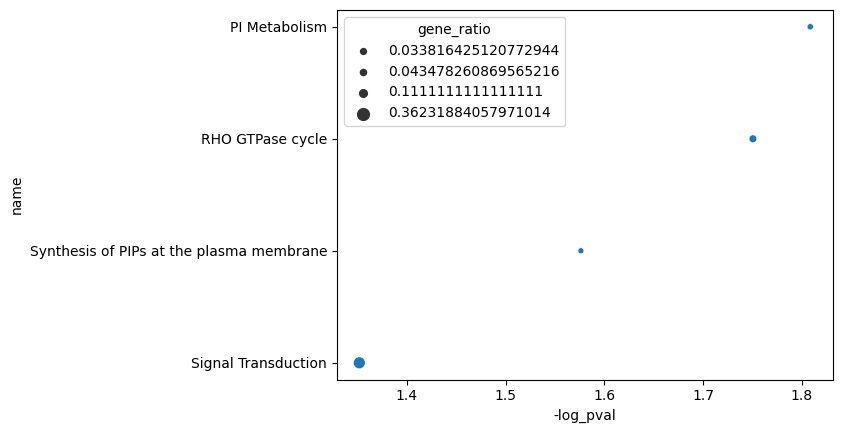

In [237]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All Databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

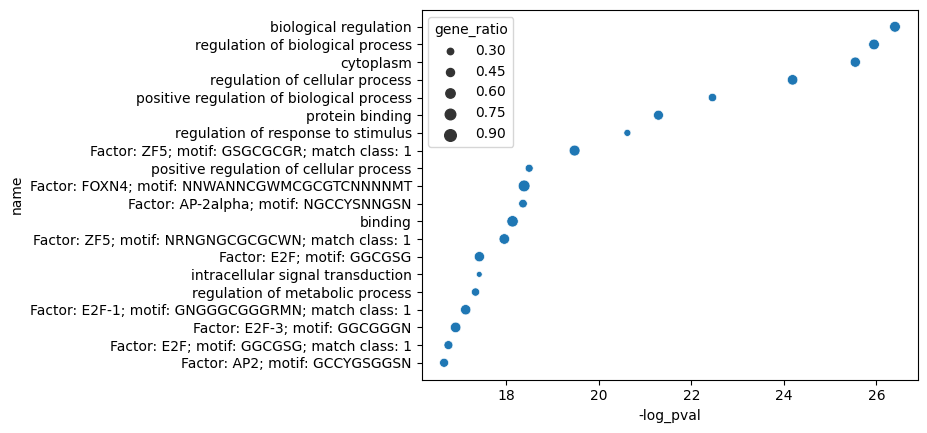

In [238]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

In [239]:
test = df_enrich.sort_values("precision", ascending = False)

### Precision
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

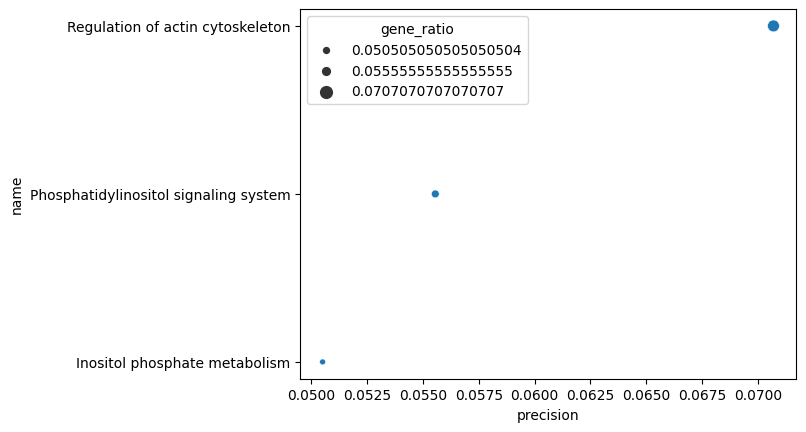

In [240]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

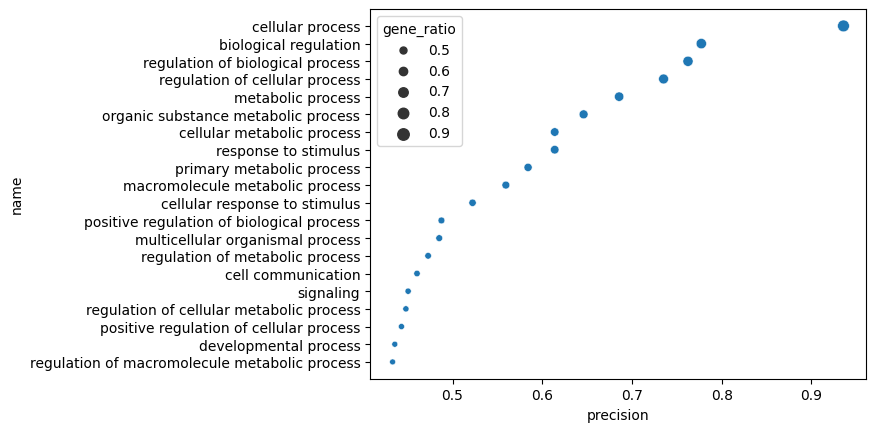

In [241]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

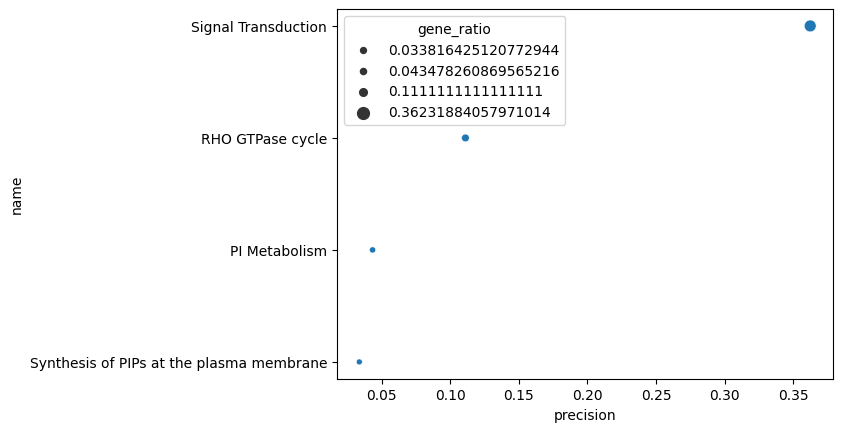

In [242]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

In [243]:
df_up.to_csv("../data/DEG_DC/up_cDC2_tumor_vs_others.csv")

In [244]:
df_down.to_csv("../data/DEG_DC/down_cDC2_tumor_vs_others.csv")

# pDC
[//]: # (-.- .tabset .tabset-pills)

In [245]:
adata_pDC = adata[adata.obs['Population'].isin(['pDC']), :].raw.to_adata().copy()
adata_pDC


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(


AnnData object with n_obs × n_vars = 3153 × 25572
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Experiment_ID', 'Stage', 'New_Cell_ID', 'Population', 'Mouse_ID', 'Week_post Cre_activation', 'Sub_class_Stage', 'Mammary_glands', 'mouse_age_(Week)', 'new_orig'
    var: 'features', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'Stage_colors', 'neighbors', 'umap', 'new_orig_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


    finished (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


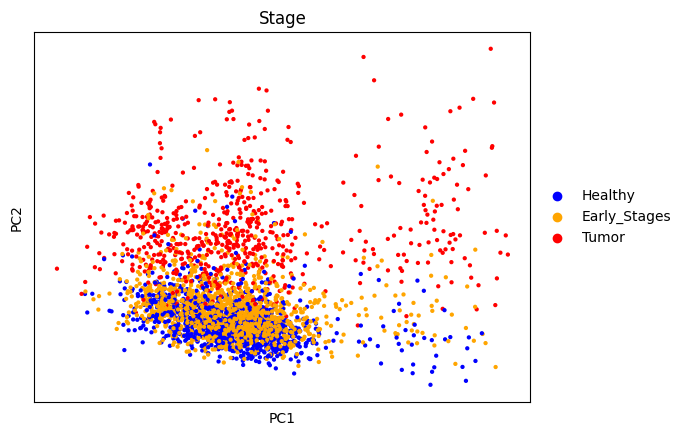

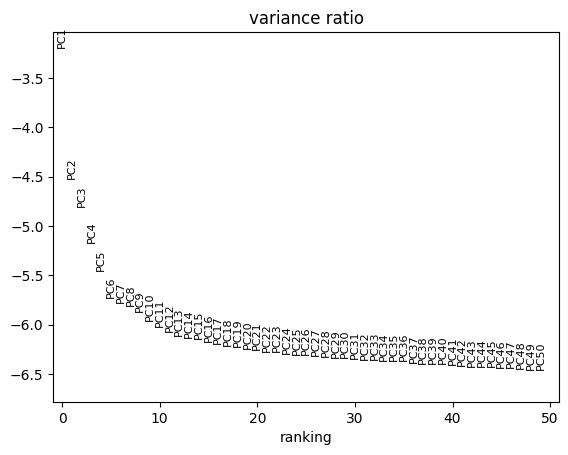

In [246]:
adata_pDC = sf.pp_PCA(adata_pDC) # Function defined in scFunction.py

# Normalize, Log-transform, select HVG, scale data and perform PCA
sc.pl.pca(adata_pDC, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_pDC, log=True, n_pcs = 50) #ndim = 20

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


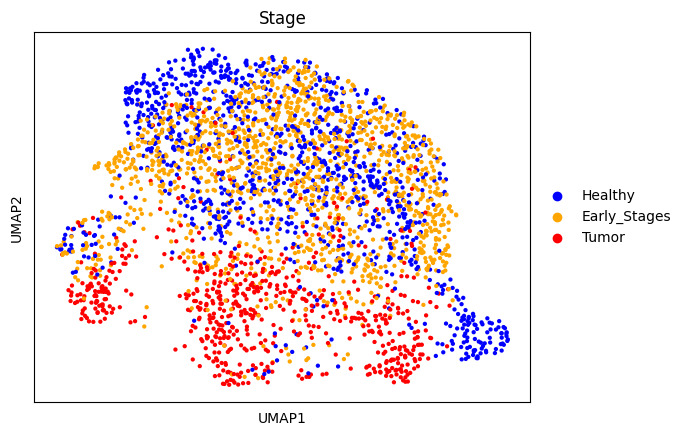

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


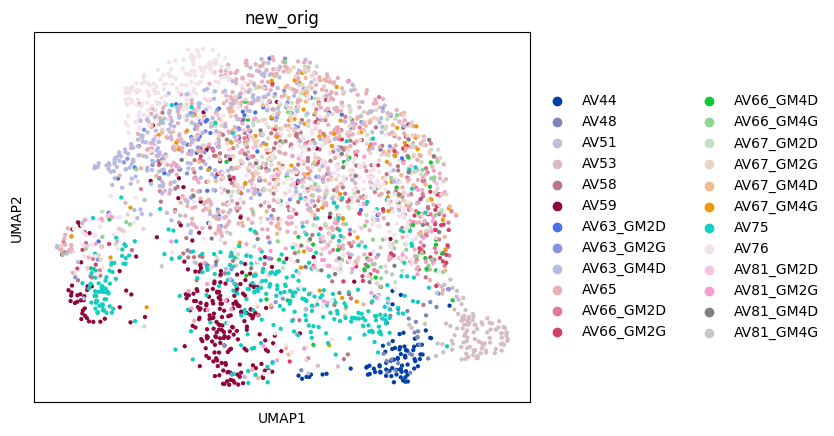

In [247]:
sc.pp.neighbors(adata_pDC, n_pcs=20)
sc.tl.umap(adata_pDC)
sc.pl.umap(adata_pDC, color = 'Stage')
sc.pl.umap(adata_pDC, color = 'new_orig')

### Regress cycle

In [248]:
cell_cycle_genes = [x.strip().capitalize() for x in open('../data/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_pDC.var_names]

sc.tl.score_genes_cell_cycle(adata_pDC, s_genes=s_genes, g2m_genes=g2m_genes)

sc.pp.regress_out(adata_pDC, ['S_score', 'G2M_score'])
sc.pp.scale(adata_pDC)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    602 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    643 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)
regressing out ['S_score', 'G2M_score']


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished (0:00:07)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


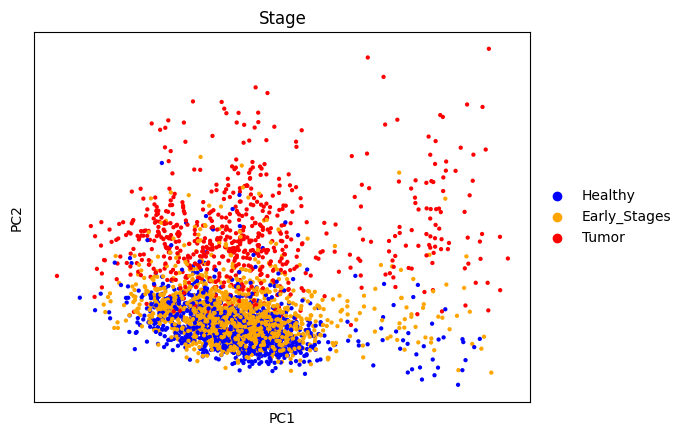

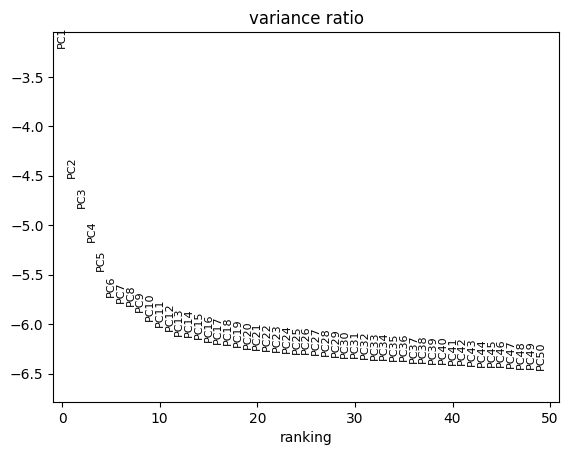

In [249]:
sc.tl.pca(adata_pDC)
sc.pl.pca(adata_pDC, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_pDC, log=True, n_pcs = 50) #ndim = 20

## Sans harmony

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


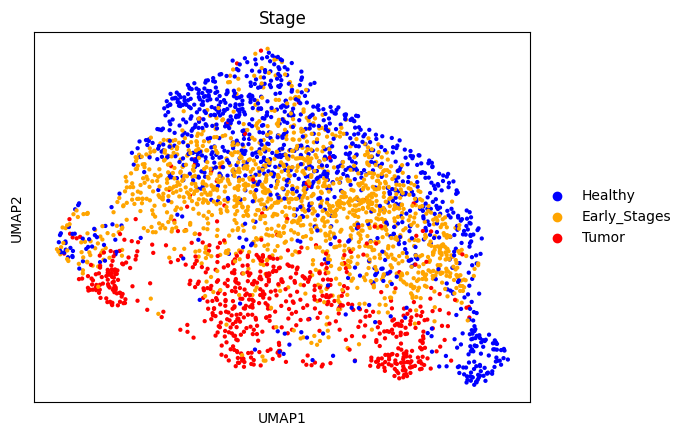

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


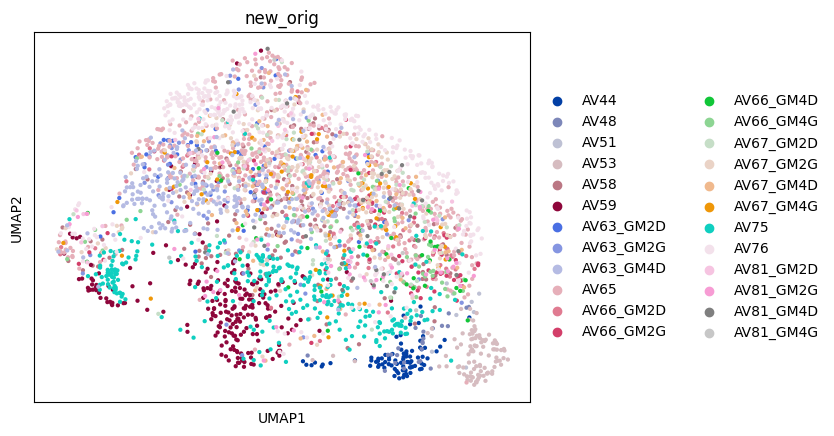

In [250]:
sc.pp.neighbors(adata_pDC, n_pcs=20)
sc.tl.umap(adata_pDC)
sc.pl.umap(adata_pDC, color = 'Stage')
sc.pl.umap(adata_pDC, color = 'new_orig')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 9 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


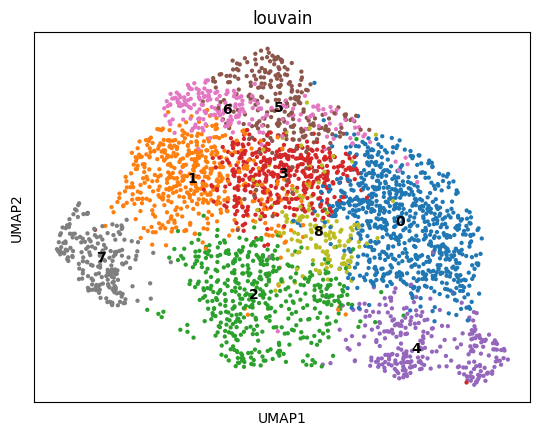

In [251]:
sc.tl.louvain(adata_pDC, resolution = 0.8)
sc.pl.umap(adata_pDC, color = 'louvain', legend_loc = 'on data')

computing density on 'umap'
--> added
    'umap_density_Stage', densities (adata.obs)
    'umap_density_Stage_params', parameter (adata.uns)


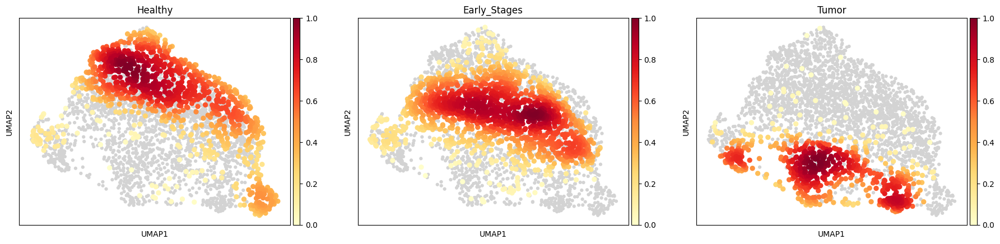

In [252]:
sc.tl.embedding_density(adata_pDC, groupby="Stage")
sc.pl.embedding_density(adata_pDC, groupby="Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


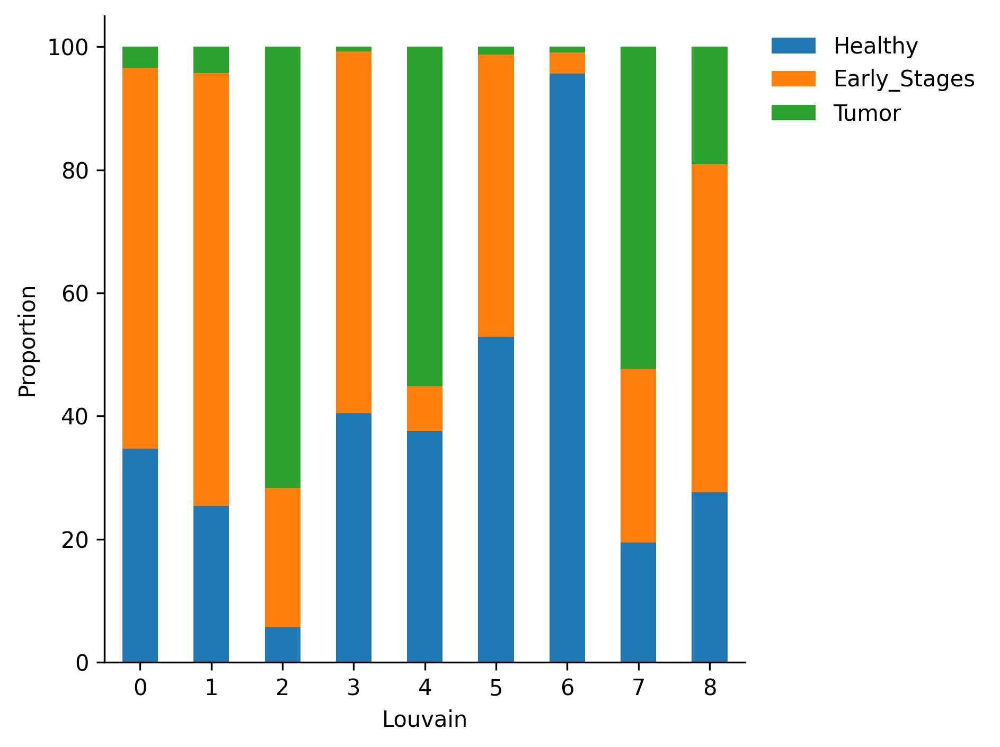

In [253]:
Stage_by_cluster = sf.get_cluster_proportions(adata_pDC, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


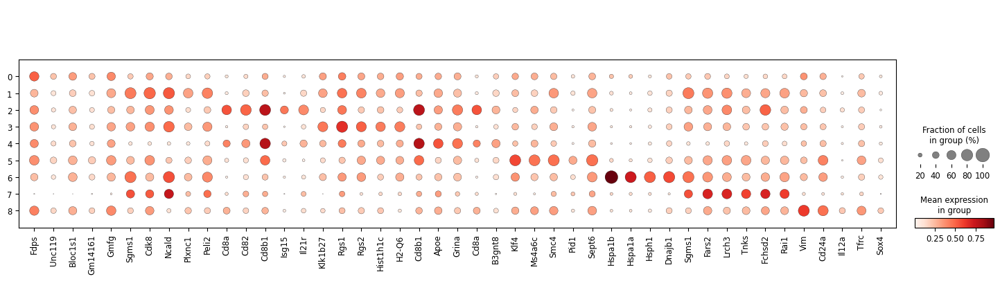

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


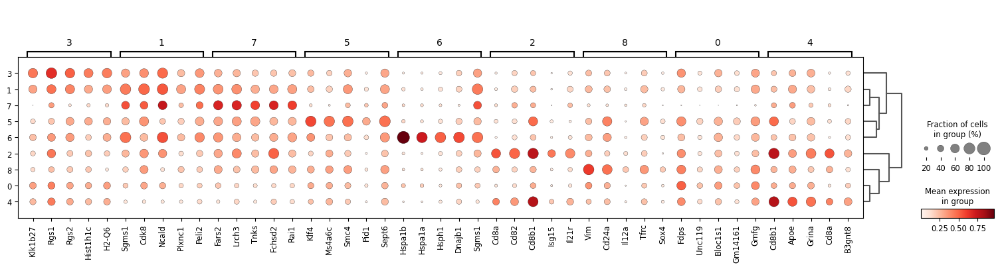

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Stage']`
categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


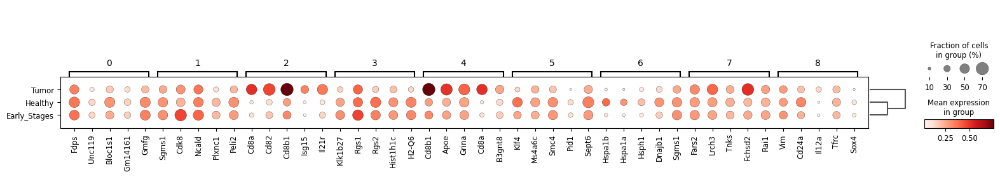

In [254]:
sc.tl.rank_genes_groups(adata_pDC, "louvain")
sc.tl.filter_rank_genes_groups(adata_pDC, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_percent = 25 and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_pDC.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_pDC, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_pDC, genes, groupby="louvain")
sc.pl.rank_genes_groups_dotplot(adata_pDC, key = "rank_genes_groups_filtered", n_genes= 5 )
sc.pl.rank_genes_groups_dotplot(adata_pDC, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

## Integration avec harmony

2024-05-03 15:25:58,563 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-03 15:26:00,055 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-03 15:26:00,069 - harmonypy - INFO - Iteration 1 of 10
2024-05-03 15:26:00,885 - harmonypy - INFO - Iteration 2 of 10
2024-05-03 15:26:01,506 - harmonypy - INFO - Iteration 3 of 10
2024-05-03 15:26:02,120 - harmonypy - INFO - Iteration 4 of 10
2024-05-03 15:26:02,537 - harmonypy - INFO - Iteration 5 of 10
2024-05-03 15:26:03,060 - harmonypy - INFO - Iteration 6 of 10
2024-05-03 15:26:03,620 - harmonypy - INFO - Iteration 7 of 10
2024-05-03 15:26:04,151 - harmonypy - INFO - Iteration 8 of 10
2024-05-03 15:26:04,637 - harmonypy - INFO - Iteration 9 of 10
2024-05-03 15:26:04,995 - harmonypy - INFO - Iteration 10 of 10
2024-05-03 15:26:05,416 - harmonypy - INFO - Stopped before convergence


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


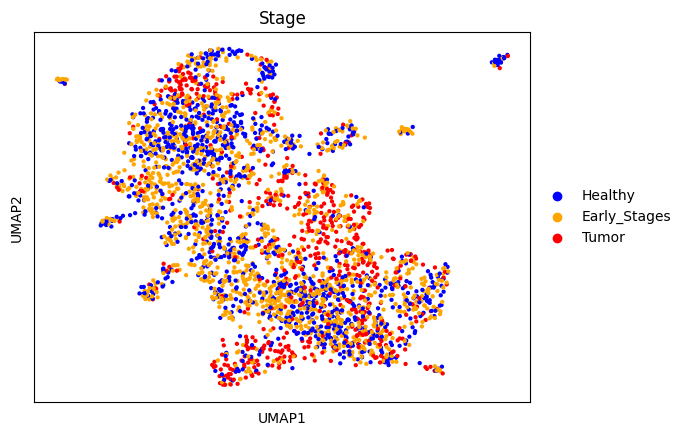

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


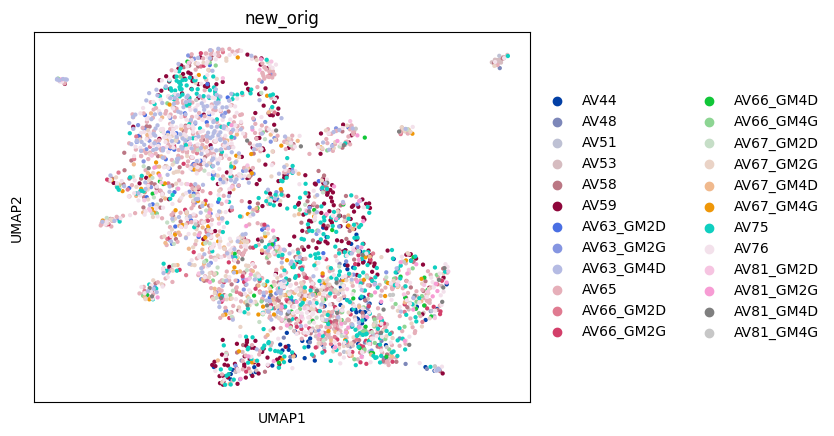

In [255]:
sc.external.pp.harmony_integrate(adata_pDC, 'orig.ident')

sc.pp.neighbors(adata_pDC, n_pcs=20, use_rep = "X_pca_harmony")
sc.tl.umap(adata_pDC)
sc.pl.umap(adata_pDC, color = 'Stage')
sc.pl.umap(adata_pDC, color = 'new_orig')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 12 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


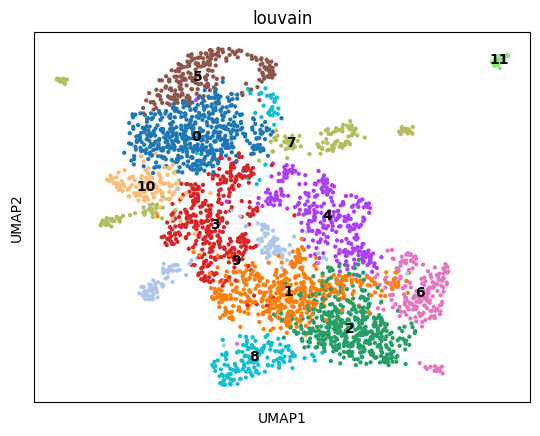

In [256]:
sc.tl.louvain(adata_pDC)
sc.pl.umap(adata_pDC, color = 'louvain', legend_loc = 'on data')

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


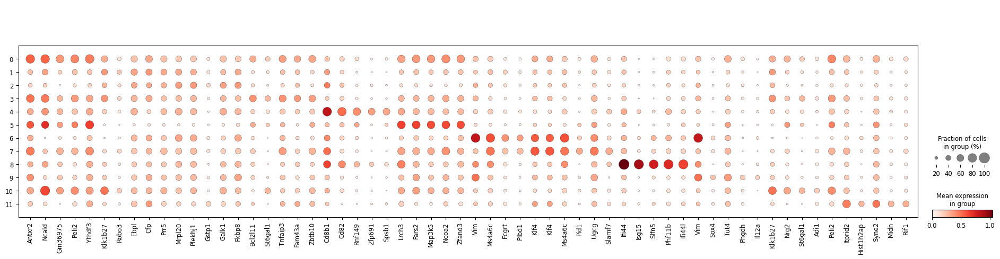

Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


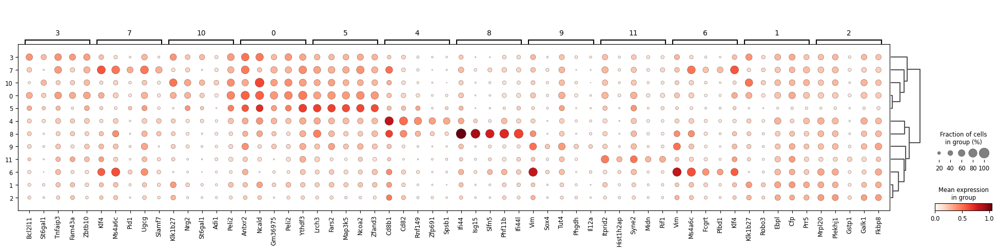

categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


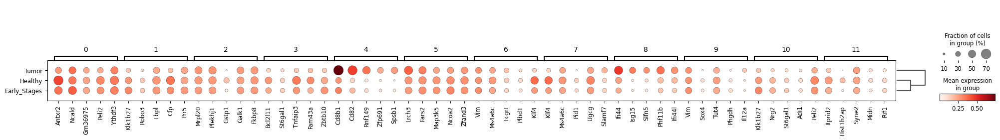

In [257]:
sc.tl.rank_genes_groups(adata_pDC, "louvain")
sc.tl.filter_rank_genes_groups(adata_pDC, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_in = 25% and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_pDC.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_pDC, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_pDC, genes, groupby="louvain")
sc.tl.dendrogram(adata_pDC, use_rep="X_pca_harmony", groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_pDC, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_pDC, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


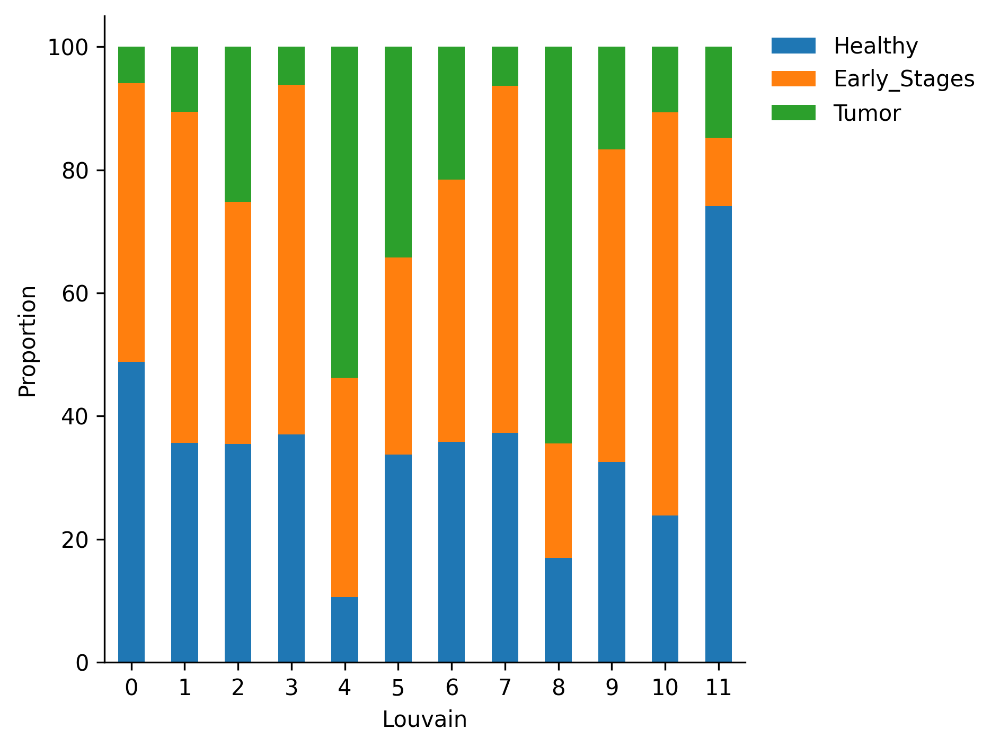

In [258]:
Stage_by_cluster = sf.get_cluster_proportions(adata_pDC, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

# Early pDC vs Healthy pDC
[//]: # (-.- .tabset .tabset-pills)

In [259]:
# DEG Tumor vs Healthy/Prénéo

sc.tl.rank_genes_groups(adata_pDC, "Stage", groups = ["Early_Stages"], reference = "Healthy", key_added = "early_vs_healthy")
sc.tl.filter_rank_genes_groups(adata_pDC, key = "early_vs_healthy", key_added = "early_vs_healthy_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['early_vs_healthy']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [260]:
df = sc.get.rank_genes_groups_df(adata_pDC, group = "Early_Stages", key = "early_vs_healthy_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [261]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [262]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [263]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

26 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
18,Abcg1,9.445516,1.722514,8.479266e-21,6.775993e-18,17.169027,UP
21,B930036N10Rik,8.618505,1.360386,1.211365e-17,7.942828e-15,14.100025,UP
1,Cdk8,17.191956,1.182152,1.111663e-62,1.421372e-58,57.847292,UP
37,Gm829,5.607235,1.100744,2.283679e-08,4.598286e-06,5.337404,UP
44,Spsb1,5.336218,1.044892,1.035729e-07,1.765710e-05,4.753081,UP
20,Cacnb2,8.675242,0.960129,7.314768e-18,5.055493e-15,14.296236,UP
45,Iglc2,5.300353,0.928110,1.258040e-07,2.075523e-05,4.682873,UP
76,Gm29282,4.419041,0.899339,1.033853e-05,9.755600e-04,3.010746,UP
70,Gm12166,4.615935,0.884694,4.112609e-06,4.470432e-04,3.349650,UP
86,Gramd3,4.256630,0.850282,2.153009e-05,1.811077e-03,2.742063,UP


    DOWN-regulated genes

In [264]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

30 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25571,Hspa1b,-16.551556,-2.260438,1.431402e-56,1.220127e-52,51.913595,DOWN
25568,Hspa1a,-13.788918,-2.109041,8.383588e-41,2.382057e-37,36.623048,DOWN
25562,Hsph1,-11.106867,-1.438421,9.612884e-28,1.293793e-24,23.888135,DOWN
25563,Gstp1,-11.435029,-1.423998,2.606165e-29,3.702491e-26,25.431506,DOWN
25523,Igha,-6.508320,-0.993161,9.605525e-11,3.190032e-08,7.496205,DOWN
25560,Dnajb1,-10.128141,-0.959786,1.594149e-23,1.509836e-20,19.821070,DOWN
25544,Gm42047,-7.195257,-0.959581,8.774157e-13,4.155051e-10,9.381424,DOWN
25537,Myadm,-7.099590,-0.904325,1.712878e-12,7.180608e-10,9.143839,DOWN
25522,Itprip,-6.502367,-0.866271,9.891938e-11,3.243034e-08,7.489049,DOWN
25476,Nr4a3,-5.526518,-0.832815,3.709854e-08,7.027288e-06,5.153212,DOWN


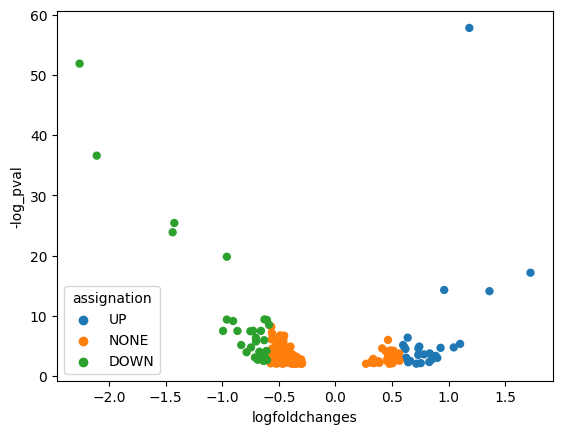

In [265]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [266]:
up_Early_vs_Healthy_pDC = list(df_up["names"].values)

In [267]:
df_enrich = sc.queries.enrich(up_Early_vs_Healthy_pDC,org = "mmusculus")

In [268]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

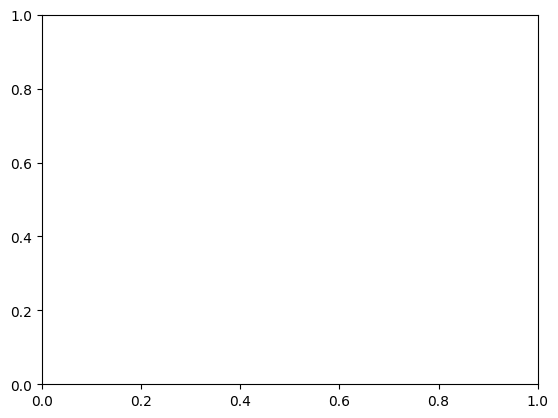

In [269]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

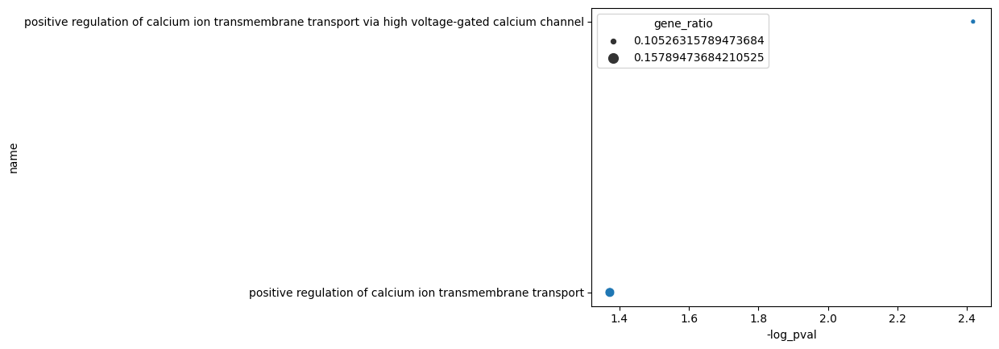

In [270]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

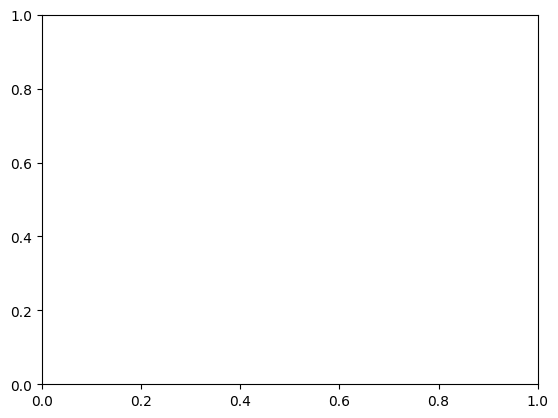

In [271]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

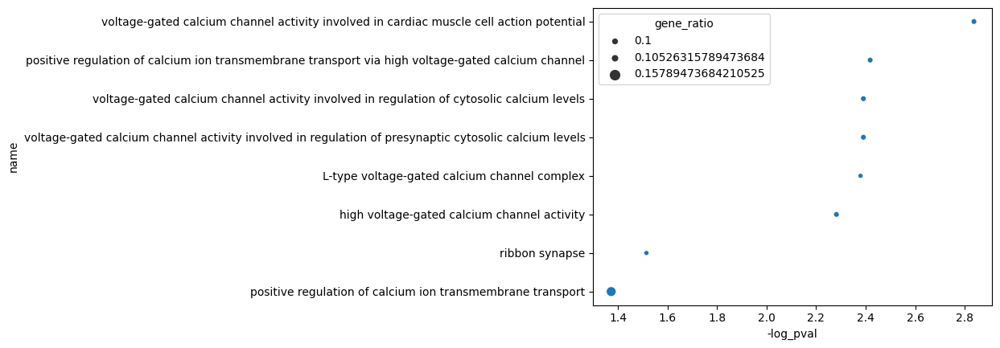

In [272]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [273]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

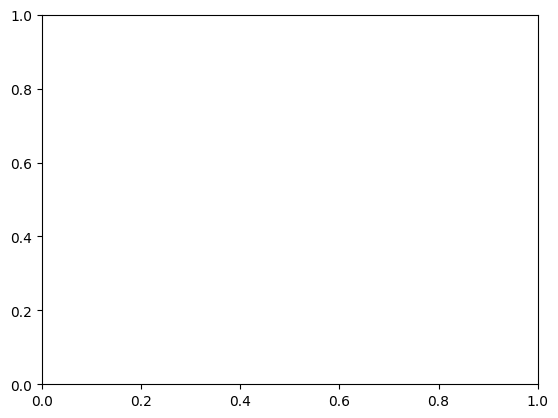

In [274]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

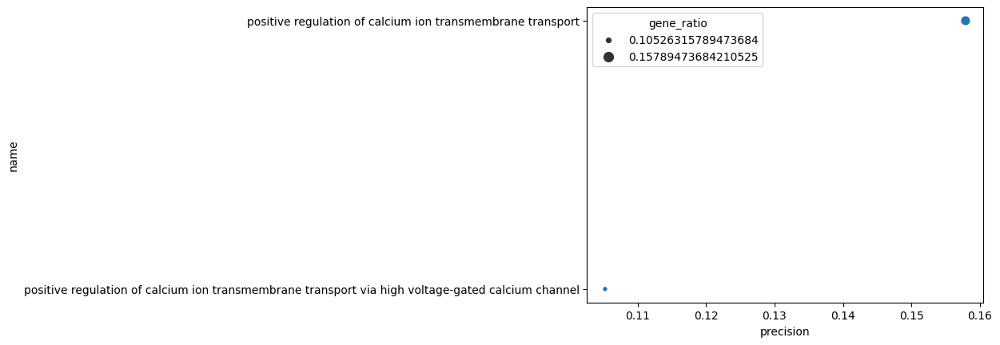

In [275]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

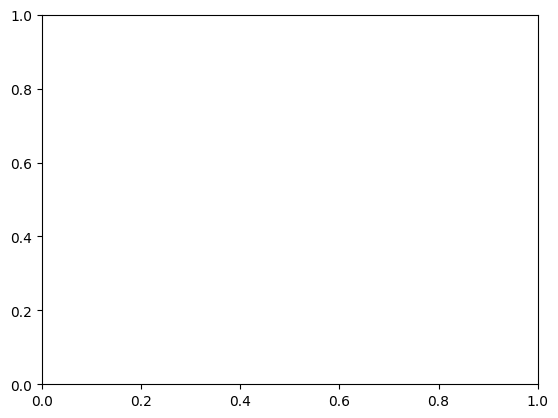

In [276]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [277]:
down_Early_vs_Healthy_pDC = list(df_down["names"].values)

In [278]:
df_enrich = sc.queries.enrich(down_Early_vs_Healthy_pDC,org = "mmusculus")

In [279]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

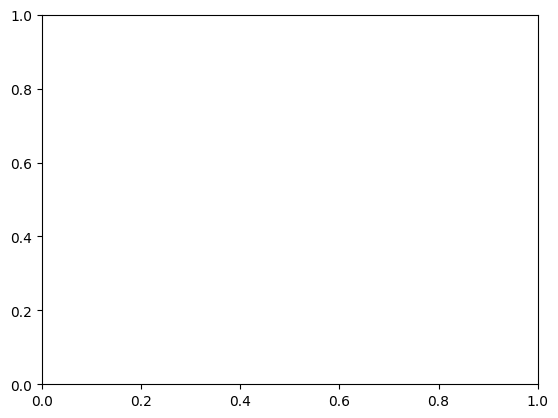

In [280]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

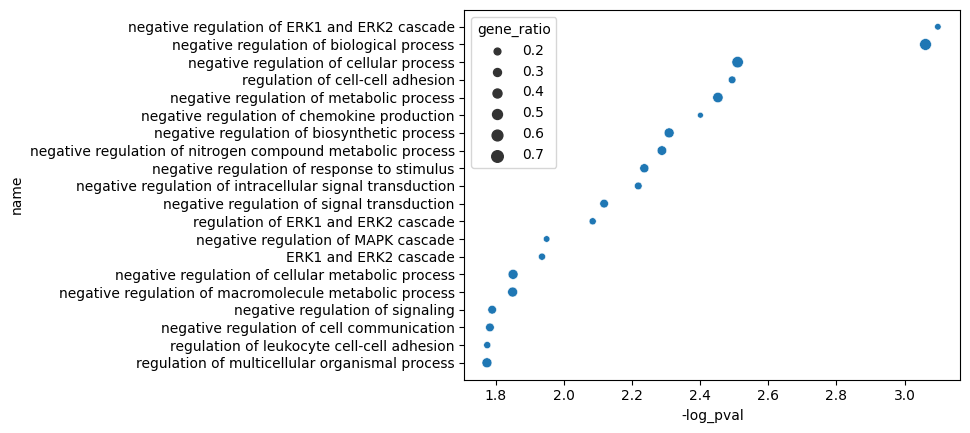

In [281]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

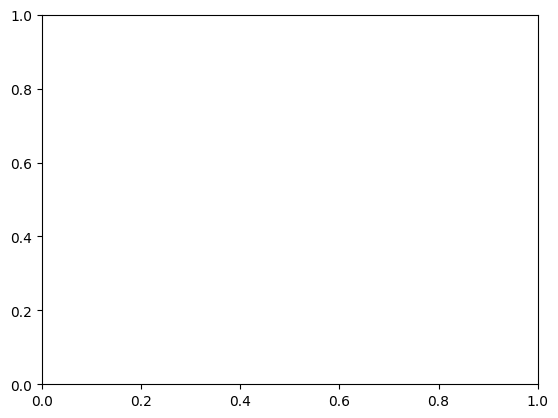

In [282]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

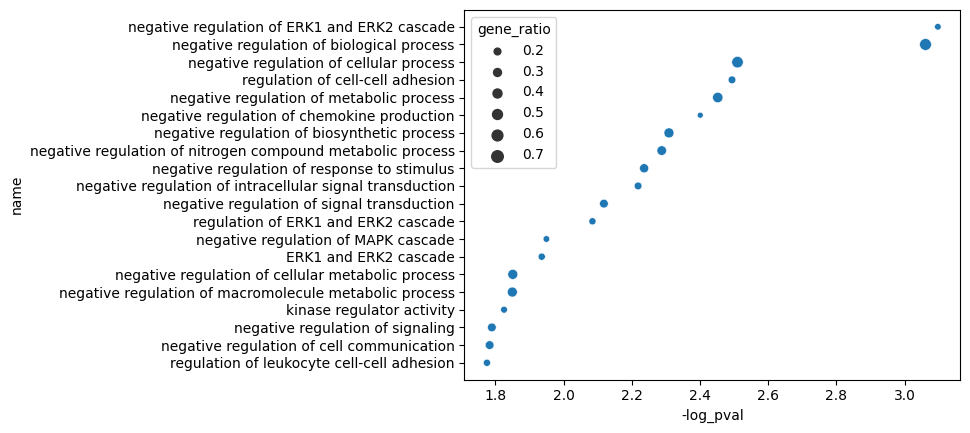

In [283]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [284]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

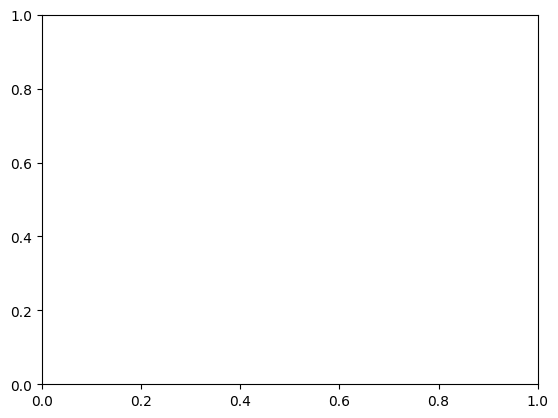

In [285]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

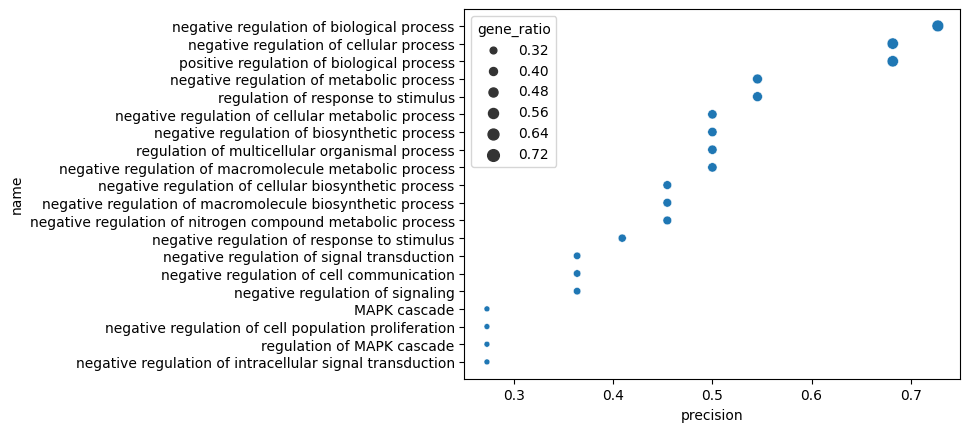

In [286]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

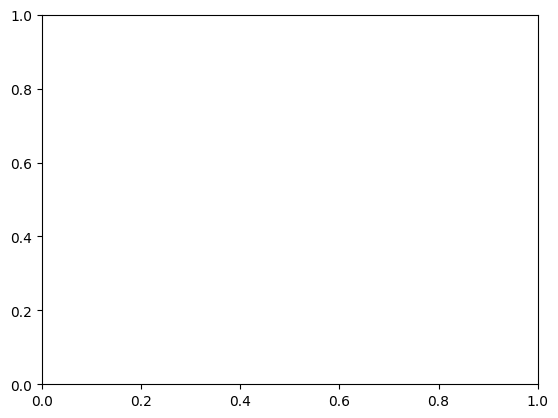

In [287]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

# Tumor pDC vs Other pDC
[//]: # (-.- .tabset .tabset-pills)

In [288]:
is_tumor = ["Tumor" if i == "Tumor" else "No_tumor" for i in adata_pDC.obs["Stage"].values]

adata_pDC.obs["is_tumor"] = is_tumor

In [289]:
# DEG Tumor vs Healthy/Prénéo


sc.tl.rank_genes_groups(adata_pDC, "is_tumor", groups = ["Tumor"], reference = "No_tumor", key_added = "tumor_vs_others")
sc.tl.filter_rank_genes_groups(adata_pDC, key = "tumor_vs_others", key_added = "tumor_vs_others_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['tumor_vs_others']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [290]:
df = sc.get.rank_genes_groups_df(adata_pDC, group = "Tumor", key = "tumor_vs_others_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [291]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [292]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [293]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

284 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
101,Il34,8.294512,4.176331,5.879661e-16,4.962201e-14,13.304326,UP
93,Itgae,8.381437,4.047249,2.989305e-16,2.626890e-14,13.580558,UP
80,Ifi202b,8.720265,3.548410,2.050818e-17,2.097741e-15,14.678248,UP
109,Rsad2,8.038151,3.374019,3.945593e-15,3.057476e-13,12.514637,UP
31,Sct,11.632272,3.201834,1.007649e-28,2.454057e-26,25.610115,UP
7,Adam11,15.429800,2.963723,1.415637e-46,1.167764e-43,42.932645,UP
75,Macrod2,9.178380,2.801874,4.873203e-19,5.716401e-17,16.242877,UP
53,Tnfrsf13c,10.152725,2.739263,1.014446e-22,1.591497e-20,19.798194,UP
24,Ckb,12.365864,2.716548,5.621186e-32,1.615112e-29,28.791797,UP
12,Isg15,14.842369,2.638375,9.387897e-44,6.155572e-41,40.210732,UP


    DOWN-regulated genes

In [294]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

174 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25538,Pdlim1,-13.730605,-1.725652,1.050121e-40,6.245044e-38,37.204465,DOWN
25559,Ier2,-15.878510,-1.671578,1.072714e-52,1.613614e-49,48.792200,DOWN
25548,Nedd4,-14.844920,-1.665942,1.328018e-46,1.167764e-43,42.932645,DOWN
25482,Rhob,-10.553872,-1.444741,3.087666e-25,5.986945e-23,22.222795,DOWN
25530,Klf4,-13.258916,-1.352228,5.894252e-38,2.791256e-35,34.554200,DOWN
25483,Selenop,-10.560410,-1.341593,3.751852e-25,7.213712e-23,22.141841,DOWN
25450,Ptpro,-9.719828,-1.316301,1.145599e-21,1.636606e-19,18.786056,DOWN
25508,Grasp,-12.170567,-1.313103,2.083606e-32,6.268467e-30,29.202839,DOWN
25442,Cyp4f18,-9.442563,-1.299090,1.395022e-20,1.810837e-18,17.742121,DOWN
25433,Robo3,-9.193498,-1.224125,1.226353e-19,1.472314e-17,16.831999,DOWN


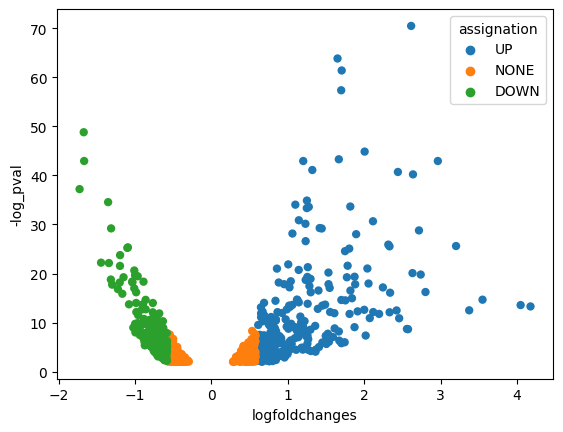

In [295]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [296]:
up_Tumor_vs_Others_pDC = list(df_up["names"].values)

In [297]:
df_enrich = sc.queries.enrich(up_Tumor_vs_Others_pDC,org = "mmusculus")

In [298]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

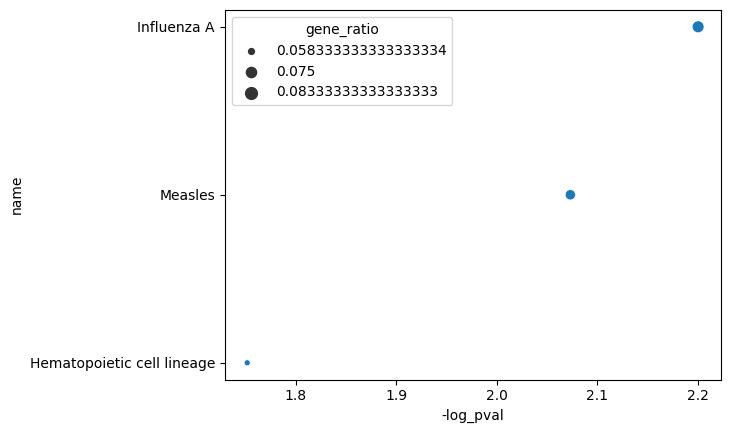

In [299]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

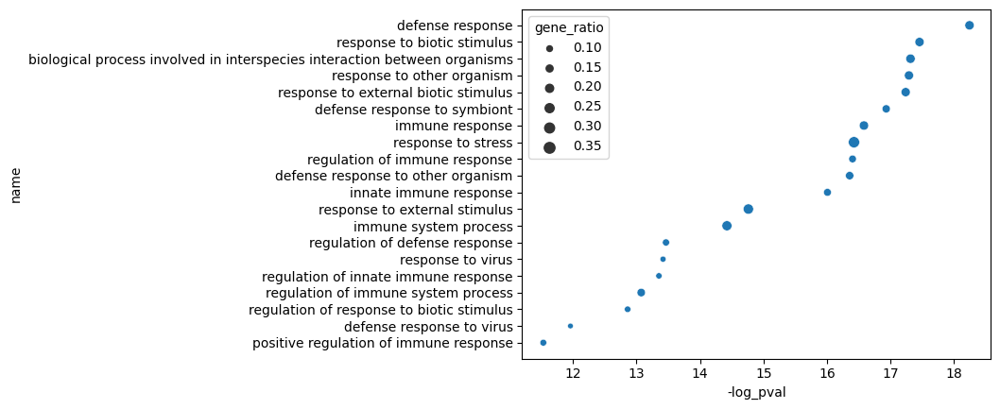

In [300]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

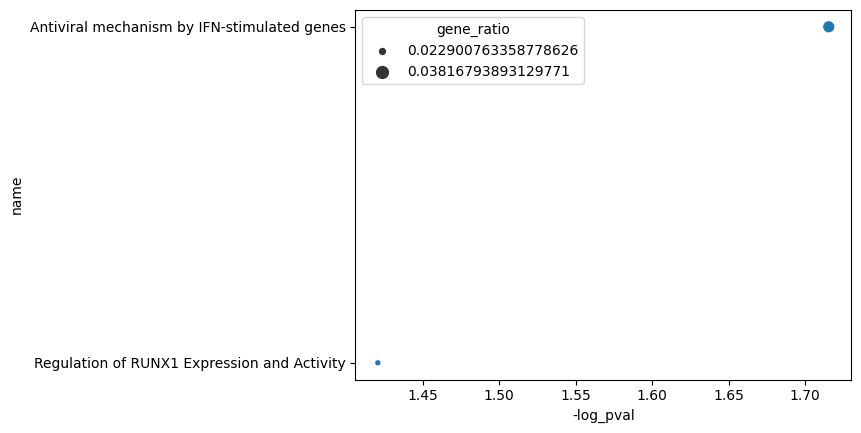

In [301]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

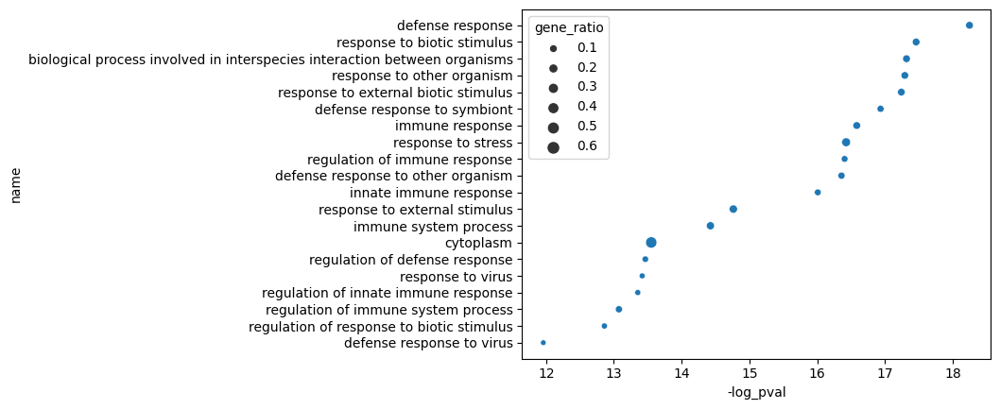

In [302]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [303]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

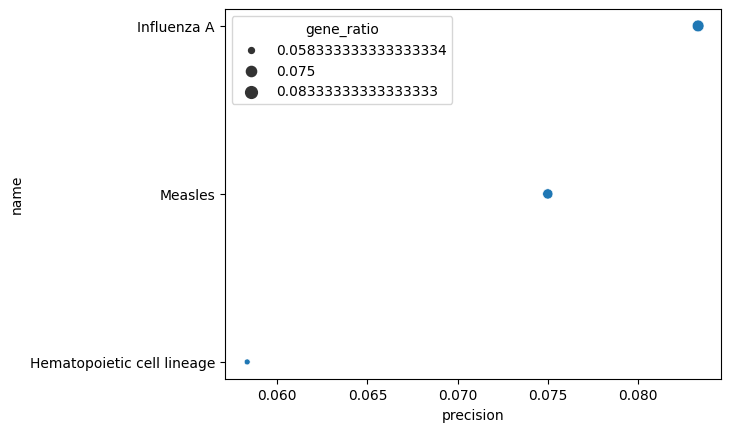

In [304]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

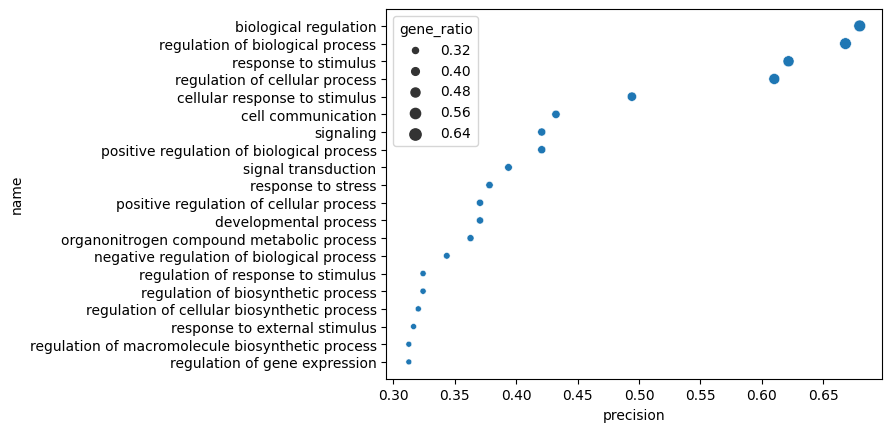

In [305]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

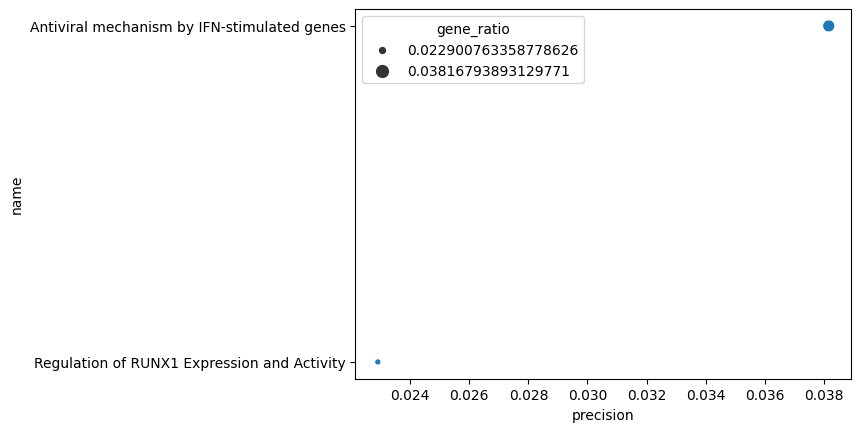

In [306]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [307]:
down_Tumor_vs_Others_pDC = list(df_down["names"].values)

In [308]:
df_enrich = sc.queries.enrich(down_Tumor_vs_Others_pDC,org = "mmusculus")

In [309]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

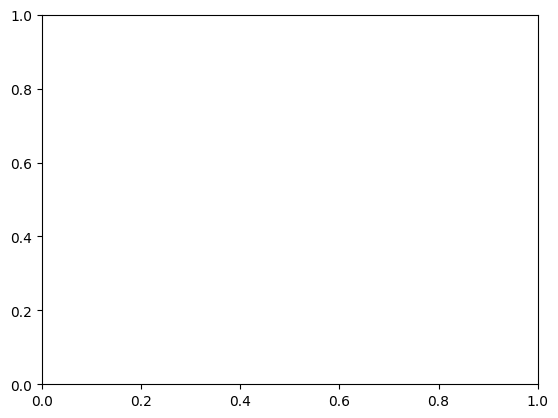

In [310]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

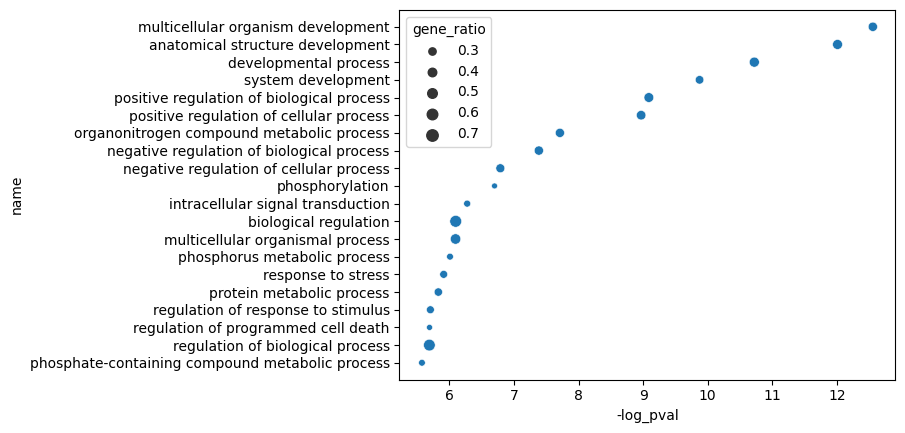

In [311]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

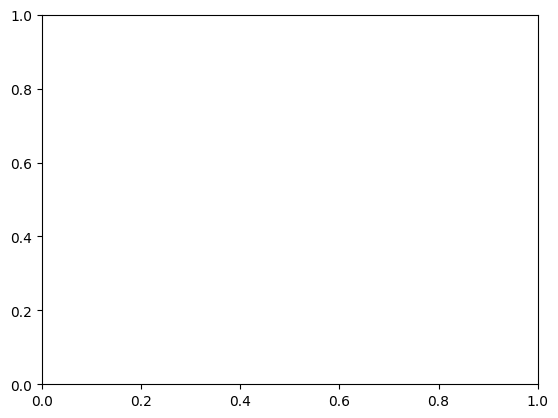

In [312]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

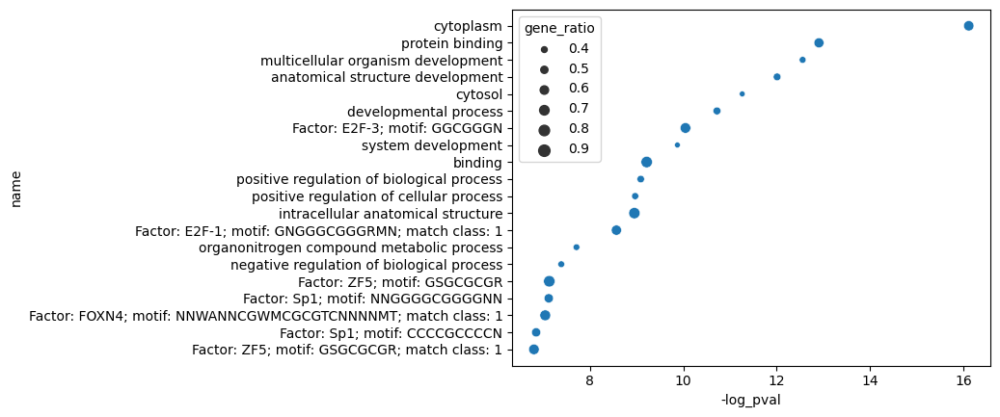

In [313]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [314]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

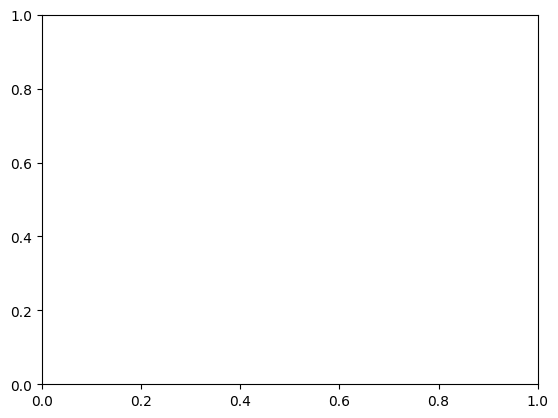

In [315]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

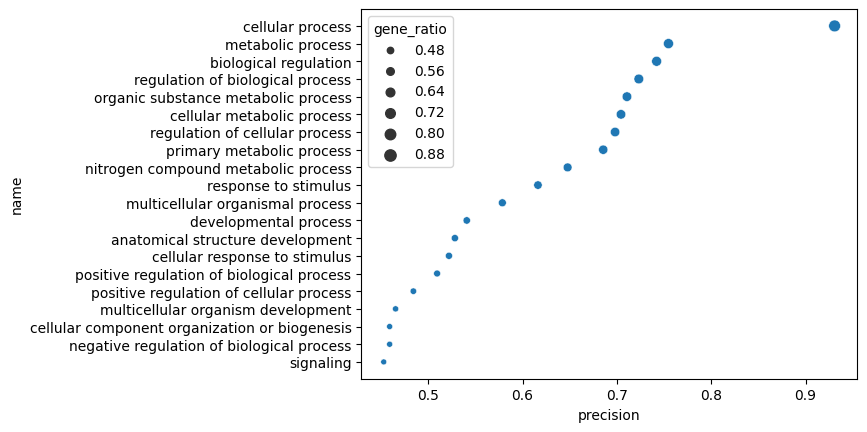

In [316]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

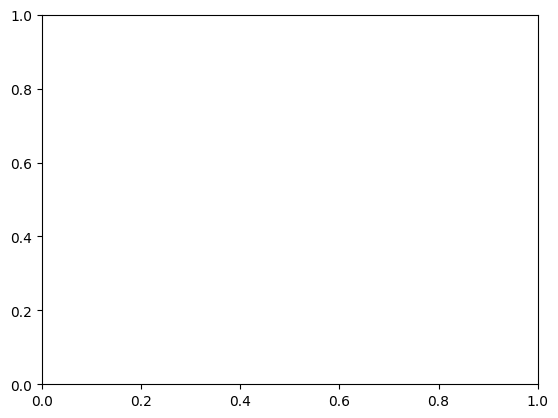

In [317]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

# Mature DC
[//]: # (-.- .tabset .tabset-pills)

In [318]:
adata_mature = adata[adata.obs['Population'].isin(['Mature_DC']), :].raw.to_adata().copy()
adata_mature


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/anndata/_core/raw.py:139: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return anndata.AnnData(


AnnData object with n_obs × n_vars = 1025 × 25572
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Experiment_ID', 'Stage', 'New_Cell_ID', 'Population', 'Mouse_ID', 'Week_post Cre_activation', 'Sub_class_Stage', 'Mammary_glands', 'mouse_age_(Week)', 'new_orig'
    var: 'features', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'Stage_colors', 'neighbors', 'umap', 'new_orig_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


    finished (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


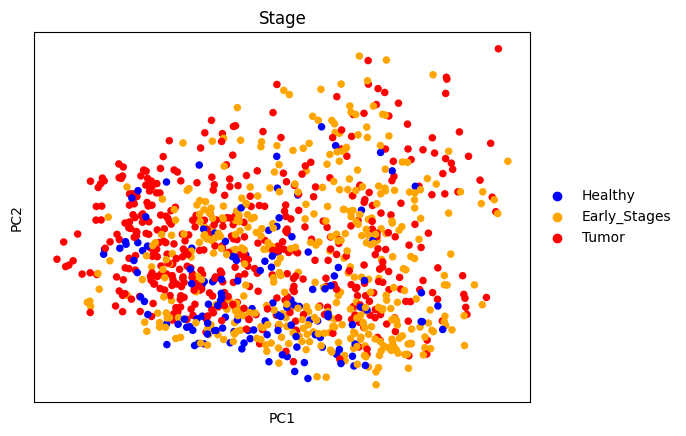

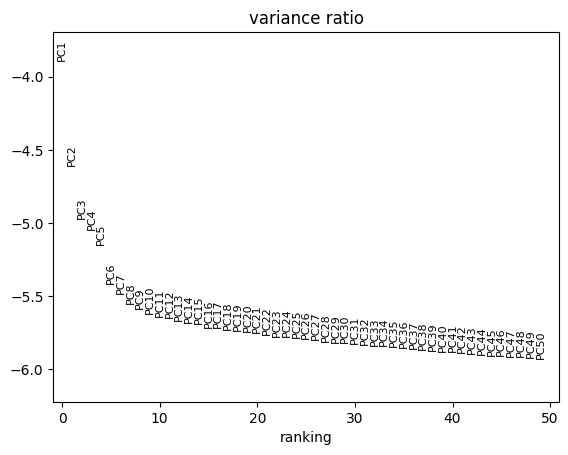

In [319]:
adata_mature = sf.pp_PCA(adata_mature) # Function defined in scFunction.py

# Normalize, Log-transform, select HVG, scale data and perform PCA
sc.pl.pca(adata_mature, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_mature, log=True, n_pcs = 50) #ndim = 20

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


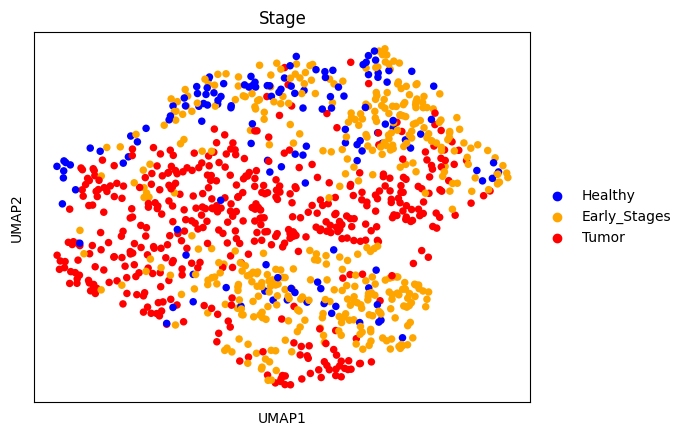

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


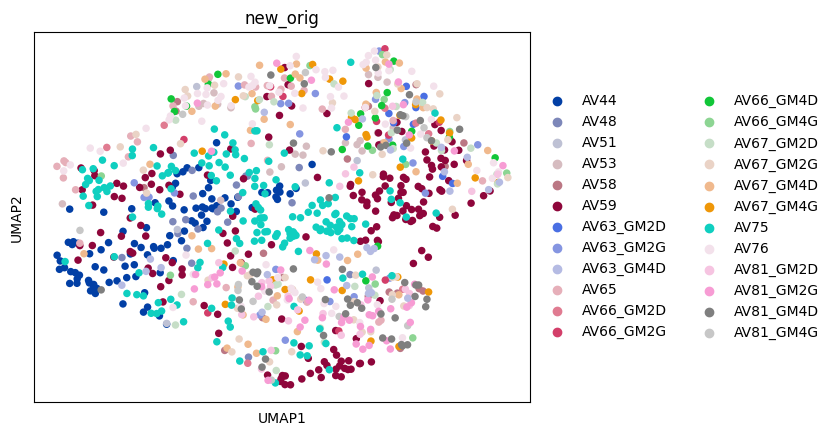

In [320]:
sc.pp.neighbors(adata_mature, n_pcs=20)
sc.tl.umap(adata_mature)
sc.pl.umap(adata_mature, color = 'Stage')
sc.pl.umap(adata_mature, color = 'new_orig')

### Regress cycle

In [321]:
cell_cycle_genes = [x.strip().capitalize() for x in open('../data/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_mature.var_names]

sc.tl.score_genes_cell_cycle(adata_mature, s_genes=s_genes, g2m_genes=g2m_genes)

sc.pp.regress_out(adata_mature, ['S_score', 'G2M_score'])
sc.pp.scale(adata_mature)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    556 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    729 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)
regressing out ['S_score', 'G2M_score']


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished (0:00:06)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


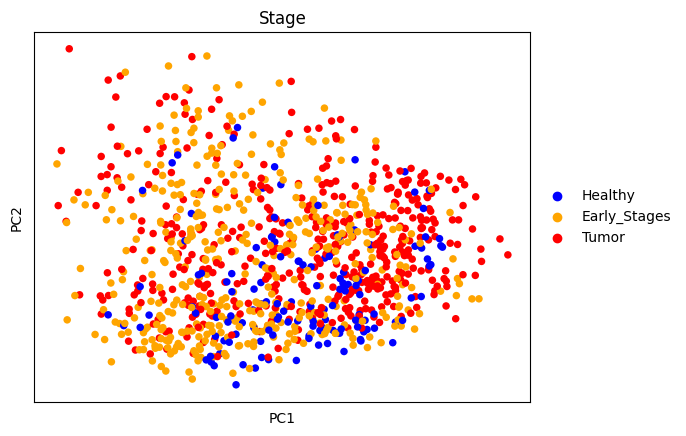

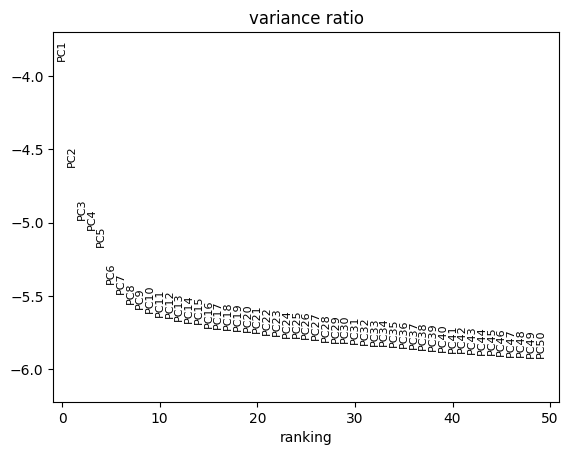

In [322]:
sc.tl.pca(adata_mature)
sc.pl.pca(adata_mature, color = "Stage", palette={"Healthy" : "blue", "Early_Stages" : "orange", "Tumor" : "red"})
sc.pl.pca_variance_ratio(adata_mature, log=True, n_pcs = 50) #ndim = 20

## Sans harmony

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


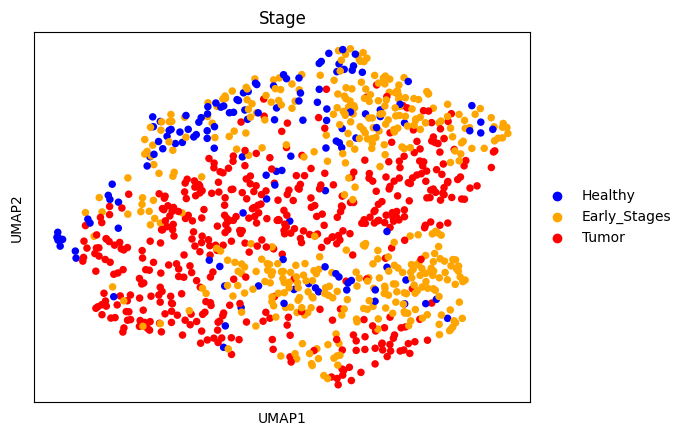

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


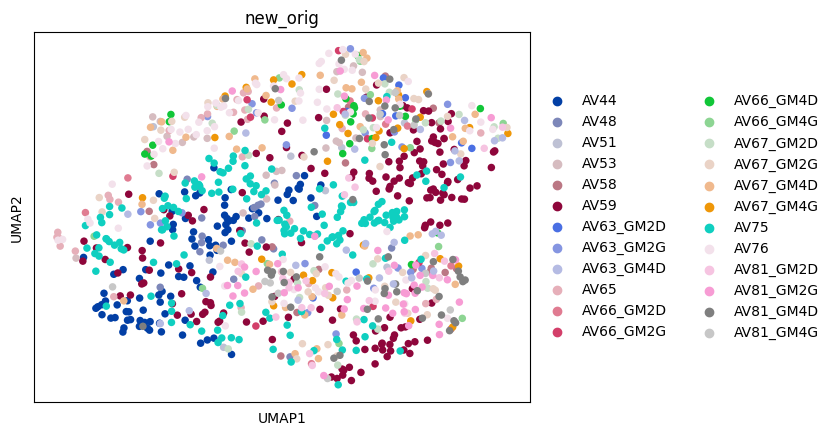

In [323]:
sc.pp.neighbors(adata_mature, n_pcs=20)
sc.tl.umap(adata_mature)
sc.pl.umap(adata_mature, color = 'Stage')
sc.pl.umap(adata_mature, color = 'new_orig')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


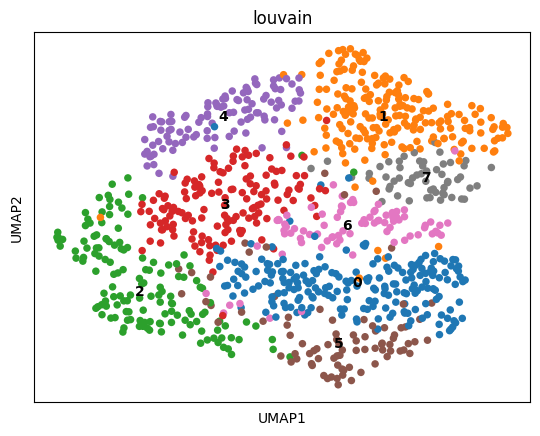

In [324]:
sc.tl.louvain(adata_mature, resolution = 0.8)
sc.pl.umap(adata_mature, color = 'louvain', legend_loc = 'on data')

computing density on 'umap'
--> added
    'umap_density_Stage', densities (adata.obs)
    'umap_density_Stage_params', parameter (adata.uns)


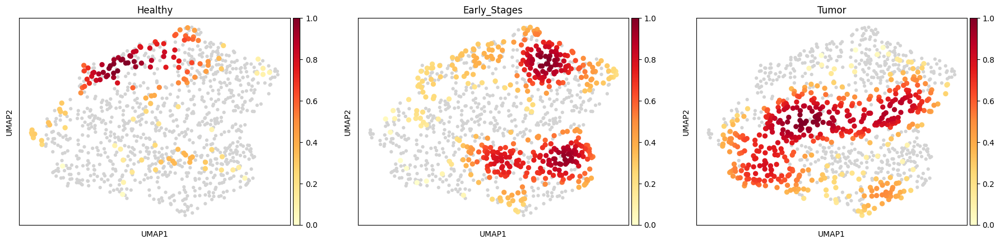

In [325]:
sc.tl.embedding_density(adata_mature, groupby="Stage")
sc.pl.embedding_density(adata_mature, groupby="Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


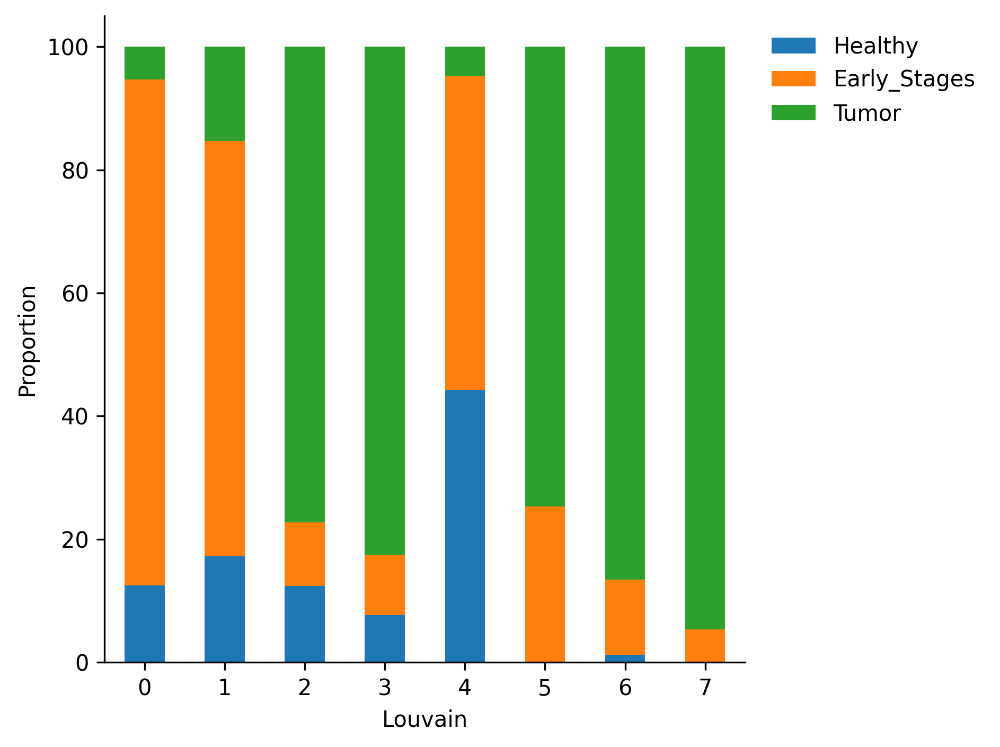

In [326]:
Stage_by_cluster = sf.get_cluster_proportions(adata_mature, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


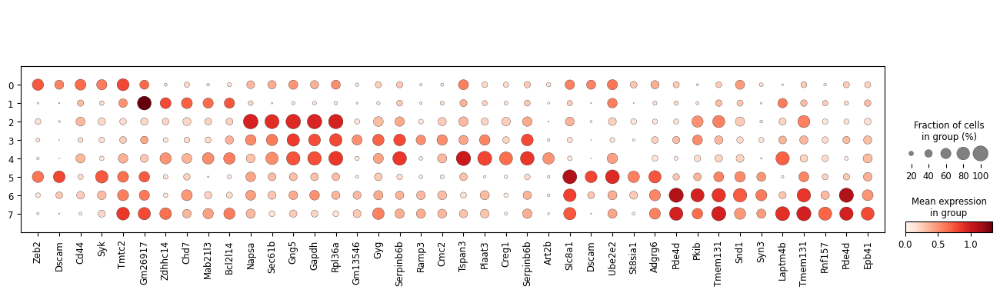

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


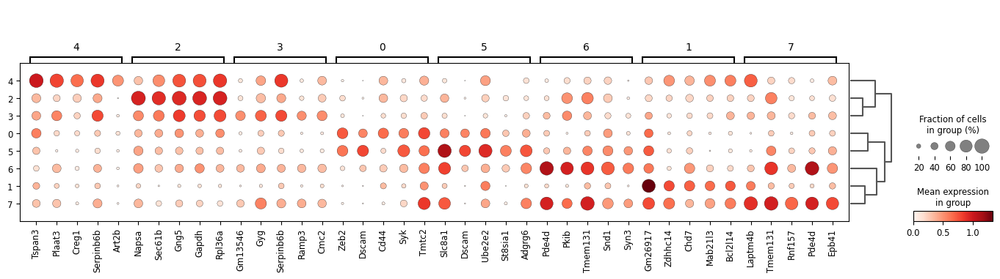

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Stage']`
categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


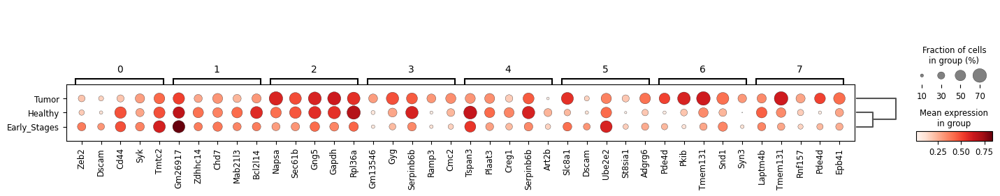

In [327]:
sc.tl.rank_genes_groups(adata_mature, "louvain")
sc.tl.filter_rank_genes_groups(adata_mature, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_percent = 25 and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_mature.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_mature, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_mature, genes, groupby="louvain")
sc.pl.rank_genes_groups_dotplot(adata_mature, key = "rank_genes_groups_filtered", n_genes= 5 )
sc.pl.rank_genes_groups_dotplot(adata_mature, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

## Integration avec harmony

2024-05-03 15:26:51,228 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-03 15:26:51,399 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-03 15:26:51,402 - harmonypy - INFO - Iteration 1 of 10
2024-05-03 15:26:51,578 - harmonypy - INFO - Iteration 2 of 10
2024-05-03 15:26:51,660 - harmonypy - INFO - Iteration 3 of 10
2024-05-03 15:26:51,711 - harmonypy - INFO - Iteration 4 of 10
2024-05-03 15:26:51,764 - harmonypy - INFO - Iteration 5 of 10
2024-05-03 15:26:51,812 - harmonypy - INFO - Iteration 6 of 10
2024-05-03 15:26:51,861 - harmonypy - INFO - Iteration 7 of 10
2024-05-03 15:26:51,899 - harmonypy - INFO - Iteration 8 of 10
2024-05-03 15:26:51,935 - harmonypy - INFO - Iteration 9 of 10
2024-05-03 15:26:51,979 - harmonypy - INFO - Iteration 10 of 10
2024-05-03 15:26:52,025 - harmonypy - INFO - Stopped before convergence


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


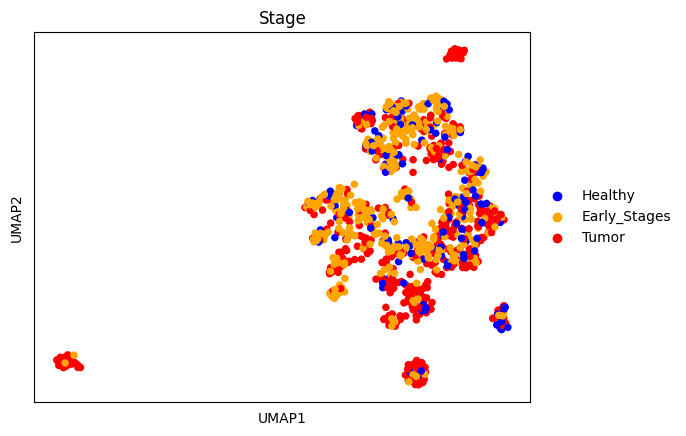

/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


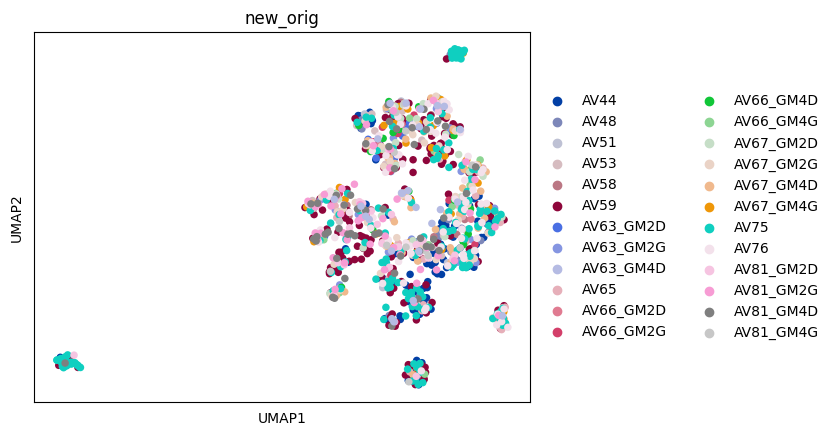

In [328]:
sc.external.pp.harmony_integrate(adata_mature, 'orig.ident')

sc.pp.neighbors(adata_mature, n_pcs=20, use_rep = "X_pca_harmony")
sc.tl.umap(adata_mature)
sc.pl.umap(adata_mature, color = 'Stage')
sc.pl.umap(adata_mature, color = 'new_orig')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


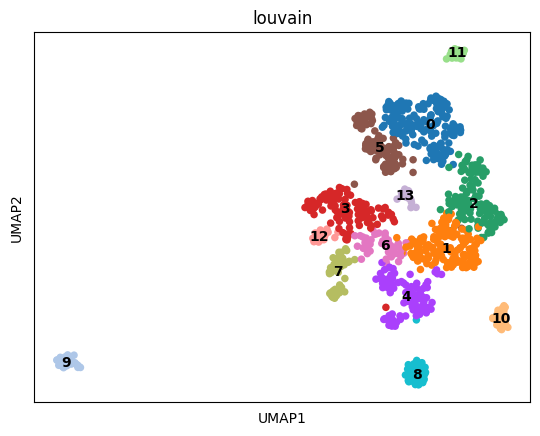

In [329]:
sc.tl.louvain(adata_mature)
sc.pl.umap(adata_mature, color = 'louvain', legend_loc = 'on data')

Markers

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


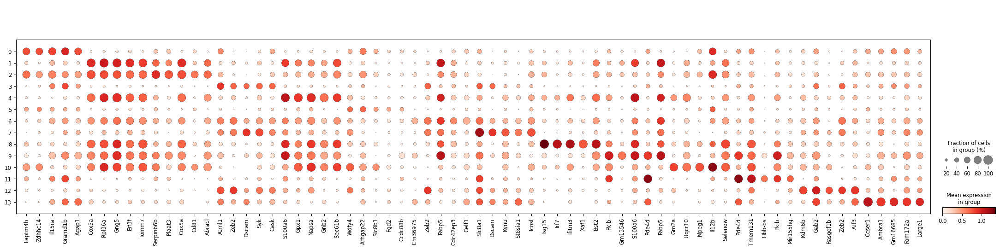

Storing dendrogram info using `.uns['dendrogram_louvain']`


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


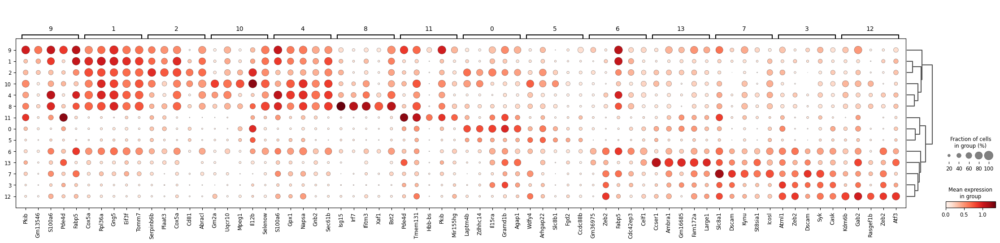

categories: Healthy, Early_Stages, Tumor
var_group_labels: 0, 1, 2, etc.


/Users/mscavino/miniconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


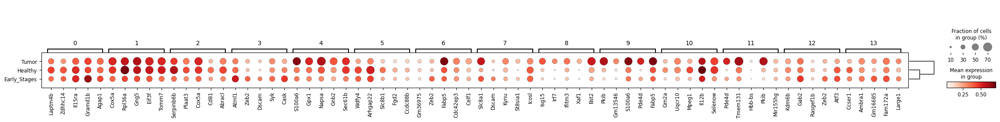

In [330]:
sc.tl.rank_genes_groups(adata_mature, "louvain")
sc.tl.filter_rank_genes_groups(adata_mature, min_fold_change=-1000, min_in_group_fraction = 0.1) # min_in = 25% and max_out = 50%

levels = [str(i) for i in range(len(np.unique(adata_mature.obs.louvain)))]

df = sc.get.rank_genes_groups_df(adata_mature, levels, key = "rank_genes_groups_filtered")
df = df.dropna()
top5markers = df.groupby("group").head(5)

genes = top5markers.names.values


sc.pl.dotplot(adata_mature, genes, groupby="louvain")
sc.tl.dendrogram(adata_mature, use_rep="X_pca_harmony", groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_mature, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "louvain")
sc.pl.rank_genes_groups_dotplot(adata_mature, key = "rank_genes_groups_filtered", n_genes= 5, groupby = "Stage")

/Users/mscavino/Thèse/ITMO/scripts/scFunctions.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index()


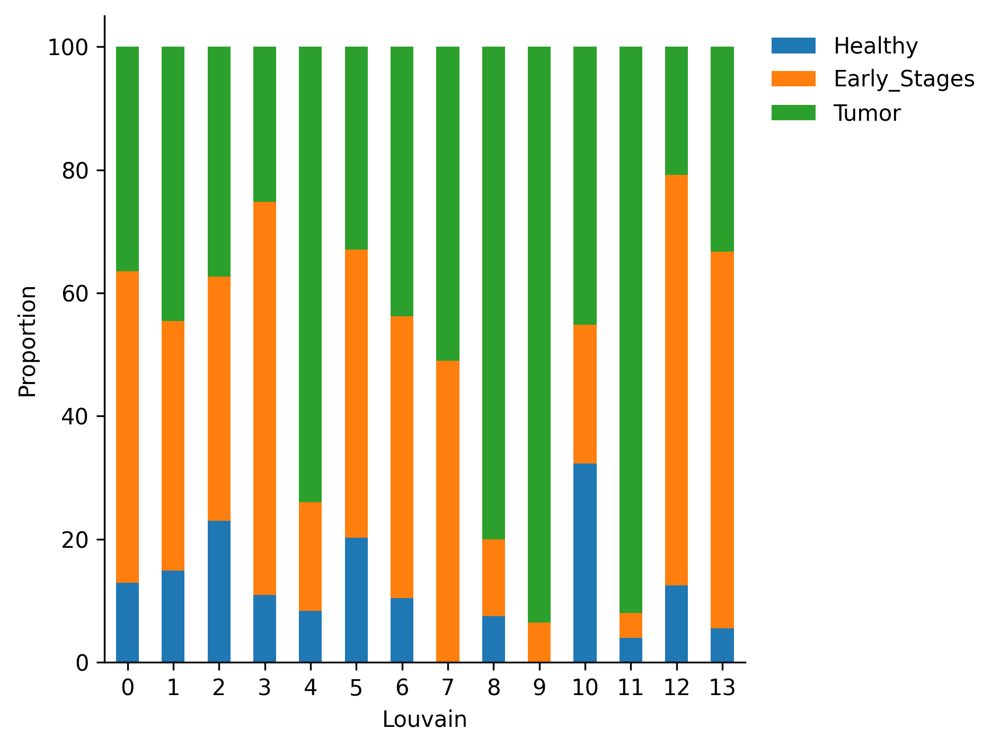

In [331]:
Stage_by_cluster = sf.get_cluster_proportions(adata_mature, cluster_key="Stage", sample_key="louvain")
fig = sf.plot_cluster_proportions(Stage_by_cluster)

# Early Mature vs Healthy Mature
[//]: # (-.- .tabset .tabset-pills)

In [332]:
# DEG Tumor vs Healthy/Prénéo

sc.tl.rank_genes_groups(adata_mature, "Stage", groups = ["Early_Stages"], reference = "Healthy", key_added = "early_vs_healthy")
sc.tl.filter_rank_genes_groups(adata_mature, key = "early_vs_healthy", key_added = "early_vs_healthy_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['early_vs_healthy']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [333]:
df = sc.get.rank_genes_groups_df(adata_mature, group = "Early_Stages", key = "early_vs_healthy_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [334]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [335]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [336]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

32 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
6,Hist1h1d,6.011965,5.061829,3.764114e-09,5.662113e-06,5.247021,UP
3,Gm44710,6.790444,2.789921,2.864470e-11,8.138914e-08,7.089434,UP
29,Syn3,4.647471,2.726478,4.288906e-06,1.232314e-03,2.909279,UP
10,5930403N24Rik,5.604493,2.560493,3.299276e-08,2.721584e-05,4.565178,UP
13,Fndc7,5.360691,2.496619,1.219627e-07,7.606900e-05,4.118792,UP
8,E130208F15Rik,5.802326,2.479711,1.103208e-08,1.282329e-05,4.892000,UP
18,Tex14,5.021273,2.439234,6.933813e-07,2.864790e-04,3.542907,UP
4,Alpk2,6.606729,2.339777,1.015472e-10,2.163971e-07,6.664749,UP
49,Thoc1,4.116509,2.111773,4.431562e-05,7.127289e-03,2.147076,UP
20,Gria3,4.936948,2.012679,1.109813e-06,4.113062e-04,3.385835,UP


    DOWN-regulated genes

In [337]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")
df_down[0:20]

10 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25496,Cuta,-4.520429,-1.729781,1.161740e-05,0.002396,2.620548,DOWN
25470,Gm2a,-4.257720,-1.524535,3.388169e-05,0.005663,2.246962,DOWN
25544,Mpeg1,-5.474137,-1.454703,1.402158e-07,0.000083,4.078907,DOWN
25462,Hmgn2,-4.171074,-1.419092,4.661194e-05,0.007403,2.130564,DOWN
25487,Nr4a1,-4.385901,-1.199424,1.886387e-05,0.003600,2.443709,DOWN
25552,Hspa1a,-5.724903,-1.164996,3.592055e-08,0.000028,4.555406,DOWN
25535,Hspa1b,-5.269466,-1.159811,3.516815e-07,0.000158,3.801961,DOWN
25476,Atp5g1,-4.304475,-1.078998,2.587927e-05,0.004502,2.346601,DOWN
25481,Gm11808,-4.336225,-0.918175,2.229534e-05,0.004057,2.391829,DOWN
25491,Dnase1l3,-4.452892,-0.870727,1.319920e-05,0.002658,2.575491,DOWN


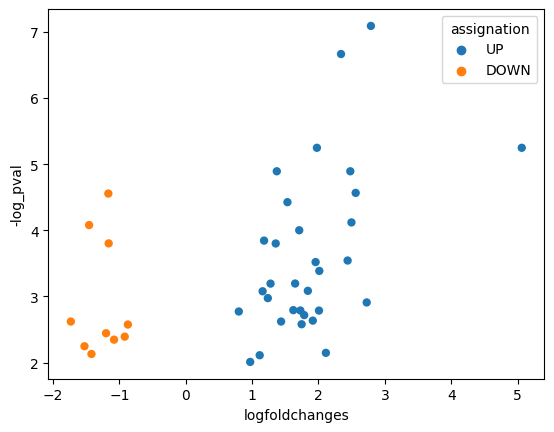

In [338]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [339]:
up_Early_vs_Healthy_mature = list(df_up["names"].values)

In [340]:
df_enrich = sc.queries.enrich(up_Early_vs_Healthy_mature,org = "mmusculus")

In [341]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

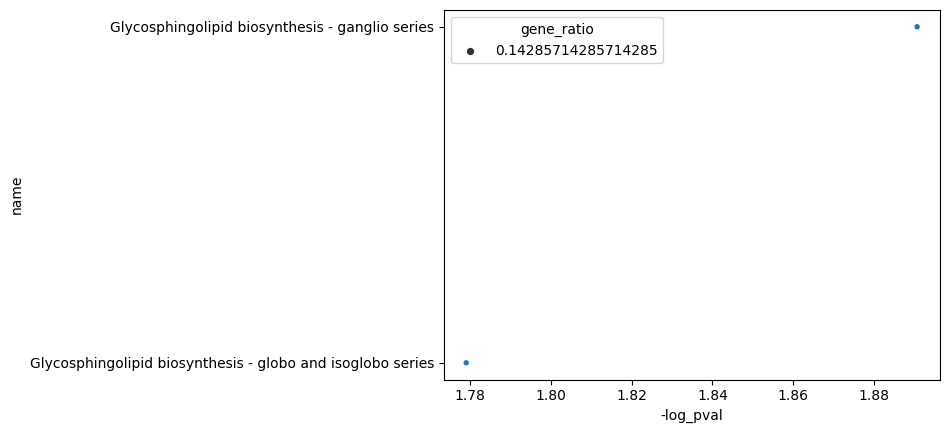

In [342]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

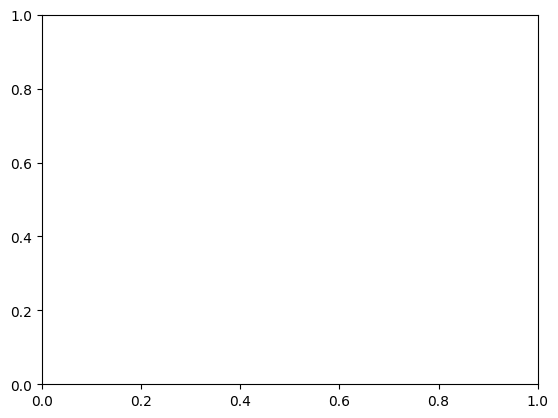

In [343]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

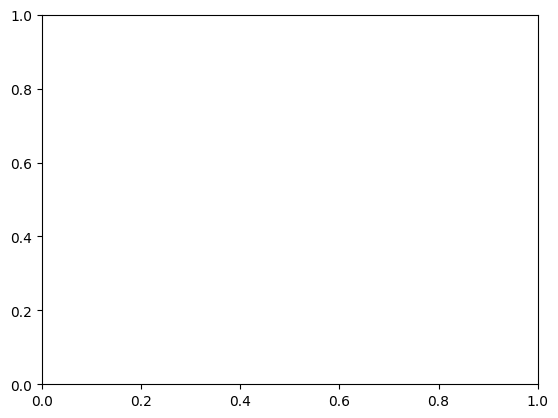

In [344]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

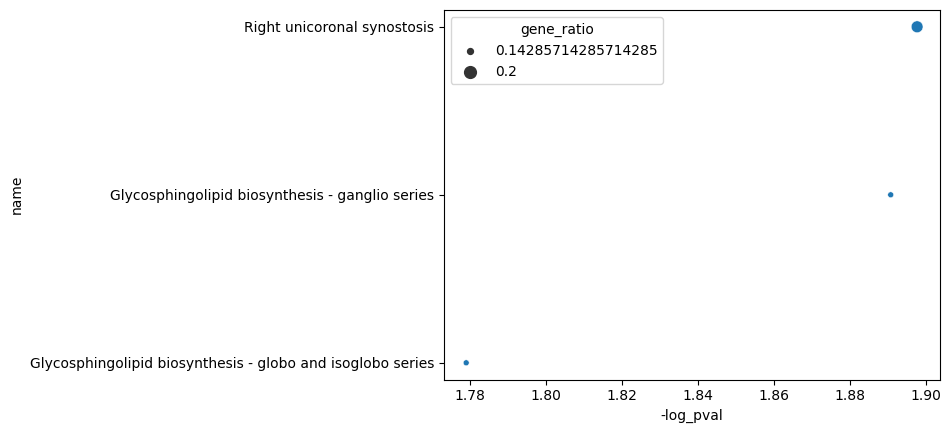

In [345]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [346]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

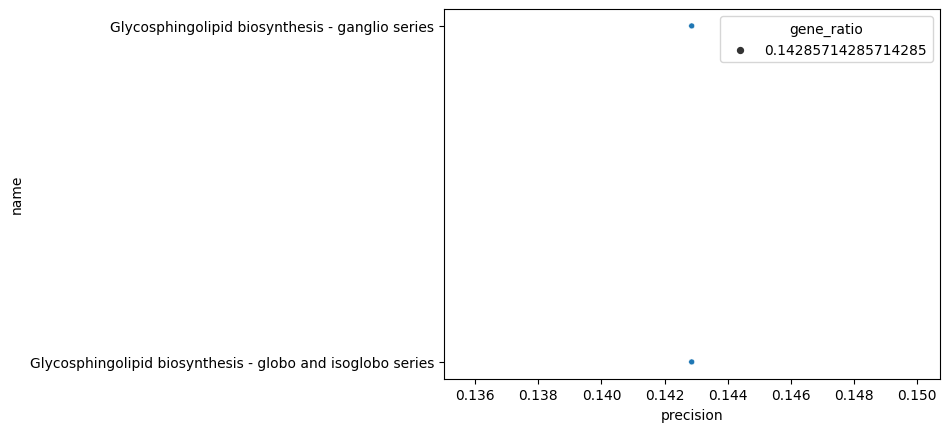

In [347]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

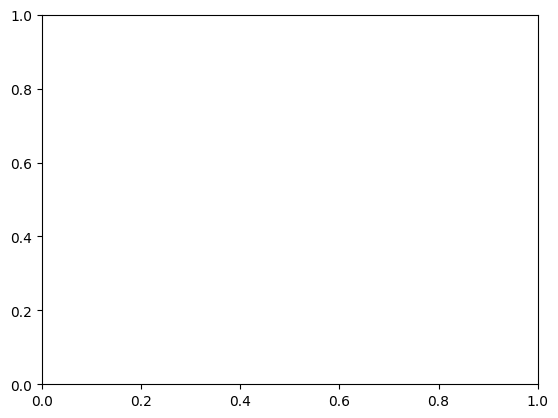

In [348]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

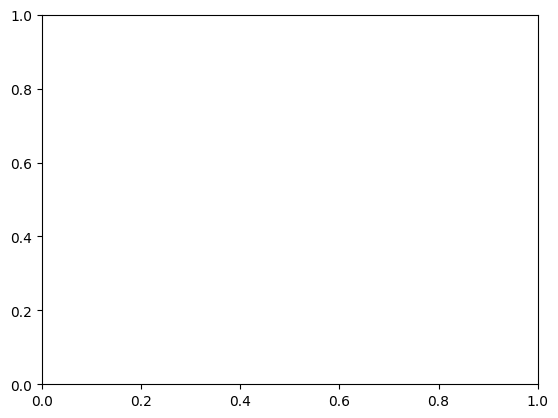

In [349]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [350]:
down_Early_vs_Healthy_mature = list(df_down["names"].values)

In [351]:
df_enrich = sc.queries.enrich(down_Early_vs_Healthy_mature,org = "mmusculus")

In [352]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

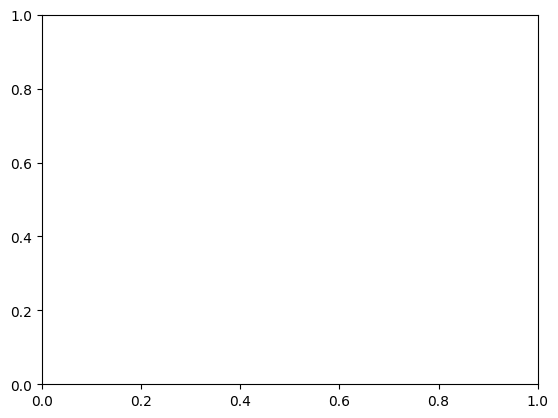

In [353]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

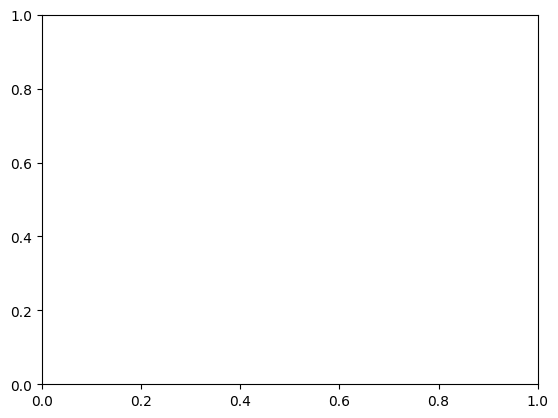

In [354]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

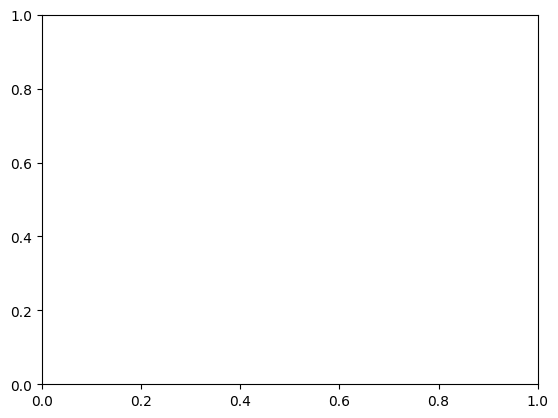

In [355]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: >

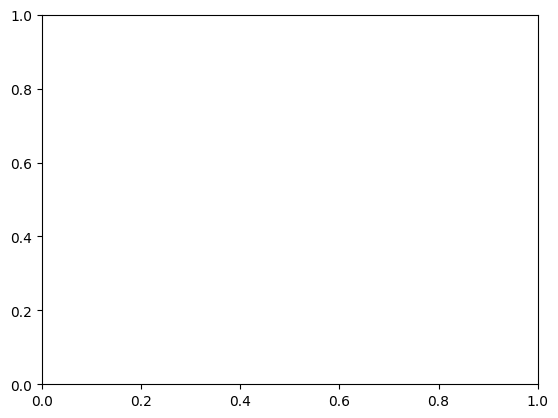

In [356]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [357]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

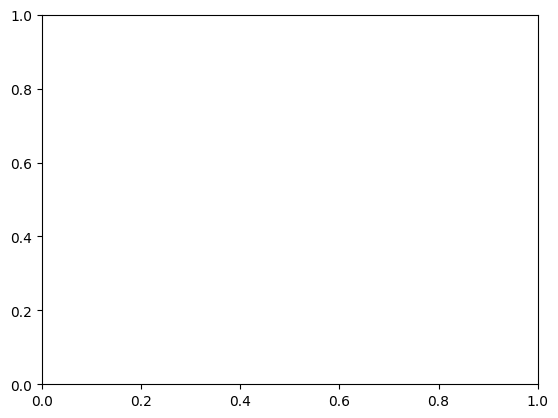

In [358]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: >

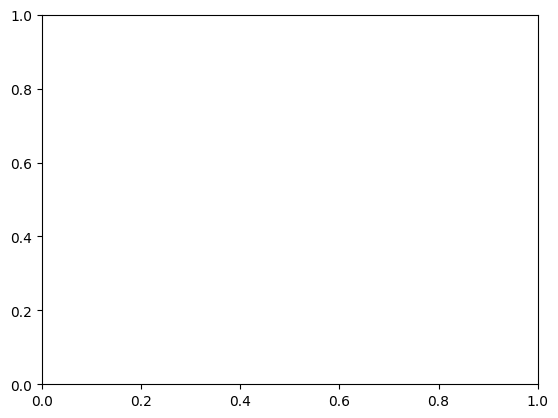

In [359]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

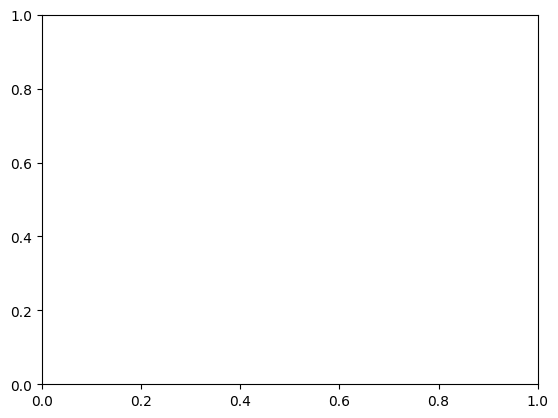

In [360]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

# Tumor Mature vs Other Mature
[//]: # (-.- .tabset .tabset-pills)

In [361]:
is_tumor = ["Tumor" if i == "Tumor" else "No_tumor" for i in adata_mature.obs["Stage"].values]

adata_mature.obs["is_tumor"] = is_tumor

In [362]:
# DEG Tumor vs Healthy/Prénéo


sc.tl.rank_genes_groups(adata_mature, "is_tumor", groups = ["Tumor"], reference = "No_tumor", key_added = "tumor_vs_others")
sc.tl.filter_rank_genes_groups(adata_mature, key = "tumor_vs_others", key_added = "tumor_vs_others_filtered", 
                               min_fold_change = -1000, min_in_group_fraction = 0.1)

ranking genes
    finished: added to `.uns['tumor_vs_others']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.1 min_fold_change: -1000, max_out_group_fraction: 0.5


In [363]:
df = sc.get.rank_genes_groups_df(adata_mature, group = "Tumor", key = "tumor_vs_others_filtered")
df = df.dropna()
df_sorted = df.sort_values("logfoldchanges", ascending = False)

In [364]:
df_stat = df_sorted[df_sorted["pvals_adj"] < 0.01]
df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/1326119972.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["-log_pval"] = -1*np.log10(df_stat["pvals_adj"])


In [365]:
liste = []
threshold = 0.58
for i in df_stat.values: #2 = foldchange, 4 = pval_adj
    if i[2] > threshold:
        liste.append("UP")
    elif i[2] < -threshold : 
        liste.append("DOWN")
    else:
        liste.append("NONE")
df_stat["assignation"] = liste

/var/folders/0l/5dgm9v295cz3jngvfm2pmflh0000gn/T/ipykernel_16290/728701950.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_stat["assignation"] = liste


    UP-regulated genes

In [366]:
df_up = df_stat[df_stat["assignation"] == "UP"]
print(f"{df_up.shape[0]} DEG with logFC > {threshold}, showing top 20 : ")
df_up[0:20]

904 DEG with logFC > 0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
134,Plek2,6.611137,4.689358,1.000330e-10,1.131878e-08,7.946200,UP
119,Dpysl5,6.805510,4.503531,2.929332e-11,3.674234e-09,8.434833,UP
177,Atp10a,6.186919,4.112586,1.253391e-09,1.105231e-07,6.956547,UP
78,Mylk,7.378632,3.941634,6.505203e-13,1.123994e-10,9.949236,UP
222,Gpr141,5.790923,3.740218,1.238334e-08,9.073547e-07,6.042223,UP
60,Hopx,7.729186,3.355297,4.971189e-14,1.070297e-11,10.970496,UP
182,Casc1,6.156346,3.246379,1.438985e-09,1.251623e-07,6.902526,UP
132,Gm12536,6.628630,3.223411,8.077685e-11,9.519012e-09,8.021408,UP
116,Ears2,6.883080,3.192661,1.471265e-11,1.959541e-09,8.707846,UP
42,Il12rb2,8.327734,3.148726,6.156988e-16,1.789165e-13,12.747350,UP


    DOWN-regulated genes

In [367]:
df_down = df_stat[df_stat["assignation"] == "DOWN"]
df_down = df_down.sort_values("logfoldchanges", ascending = True)
print(f"{df_down.shape[0]} DEG with logFC < {-threshold}, showing top 20 : ")

df_down[0:20]

115 DEG with logFC < -0.58, showing top 20 : 


,names,scores,logfoldchanges,pvals,pvals_adj,-log_pval,assignation
25568,Klf2,-10.778516,-2.209352,2.046788e-25,3.368141e-22,21.472610,DOWN
25514,Loxl3,-7.517901,-1.952029,1.481661e-13,2.892292e-11,10.538758,DOWN
25561,Igkc,-10.058105,-1.722400,1.315314e-22,1.345409e-19,18.871146,DOWN
25437,Gm44710,-5.535317,-1.610918,4.205597e-08,2.648904e-06,5.576934,DOWN
25508,Cpne8,-7.348897,-1.610125,4.419439e-13,7.958724e-11,10.099157,DOWN
25499,St8sia6,-6.856887,-1.605919,1.326649e-11,1.776181e-09,8.750513,DOWN
25542,Synpo2,-8.708221,-1.501710,1.342880e-17,5.283095e-15,14.277112,DOWN
25416,Eno2,-5.304406,-1.371233,1.401377e-07,7.497074e-06,5.125108,DOWN
25540,Dscaml1,-8.646023,-1.363676,2.098969e-17,7.778962e-15,14.109078,DOWN
25460,Hecw2,-5.913766,-1.348147,4.692807e-09,3.726847e-07,6.428658,DOWN


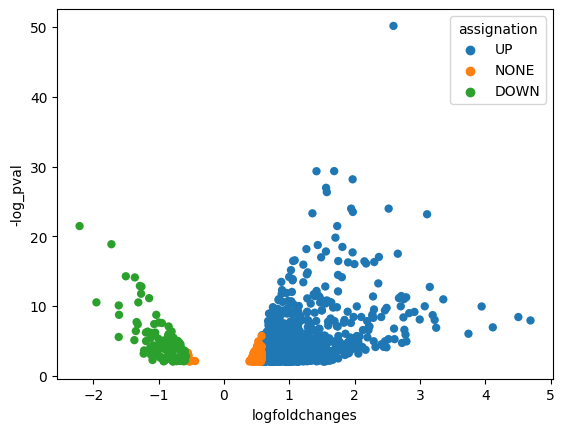

In [368]:
ax = sns.scatterplot(df_stat, x = "logfoldchanges", y = '-log_pval', linewidth = 0, hue = "assignation")

## Up-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [369]:
up_Tumor_vs_Others_mature = list(df_up["names"].values)

In [370]:
df_enrich = sc.queries.enrich(up_Tumor_vs_Others_mature,org = "mmusculus")

In [371]:
np.unique(df_enrich["source"])

df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])
df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

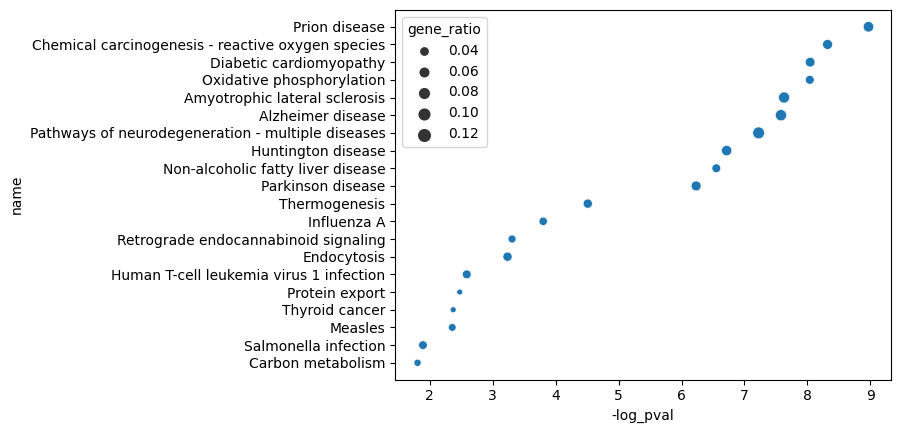

In [372]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

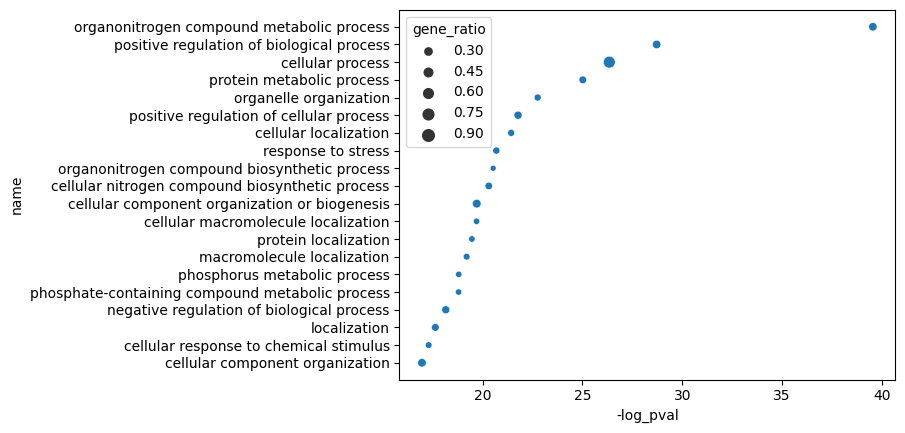

In [373]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

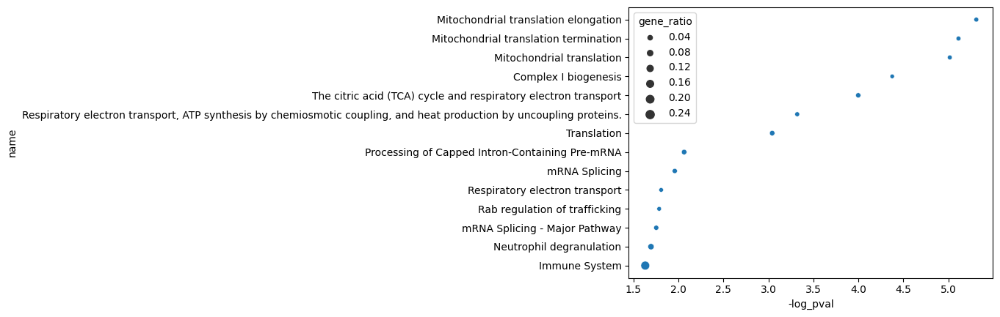

In [374]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

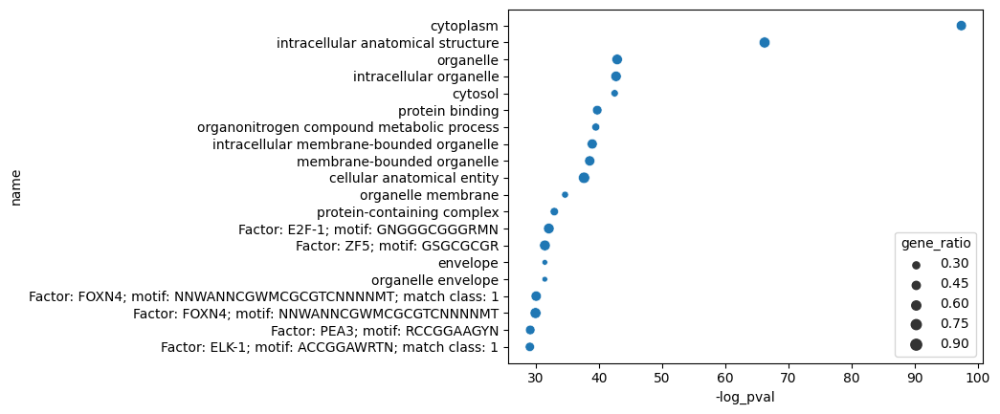

In [375]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### Precision
[//]: # (-.- .tabset .tabset-pills)

In [376]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: xlabel='precision', ylabel='name'>

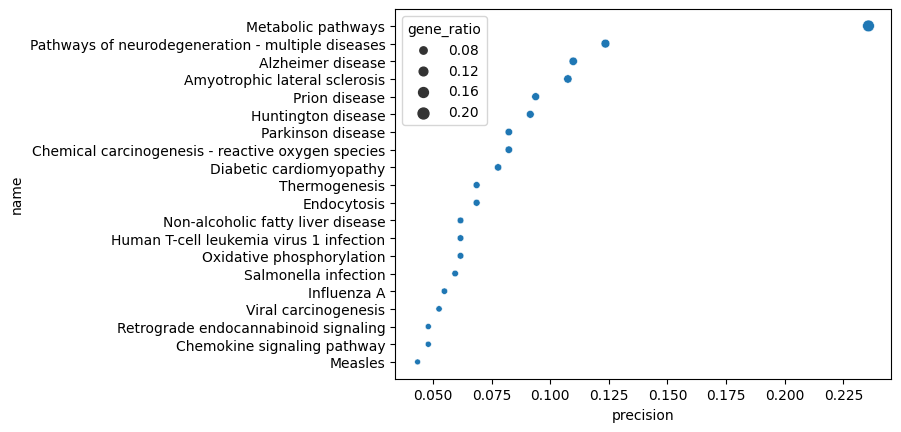

In [377]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

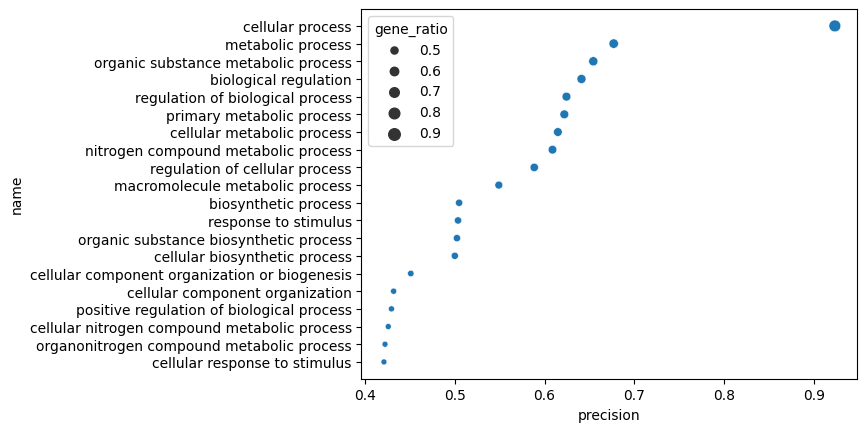

In [378]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: xlabel='precision', ylabel='name'>

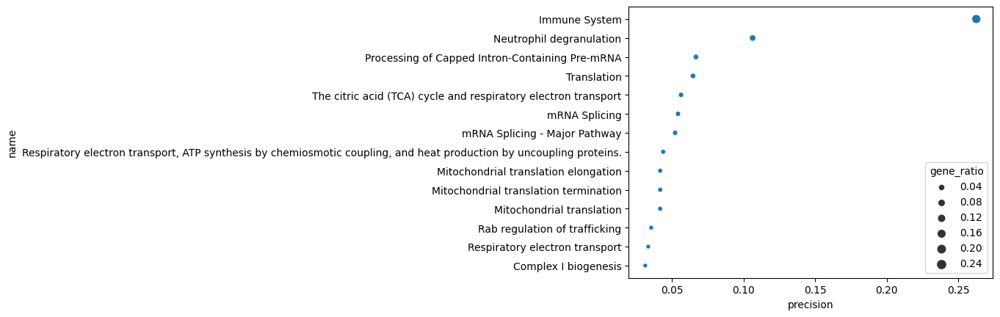

In [379]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

## Down-regulated pathways
[//]: # (-.- .tabset .tabset-pills)

In [380]:
down_Tumor_vs_Others_mature = list(df_down["names"].values)

In [381]:
df_enrich = sc.queries.enrich(down_Tumor_vs_Others_mature,org = "mmusculus")

In [382]:
np.unique(df_enrich["source"])

df_enrich["gene_ratio"] = [df_enrich.loc[i, "intersection_size"] / df_enrich.loc[i, "query_size"] for i in df_enrich.index]
df_enrich["-log_pval"] = -1*np.log10(df_enrich["p_value"])

### pval_adj
[//]: # (-.- .tabset .tabset-pills)

#### KEGG

<AxesSubplot: >

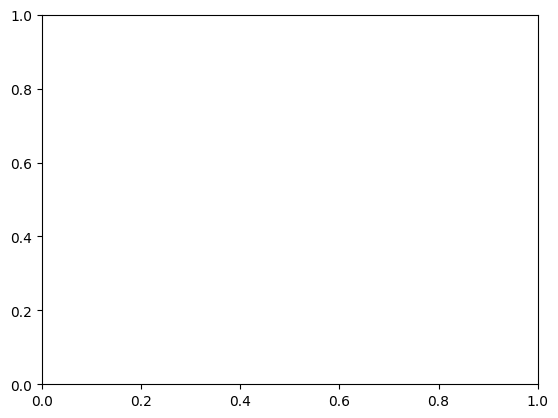

In [383]:
temp = df_enrich[df_enrich["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

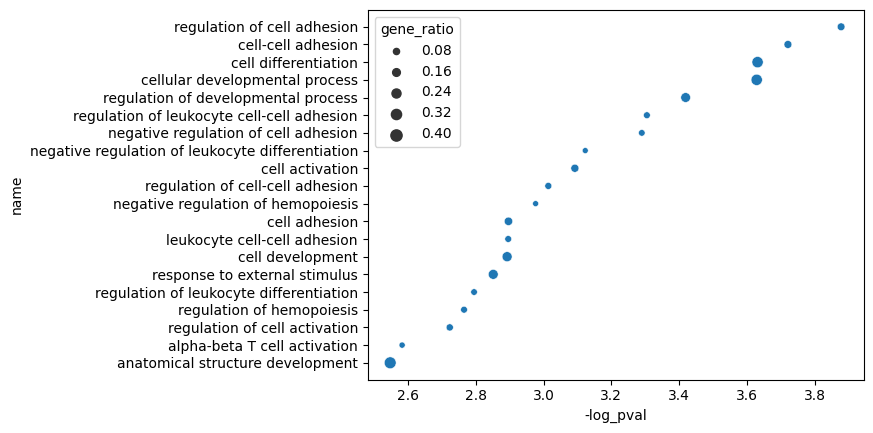

In [384]:
temp = df_enrich[df_enrich["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

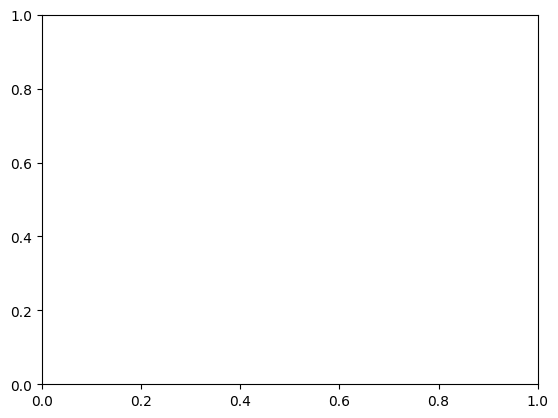

In [385]:
temp = df_enrich[df_enrich["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

#### All databases

<AxesSubplot: xlabel='-log_pval', ylabel='name'>

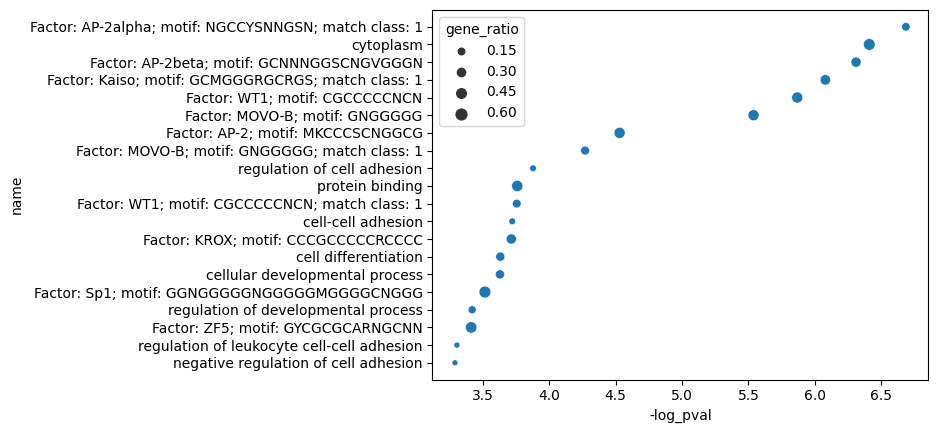

In [386]:
sns.scatterplot(df_enrich[0:20], x = "-log_pval", y = "name", size = "gene_ratio")

### precision
[//]: # (-.- .tabset .tabset-pills)

In [387]:
test = df_enrich.sort_values("precision", ascending = False)

#### KEGG

<AxesSubplot: >

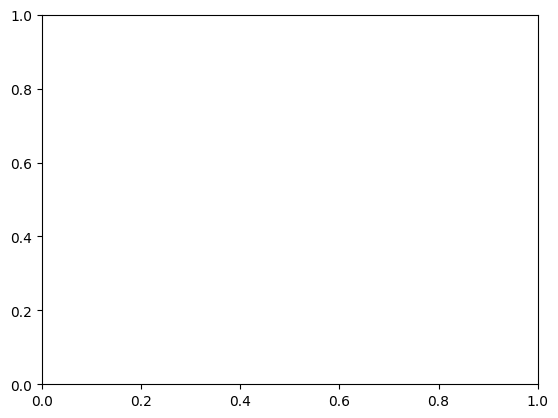

In [388]:
temp = test[test["source"] == "KEGG"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### GO:BP

<AxesSubplot: xlabel='precision', ylabel='name'>

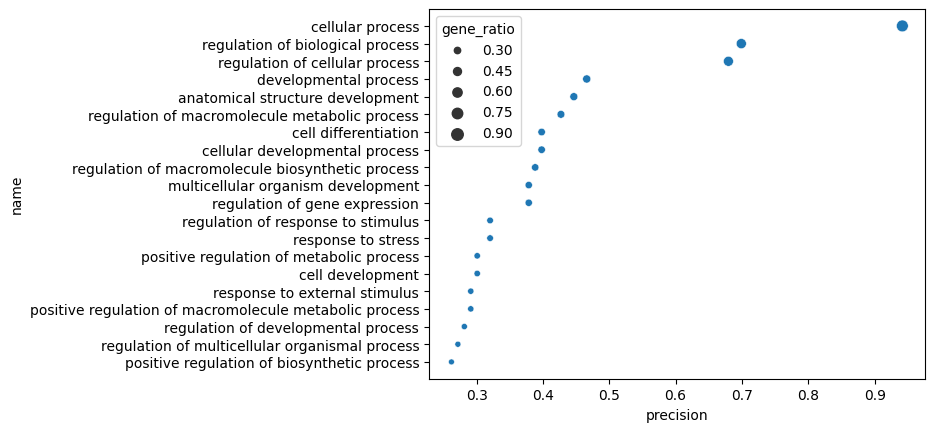

In [389]:
temp = test[test["source"] == "GO:BP"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")

#### REAC

<AxesSubplot: >

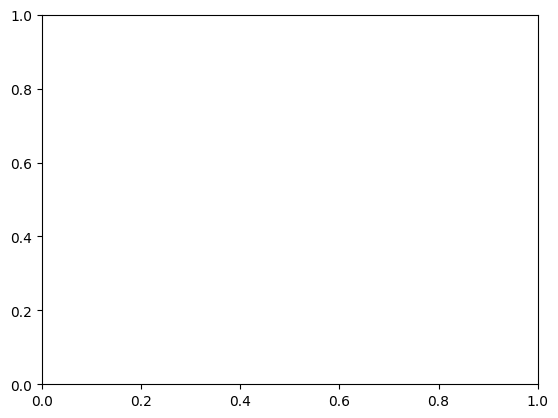

In [390]:
temp = test[test["source"] == "REAC"]

sns.scatterplot(temp[0:20], x = "precision", y = "name", size = "gene_ratio")